# How to use ML to time series 
###### Beyond the standards approach used in scikit-learn

## 1. Introduction
First, we import the necessary libraries and global variables.

In [1]:
# import the necessary libraries and global variables

import numpy as np

import pandas as pd

import statsmodels.api as sm

from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn import metrics

from fnmatch import fnmatch

import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# initialization of global variables
cmap_cv = plt.cm.coolwarm

The aim of the project is not only to use regression machine learning models to forecast time series, but also to extend and adapt the general procedures available in scikit-learn to the specific issue of time series forecasting.  

In order to go beyond the traditional statistical models such as AR, MA, ARMA, ARIMA and their variations in a task of time series forecasting, it is necessary to perform an appropriate data conversion, which turns the prediction task into a regression problem to which machine learning models can be successfully applied. 

Traditional, shallow regression machine learning models allow building prediction models of time series. For this purpose, a problem of time series prediction should be converted to a supervised learning problem by replacing a one-dimensional time series $x(t)$ with a multidimensional vector $Y(t)$:
\begin{equation}
    Y(t)=\big(x(t-p), x(t-p+1), \cdots, x(t-2), x(t-1)  \big),
\end{equation}
where the consecutive components $x(t-i)$ of the vector $Y(t)$ correspond to the original series $x(t)$ shifted by a appropriate time lag $i$. Thanks to such conversion, the forecasting task of a consecutive values for the time series $x(t)$ was reduced to the regression problem in which a dependent (output) variable is $x(t)$, and an explanatory (input) variables are the components of the vector $Y(t)$. 

The above approach was taken from Jason Brownlee's blog (https://machinelearningmastery.com/convert-time-series-supervised-learning-problem-python/). It gives great possibilities, but when applying ML methods to such converted data, a methodological problem arises while performing cross-validation (CV), because during consecutive CV-iterations fragments of data from different time periods are concatenate together, thus breaking a natural ordering of these data in accordance with time. In this notebook we consider and compare a different CV: maintaining and non-maintaing time order. We also create two new CV classes. In addition, we extend a built-in sci-kit learn (sklearn) procedure of finding the best hyperparameters based on an arithmetic mean of results obtained for CV-iterations to different variants of a weighted mean. Potentially, this approach should produce better results when a splits of data used in the CV are of different sizes or are statistically distinguishable, and also for time series describing phenomena disturbed by random factors.

Standard practice when working with time series is to transform them to a stationary form through appropriate procedures, e.g. differencing, however, it is worth bearing in mind that in this way some information contained in the series is lost. Therefore, it is worth considering not to differentiate the time series. In the case of statistical models, stationarity is required because methods of finding the best parameterization for these models work best with stationary time series, especially that AR, MA, ARMA, ARIMA models and extensions of these models generate stationary series. More importantly, the commonly used criteria such as BIC, AIC, HQIC (Bayesian-, Akaike-, Hannan-Quinn Information Criterion) provide appropriate measures for assessing the quality of the model when the series is stationary.  However, when using CV procedure, it may be considered to drop the stationarity because the CV is an objective prediction error test on a tested data set. In this notebook we will study stationary and non-stationary series as well as series subject to short-term disturbance. 

## 2. Methods and Materials

### 2.1. Cross validation for a time series forecasting task 

The purpose of time series forecasting is to best predict future data based on past data. Meanwhile, e.g. for the 3-fold typical CV presented below.

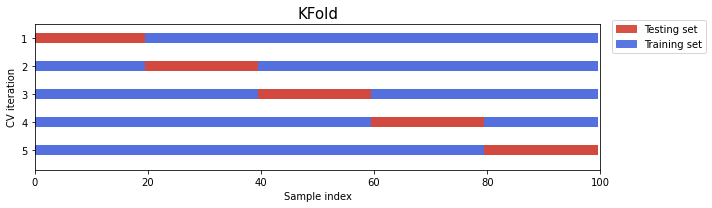

In [2]:
# loading the class that performs validation
from sklearn.model_selection import KFold

# function that draws a diagram showing a consecutive teaching and training subsets included in a CV


def plotCvDiagram(cv, ax, lw=10, n_data=100, cmap_cv=plt.cm.coolwarm):
    """
    Rysuje diagram przedstawiający kolejne foldy składające się na walidacje krzyżową.
    Arguments:
        cv: cross-validation object
            Cross-validator (sklearn).
        ax: Axes object (matplotlib).
        lw: float, int
            Wysokość paska reprezenfującego fold.
        n_data: int
            Wilkość próbki.
        cmap_cv: colormap object (matplotlib)
    Returns:
        Axes object.
    """

    # Generate a training/testing visualizations for each CV split
    for i, (tr, tt) in enumerate(cv.split(X=range(n_data), groups=None)):
        # Fill in indices with the training/test groups
        indices = np.array([0.5] * n_data)
        indices[tt] = 1
        indices[tr] = 0

        # Visualize results
        ax.scatter(range(n_data), [i + .5] * n_data,
                   c=indices, marker='_', lw=lw, cmap=cmap_cv,
                   vmin=-.1, vmax=1.1)

    # Formatting
    n_splits = cv.n_splits
    yticklabels = list(range(1, n_splits + 1))
    ax.set(yticks=np.arange(n_splits) + .5, yticklabels=yticklabels,
           xlabel='Sample index', ylabel="CV iteration",
           ylim=[n_splits+0.2, 0.], xlim=[0, n_data])
    ax.set_title('{}'.format(type(cv).__name__), fontsize=15)
    return ax


cv = KFold(5)

fig, ax = plt.subplots(figsize=(10, int(np.ceil(cv.n_splits/2))))
plotCvDiagram(cv, ax, lw=10, n_data=100)
ax.legend([Patch(color=cmap_cv(0.9)), Patch(color=cmap_cv(.1))],
          ['Testing set', 'Training set'], loc=(1.02, .8))
plt.tight_layout()

We observe a correct ordering according with time only for the 5th iteration (5th fold) ,i.e. past data (blue training set) is followed by future data (red test set). On the contrary, for the 1st iteration, the model is trained on future data (blue) and used to predict past data (red). The result obtained from such split (fold) inconsistent with the time passage direction is used to find the optimal set of hyperparameters for the model whose task is forecasting time series with natural direction of time passage. It might be treated as a methodological error. Of course, if the considered data set is stationary, then all subsets and relations between them are statistically indistinguishable, so standard KFold validation will give the best results. However, such situation rarely occurs for real data sets.

A trivial solution to this issue may be the use of a simple, primitive validation that performs the calculation on only one-fold validation maintaining time passage direction. The implementation of such validation is below.

/tmp/ipykernel_16698/3956031494.py:22: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()


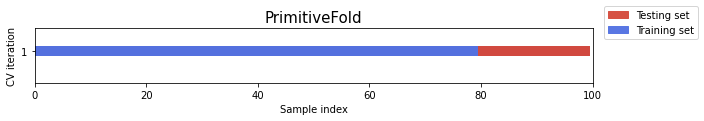

In [3]:
# class implementing a primitive one-fold validation
class PrimitiveFold():

    def __init__(self, ratioTrainTest=9):
        self.n_splits = 1
        self.ratioTrainTest = ratioTrainTest

    def get_n_splits(self, X, y, groups):
        return self.n_splits

    def split(self, X, y=None, groups=None):
        n_sample = len(X)
        indices = np.arange(n_sample)
        for i in range(self.n_splits):
            yield indices[:-n_sample // (self.ratioTrainTest)], indices[-n_sample // (self.ratioTrainTest):]


cv = PrimitiveFold(5)

fig, ax = plt.subplots(figsize=(10, int(np.ceil(cv.n_splits/2))))
plotCvDiagram(cv, ax, lw=10, n_data=100)
ax.legend([Patch(color=cmap_cv(0.9)), Patch(color=cmap_cv(.1))],
          ['Testing set', 'Training set'], loc=(1.02, .8))
plt.tight_layout()

Such an approach was used in the aforementioned blog : https://machinelearningmastery.com/grid-search-arima-hyperparameters-with-python/.

A better solution may be to use the CV with a gradually expanding folds, this type of validation is called Forward Chaining CV or Expanding Window CV. It is implemented in sklearn, as shown below:

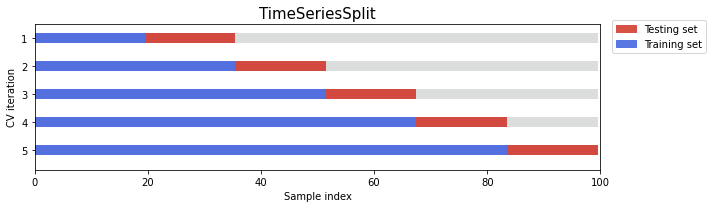

In [4]:
from sklearn.model_selection import TimeSeriesSplit

cv = TimeSeriesSplit(5)

fig, ax = plt.subplots(figsize=(10, int(np.ceil(cv.n_splits/2))))
plotCvDiagram(cv, ax, lw=10, n_data=100)
ax.legend([Patch(color=cmap_cv(0.9)), Patch(color=cmap_cv(.1))],
          ['Testing set', 'Training set'], loc=(1.02, .8))
plt.tight_layout()

The last type of CV under study is Rolling-Window (or Sliding-Window) CV.

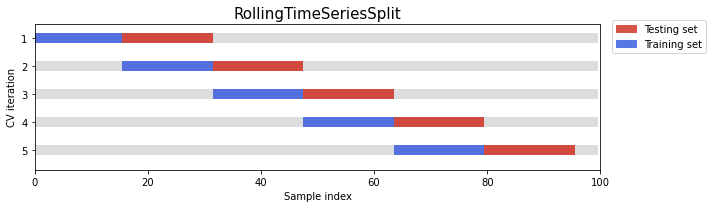

In [5]:
# class implementing Rolling-Window (or Sliding-Window) CV
class RollingTimeSeriesSplit():

    def __init__(self, n_splits):
        self.n_splits = n_splits

    def get_n_splits(self, X, y, groups):
        return self.n_splits

    def split(self, X, y=None, groups=None):
        n_sample = len(X)
        k_fold_half_size = n_sample // (self.n_splits + 1)
        indices = np.arange(n_sample)

        for i in range(self.n_splits):
            start = i * k_fold_half_size
            mid = start + k_fold_half_size
            end = mid + k_fold_half_size
            yield indices[start:mid], indices[mid:end]


cv = RollingTimeSeriesSplit(5)

fig, ax = plt.subplots(figsize=(10, int(np.ceil(cv.n_splits/2))))
plotCvDiagram(cv, ax, lw=10, n_data=100)
ax.legend([Patch(color=cmap_cv(0.9)), Patch(color=cmap_cv(.1))],
          ['Testing set', 'Training set'], loc=(1.02, .8))
plt.tight_layout()

### 2.2. Extended optimization of hyperparameters 

In the project has been compared and tested what results can be obtained from the application of the presented above types of validation (`KFold`, `TimeSeriesSplit`, `PrimitiveFold`, `RollingTimeSeriesSplit`) for the following shallow and/or traditional machine learning methods implemented in the Sci-kit Learn library: `ElasticNet`, `Lasso`, `Ridge`, `SVR`. The optimal hyperparameterization was found based on natural for time series metrics: Mean Square Error (MSE) and Root Mean Square Error (RMSE).

By default, sklearn library finds an optimal set of hyperparameters according to the following procedure. First, it performs a CV for each set of hyperparameters within the range under consideration to assess what a prediction error was obtained. It uses one or more selected metrics to assess the prediction error for each CV-iteration (hereinafter called the $i$-th fold). Thus, for each set of hyperparameters a list of prediction quality scores is obtained. Each $i$-th element of this list is equal to a value of the prediction error metric obtained for $i$-th fold. Then calculates an arithmetic mean over each list. Finally, as the best set of hyperparameters, it chooses the one for which the mean reaches the extreme that determines the smallest prediction error, in the case of MSE and RMSE measures, the extreme will be the minimum.   

The above built-in sklearn library solution are ideal for stationary time series and standard KFold-type CV, where subsets occurring in subsequent CV-iterations are statistically indistinguishable and of equal length. In the case of different length subsets as in TimeSeriesSplit-type CV, non-stationary time series, or series disturbed by various phenomena treating all folds as equivalent seems to be an unreasonable solution and using a weighted mean instead of the arithmetic to select an optimal set of hyperparameters may give better results.

We will study and compare five types of means used to optimize the hyperparameters:
* arithmetic mean of $MSE_i$, where $MSE_i$ are values of Mean Squared Error measure for $i$-folds.
* arithmetic mean of $RMSE_i$, where $RMSE_i$ are values of Root Mean Squared Error measure for $i$-folds.
* weighted mean of $MSE_i$, with weights $w_i=MSE_i^{-1}$:

$$
\frac{\sum_{i=1}^n w_i \cdot MSE_i}{\sum_{i=1}^n w_i} = \frac{\sum_{i=1}^n MSE_i^{-1} \cdot MSE_i}{\sum_{i=1}^n MSE_i^{-1}} = \frac{n}{\sum_{i=1}^n MSE_i^{-1}},
$$

* weighted mean of $RMSE_i$, with weights $w_i=RMSE_i^{-1}$:

$$
\frac{\sum_{i=1}^n w_i \cdot RMSE_i}{\sum_{i=1}^n w_i} = \frac{\sum_{i=1}^n RMSE_i^{-1} \cdot RMSE_i}{\sum_{i=1}^n RMSE_i^{-1}} = \frac{n}{\sum_{i=1}^n RMSE_i^{-1}},
$$

* weighted mean of $RMSE_i$, with weights $w_i=MSE_i^{-1}$:

$$
\frac{\sum_{i=1}^n w_i \cdot RMSE_i}{\sum_{i=1}^n w_i} = \frac{\sum_{i=1}^n MSE_i^{-1} \cdot RMSE_i}{\sum_{i=1}^n MSE_i^{-1}}.
$$

It is worth noting that the third and fourth mean from the above items are harmonic mean of MSE and RMSE metrics, respectively. The presented weighted means assign a high weights to folds for which the prediction error is small, so they should better deal with outliers or disturbances appearing on short data subsets.   

We will use the following functions to calculate harmonic mean and weighted mean.

In [226]:
def harmonicMean(array, axis=None):
    '''
    Compute a harmonic mean along a specified axis.
    Arguments:
        array: array_like
        axis: None, 0 or 1
            Axis along which the mean is computed.
    Returns:
        ndarray
    '''

    return len(array)/np.reciprocal(array).sum() if axis == None else array.shape[axis]/np.reciprocal(array).sum(axis=axis)


def weightedArithmeticMean(array, weights='optimal', variances=None, axis=None):
    '''
    Compute a weighted arithmetic mean along a specified axis.
    Arguments:
        array: array_like
        weights: 'optimal' or array_like
            If weights=='optimal' then weights are taken as reciprocals of `variances` otherwise subsequent weights must be listed as array_like   
        variances: array_like
        axis: None, 0 or 1
            Axis along which the mean is computed.
    Returns:
        ndarray
    '''

    if weights == 'optimal':
        weights = np.reciprocal(variances)
    return (array*weights).sum(axis=axis)/weights.sum(axis=axis)

## 3. Model time series - preparation and construction 

In this jupyter-notebook we will study 7 models of time series. The first two are real data sets, the next ones are constructed on the basis of the first two by adding different disturbances to them to study how the above-presented approaches (different types of CV and hyperparameter optimization) will work in practice.

In this section, time series will be presented and pre-processed. 

### 3.1. Model 1 - stationary time series (undisturbed)

This dataset describes the minimum daily temperatures over 10 years (1981-1990) in the city Melbourne, Australia.

The units are in degrees Celsius and there are 3650 observations. The source of the data is credited as the Australian Bureau of Meteorology.

The data comes from Jason Brownlee's website: https://machinelearningmastery.com/time-series-datasets-for-machine-learning/

Below is a sample of the first 5 rows of data including the header row.

In [7]:
# loading data
series_row = pd.read_csv('daily-minimum-temperatures.csv',
                         index_col=0, squeeze=True, parse_dates=['Date'])
series_row.head()

Date
1981-01-01    20.7
1981-01-02    17.9
1981-01-03    18.8
1981-01-04    14.6
1981-01-05    15.8
Name: Daily minimum temperatures in Melbourne, Australia, 1981-1990, dtype: float64

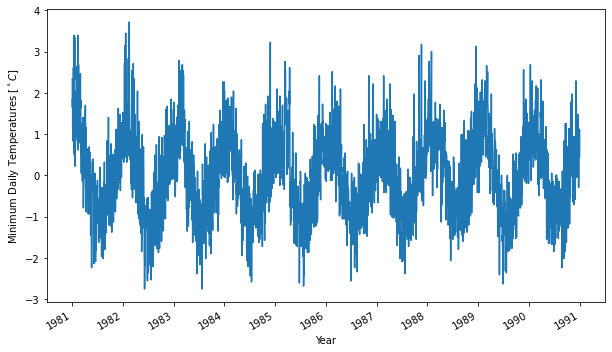

In [229]:
# data visualization
plt.figure(figsize=(10, 6))
series_row.plot()
plt.ylabel('Minimum Daily Temperatures [$^\circ C$]')
plt.xlabel('Year')
plt.show()

In [9]:
# convert to  numpy-type
series = series_row.values

In [10]:
# searching for the optimal model order (max lag) using Bayesian Information Criterion (BIC)
resultsAR = []
for order in range(1, 21):
    model = sm.tsa.ARMA(series, (order, 0))
    resultsAR.append(model.fit())
bic_criteria = [result.bic for result in resultsAR]

/home/marsob/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.36426D+00    |proj g|=  4.78018D-04

At iterate    5    f=  2.36426D+00    |proj g|=  4.92939D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      8     12      1     0     0   0.000D+00   2.364D+00
  F =   2.3642615957884061     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           12

At X0         0 v

 This problem is unconstrained.



At iterate   10    f=  2.33085D+00    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     15      1     0     0   4.441D-08   2.331D+00
  F =   2.3308487478927127     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.32218D+00    |proj g|=  3.76765D-04

At iterate    5    f=  2.32218D+00    |proj g|=  1.29452D-04


 This problem is unconstrained.



At iterate   10    f=  2.32217D+00    |proj g|=  3.55227D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     16      1     0     0   0.000D+00   2.322D+00
  F =   2.3221734186012561     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.31637D+00    |proj g|=  3.67084D-04


 This problem is unconstrained.



At iterate    5    f=  2.31637D+00    |proj g|=  1.28297D-04

At iterate   10    f=  2.31637D+00    |proj g|=  4.51017D-04

At iterate   15    f=  2.31637D+00    |proj g|=  1.33227D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     18      1     0     0   1.332D-07   2.316D+00
  F =   2.3163668695379505     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.31100D+00    |proj g|=  3.64153D-04

At iterate    5    f=  2.31099D+00    |proj g|=  1.26166D-04

At iterate   10    f=  2.31099D+00    |proj g|=  2.62057D-04

At iterate   15    f=  2.31099D+00    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     15     18      1     0     0   4.441D-08   2.311D+00
  F =   2.3109856603520815     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.30810D+00    |proj g|=  3.88622D-04

At iterate    5    f=  2.30810D+00    |proj g|=  1.35314D-04

At iterate   10    f=  2.30809D+00    |proj g|=  8.09575D-05

At iterate   15    f=  2.30809D+00    |proj g|=  1.33227D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     15     20      1     0     0   1.332D-07   2.308D+00
  F =   2.3080886341286355     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.30558D+00    |proj g|=  5.39213D-04

At iterate    5    f=  2.30557D+00    |proj g|=  1.53033D-04

At iterate   10    f=  2.30556D+00    |proj g|=  1.90381D-04

At iterate   15    f=  2.30556D+00    |proj g|=  1.33227D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     16     23      1     0     0   8.882D-08   2.306D+00
  F =   2.3055638871569792     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.30487D+00    |proj g|=  5.76605D-04

At iterate    5    f=  2.30485D+00    |proj g|=  1.55387D-04

At iterate   10    f=  2.30484D+00    |proj g|=  2.78266D-04

At iterate   15    f=  2.30484D+00    |proj g|=  1.33227D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     17     23      1     0     0   0.000D+00   2.305D+00
  F =   2.3048419141859471     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           12     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.30372D+00    |proj g|=  5.00266D-04

At iterate    5    f=  2.30371D+00    |proj g|=  1.63425D-04

At iterate   10    f=  2.30370D+00    |proj g|=  7.24709D-04

At iterate   15    f=  2.30370D+00    |proj g|=  3.55271D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   12     18     22      1     0     0   4.441D-08   2.304D+00
  F =   2.3036955244248398     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           13     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.30204D+00    |proj g|=  5.31131D-04

At iterate    5    f=  2.30203D+00    |proj g|=  1.57030D-04

At iterate   10    f=  2.30202D+00    |proj g|=  4.07274D-04

At iterate   15    f=  2.30202D+00    |proj g|=  4.44089D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   13     19     25      1     0     0   2.220D-07   2.302D+00
  F =   2.3020201294803875     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           14     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.30067D+00    |proj g|=  5.24647D-04

At iterate    5    f=  2.30066D+00    |proj g|=  3.21787D-04

At iterate   10    f=  2.30065D+00    |proj g|=  7.82041D-04

At iterate   15    f=  2.30065D+00    |proj g|=  4.44089D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   14     18     22      1     0     0   4.441D-08   2.301D+00
  F =   2.3006479747349191     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           15     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.29998D+00    |proj g|=  9.09051D-04

At iterate    5    f=  2.29996D+00    |proj g|=  3.48477D-04

At iterate   10    f=  2.29995D+00    |proj g|=  6.15019D-04

At iterate   15    f=  2.29995D+00    |proj g|=  6.83897D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   15     19     24      1     0     0   8.882D-08   2.300D+00
  F =   2.2999460908704794     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate    5    f=  2.29871D+00    |proj g|=  6.55920D-04

At iterate   10    f=  2.29870D+00    |proj g|=  6.73284D-04

At iterate   15    f=  2.29869D+00    |proj g|=  4.62297D-05

At iterate   20    f=  2.29869D+00    |proj g|=  3.10862D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   16     22     25      1     0     0   4.441D-08   2.299D+00
  F =   2.2986864885854441     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           17     M =           12

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    5    f=  2.29812D+00    |proj g|=  5.93658D-04

At iterate   10    f=  2.29812D+00    |proj g|=  5.69900D-04

At iterate   15    f=  2.29810D+00    |proj g|=  1.16307D-04

At iterate   20    f=  2.29810D+00    |proj g|=  1.77636D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   17     23     27      1     0     0   4.441D-08   2.298D+00
  F =   2.2980967107310950     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           18     M =           12

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    5    f=  2.29725D+00    |proj g|=  3.78719D-04

At iterate   10    f=  2.29724D+00    |proj g|=  8.39151D-04

At iterate   15    f=  2.29722D+00    |proj g|=  2.51799D-05

At iterate   20    f=  2.29722D+00    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   18     21     27      1     0     0   4.441D-08   2.297D+00
  F =   2.2972213914116599     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           19     M =           12

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    5    f=  2.29629D+00    |proj g|=  1.86695D-04

At iterate   10    f=  2.29628D+00    |proj g|=  7.11209D-04

At iterate   15    f=  2.29626D+00    |proj g|=  2.34479D-05

At iterate   20    f=  2.29626D+00    |proj g|=  1.59872D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   19     24     30      1     0     0   4.441D-08   2.296D+00
  F =   2.2962582159369140     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           20     M =           12

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    5    f=  2.29618D+00    |proj g|=  8.39462D-04

At iterate   10    f=  2.29617D+00    |proj g|=  6.33849D-04

At iterate   15    f=  2.29614D+00    |proj g|=  2.45493D-04

At iterate   20    f=  2.29614D+00    |proj g|=  1.73195D-06

At iterate   25    f=  2.29614D+00    |proj g|=  8.88178D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   20     25     30      1     0     0   8.882D-08   2.296D+00
  F =   2.2961443040831586     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           21     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.29525D+00    |proj g|=  8.94484D-04

At iterate    5    f=  2.29520D+00    |proj g|=  5.48050D-04

At iterate   10    f=  2.29520D+00    |proj g|=  3.68949D-04

At iterate   15    f=  2.29517D+00    |proj g|=  3.50076D-04

At iterate   20    f=  2.29517D+00    |proj g|=  1.77636D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   21     22     25      1     0     0   4.441D-08   2.295D+00
  F =   2.2951675194298171     

CONVERG

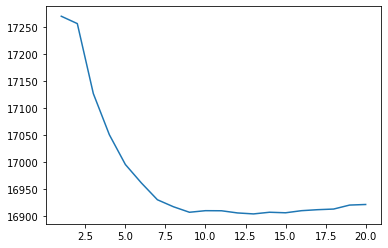

In [11]:
plt.plot(range(1, len(bic_criteria)+1), bic_criteria)

In [12]:
# By default, the model order is selected for the lag which minimize BIC
orderOfModel = np.argmin(bic_criteria)+1
orderOfModel

13

In [13]:
# However, we do otherwise as the nature of case studied is known, and natural period for `daily-minimum-temperatures`
# in monthly scale is equal 12, so instead od 13 for 'orderOfModel' we use 12
orderOfModel = 12

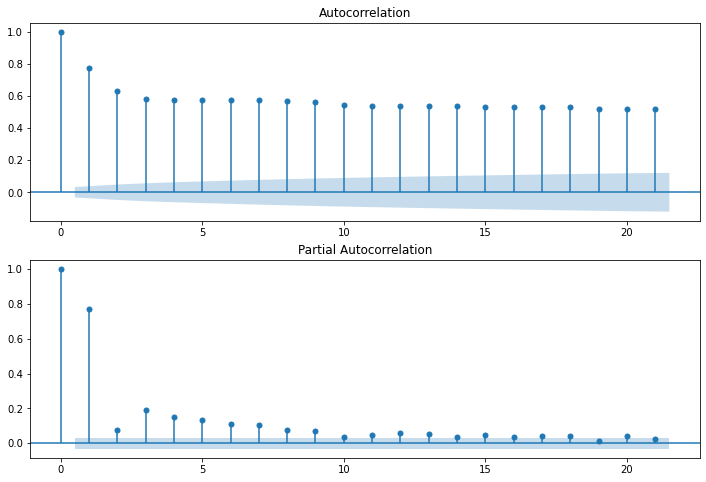

In [14]:
# Check autocorrelation and partial autocorrelation to make sure that max lag (model order) is reasonably chosen.
fig = plt.figure(figsize=(12, 8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(series, lags=21, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(series, lags=21, ax=ax2)
plt.show()

As can be seen above, based on the partial autocorrelation, the model order of 12 can be increased, but this will not significantly improve a forcasting quality.

In [15]:
# To compare the prediction results for different time series, the series is normalized
series -= series.mean()
series /= np.std(series)

In [16]:
# Perform Dickey–Fuller test to check stationarity.
# The null hypothesis: a unit root is present in an autoregressive time series model
# which means, that the time series is a non-stationary.
from statsmodels.tsa.stattools import adfuller
testDickeyFuller = adfuller(series, maxlag=orderOfModel, autolag=None)
dfOutput = pd.Series(testDickeyFuller[0:4], index=[
                     'Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
pValue = dfOutput[1]
print(f'pValue: {pValue}\n')
dfOutput

pValue: 4.849945709866838e-07



Test Statistic                -5.791921e+00
p-value                        4.849946e-07
#Lags Used                     1.200000e+01
Number of Observations Used    3.634000e+03
dtype: float64

The obtained p-value does not exclude the series stationarity, so it can be assumed that the series is stationary. 

### 3.2. Model 2 - non-stationary time series (undisturbed)

Yearly (1700-2008, 309 observations) data on sunspots from the National Geophysical Data Center in Boulder (USA).

Data taken from https://www.statsmodels.org/0.8.0/datasets/generated/sunspots.html

Up to 1944, yearly means were calculated as the average of the 12 monthly means; since 1945 yearly means have been calculated as the average of the daily means.

In [ ]:
series_raw_2 = pd.read_csv(
    './sunspots.csv', index_col='YEAR', squeeze=True, parse_dates=['YEAR'])
series_raw_2.head()

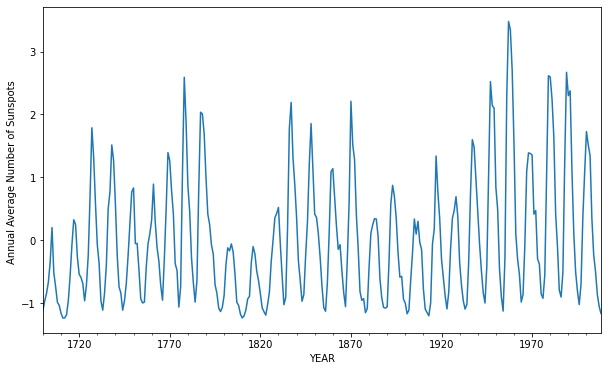

In [230]:
plt.figure(figsize=(10, 6))
plt.ylabel('Annual Average Number of Sunspots ')
plt.xlabel('Year')
series_raw_2.plot()
plt.show()

In [20]:
series_2 = series_raw_2.values

In [21]:
# searching for model order (max lag)
resultsAR_2 = []
for order in range(1, 16):
    model = sm.tsa.ARMA(series_2, (order, 0))
    resultsAR_2.append(model.fit())

bic_criteria_2 = [result.bic for result in resultsAR_2]

/home/marsob/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.55212D+00    |proj g|=  3.10774D-04

At iterate    5    f=  4.55212D+00    |proj g|=  5.35128D-04

At iterate   10    f=  4.55205D+00    |proj g|=  3.37419D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2     14     16      1     0     0   0.000D+00   4.552D+00
  F =   4.5520536447013376     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.22090D+00    |proj g|=  2.95595D-03

At iterate    5    f=  4.22087D+00    |proj g|=  1.65290D-04

At iterate   10    f=  4.22085D+00    |proj g|=  1.80762D-03

At iterate   15    f=  4.22084D+00    |proj g|=  2.57572D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     20      1     0     0   1.776D-07   4.221D+00
  F =   4.2208374094521597     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.18109D+00    |proj g|=  3.50262D-03

At iterate    5    f=  4.18096D+00    |proj g|=  6.65867D-04

At iterate   10    f=  4.18095D+00    |proj g|=  1.53726D-03

At iterate   15    f=  4.18079D+00    |proj g|=  3.00799D-03

At iterate   20    f=  4.18076D+00    |proj g|=  4.49418D-05

At iterate   25    f=  4.18076D+00    |proj g|=  7.99361D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     32      1     0     0   

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.15649D+00    |proj g|=  3.74740D-03

At iterate    5    f=  4.15629D+00    |proj g|=  7.02727D-04

At iterate   10    f=  4.15628D+00    |proj g|=  5.78027D-04

At iterate   15    f=  4.15608D+00    |proj g|=  4.49489D-03

At iterate   20    f=  4.15599D+00    |proj g|=  7.78044D-05

At iterate   25    f=  4.15599D+00    |proj g|=  2.66454D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     27     32      1     0     0   

 This problem is unconstrained.



At iterate   10    f=  4.12449D+00    |proj g|=  2.57927D-04

At iterate   15    f=  4.12444D+00    |proj g|=  2.48175D-03

At iterate   20    f=  4.12399D+00    |proj g|=  5.10170D-04

At iterate   25    f=  4.12398D+00    |proj g|=  2.02505D-05

At iterate   30    f=  4.12398D+00    |proj g|=  1.15463D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     34     39      1     0     0   3.553D-07   4.124D+00
  F =   4.1239848088884496     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           12

 This problem is unconstrained.



At iterate   10    f=  4.12451D+00    |proj g|=  2.62990D-04

At iterate   15    f=  4.12445D+00    |proj g|=  3.23519D-03

At iterate   20    f=  4.12399D+00    |proj g|=  1.47411D-03

At iterate   25    f=  4.12398D+00    |proj g|=  3.81917D-05

At iterate   30    f=  4.12398D+00    |proj g|=  2.66454D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     32     35      1     0     0   8.882D-08   4.124D+00
  F =   4.1239826662023242     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           12     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.12501D+00    |proj g|=  4.76064D-03

At iterate    5    f=  4.12460D+00    |proj g|=  3.73213D-03

At iterate   10    f=  4.12454D+00    |proj g|=  1.30456D-03

At iterate   15    f=  4.12453D+00    |proj g|=  9.31699D-04

At iterate   20    f=  4.12411D+00    |proj g|=  4.71703D-03

At iterate   25    f=  4.12396D+00    |proj g|=  5.48894D-05

At iterate   30    f=  4.12396D+00    |proj g|=  6.21725D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.



At iterate    5    f=  4.12464D+00    |proj g|=  2.57909D-03

At iterate   10    f=  4.12459D+00    |proj g|=  2.84128D-04

At iterate   15    f=  4.12457D+00    |proj g|=  4.44711D-03

At iterate   20    f=  4.12401D+00    |proj g|=  3.84484D-03

At iterate   25    f=  4.12396D+00    |proj g|=  8.29559D-05

At iterate   30    f=  4.12396D+00    |proj g|=  1.86517D-06

At iterate   35    f=  4.12396D+00    |proj g|=  3.55271D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   13     38     43      1     0     0   1.776D-07   4.124D+00
  F =   4.1239638561153873     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           14     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.12535D+00    |proj g|=  8.85647D-03

At iterate    5    f=  4.12471D+00    |proj g|=  4.32863D-03

At iterate   10    f=  4.12465D+00    |proj g|=  2.95230D-04

At iterate   15    f=  4.12460D+00    |proj g|=  3.89635D-03

At iterate   20    f=  4.12399D+00    |proj g|=  1.97184D-03

At iterate   25    f=  4.12396D+00    |proj g|=  2.42473D-05

At iterate   30    f=  4.12396D+00    |proj g|=  1.15463D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           15     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.12412D+00    |proj g|=  1.20591D-02

At iterate    5    f=  4.12333D+00    |proj g|=  1.27875D-02

At iterate   10    f=  4.12313D+00    |proj g|=  4.56080D-04

At iterate   15    f=  4.12312D+00    |proj g|=  1.15747D-03

At iterate   20    f=  4.12277D+00    |proj g|=  1.40392D-02

At iterate   25    f=  4.12231D+00    |proj g|=  1.65645D-04

At iterate   30    f=  4.12231D+00    |proj g|=  4.44089D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           16     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.12185D+00    |proj g|=  1.40201D-02

At iterate    5    f=  4.12084D+00    |proj g|=  9.19798D-03

At iterate   10    f=  4.12071D+00    |proj g|=  7.02283D-04

At iterate   15    f=  4.12070D+00    |proj g|=  1.20481D-03

At iterate   20    f=  4.12033D+00    |proj g|=  1.56565D-02

At iterate   25    f=  4.11991D+00    |proj g|=  3.01892D-04

At iterate   30    f=  4.11991D+00    |proj g|=  2.93099D-06

At iterate   35    f=  4.11991D+00    |proj g|=  3.55271D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

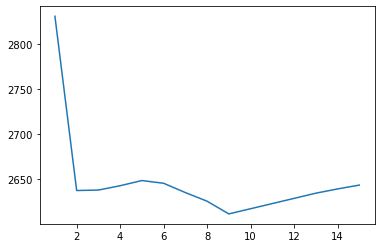

In [22]:
plt.plot(range(1, len(bic_criteria_2)+1), bic_criteria_2)

In [23]:
# based on the BIC criterion, the model order is found
orderOfModel_2 = np.argmin(bic_criteria_2)+1
orderOfModel_2

9

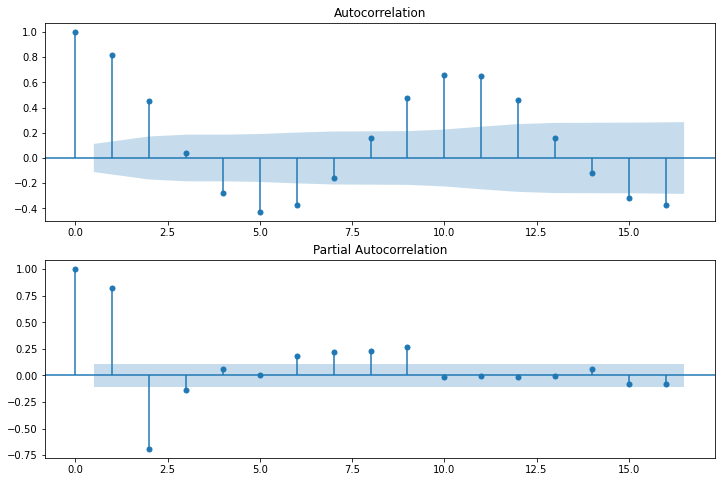

In [24]:
fig = plt.figure(figsize=(12, 8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(series_2, lags=16, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(series_2, lags=16, ax=ax2)
plt.show()

As seen above, based on the partial autocorrelation, the order of the model equal to 9 is very well selected.

In [26]:
# to compare the prediction results for different time series, the series is normalized
series_2 -= series_2.mean()
series_2 /= np.std(series_2)

In [27]:
testDickeyFuller = adfuller(
    series_2, maxlag=orderOfModel_2, autolag=None)  # 'BIC')
dfOutput = pd.Series(testDickeyFuller[0:4], index=[
                     'Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
pValue = dfOutput[1]
print(f'pValue: {pValue}\n')
dfOutput

pValue: 0.055972617285795154



Test Statistic                  -2.816374
p-value                          0.055973
#Lags Used                       9.000000
Number of Observations Used    299.000000
dtype: float64

Stationarity of time series is rejected as that p-value = 0.055973 

### 3.3. Model 3 - one stationary time series (model 1) disturbed by a modulated other series (model 2) 
It is used to check how the presented solutions work in the case of a periodically disturbed data. For this purpose, we disturb the time series from model 1 periodically with the time series from model 2

Below, we construct a disturbance based on the non-stationary series (model 2) and present the next steps of disturbance formation in the figure.

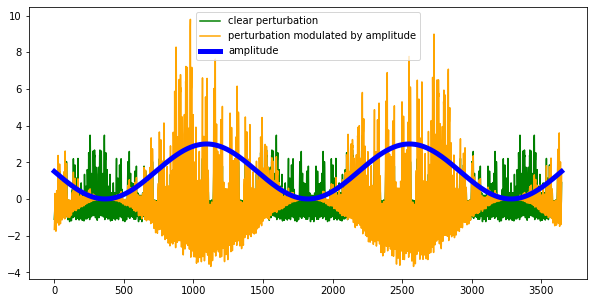

In [29]:
plt.figure(figsize=(10, 5))

# clear perturbution
perturbation_3 = np.fromiter(iter(d for i in range(
    12) for d in series_2[::-1 if i % 2 else 1]), float)[:len(series)]
plt.plot(perturbation_3, 'g', label='clear perturbation')

# amplitude
levelOfPerturbution = 1.5  # 2. #3.
periodNumberOfPerturbution = 2.5
amplitude = (1 - np.sin(periodNumberOfPerturbution*(2*np.pi) *
             np.linspace(0, 1, len(series))))*levelOfPerturbution

# perturbation modulated by periodic amplitude
perturbation_3 *= amplitude
plt.plot(perturbation_3, 'orange', label='perturbation modulated by amplitude')

plt.plot(amplitude, 'b', lw=5, label='amplitude')
plt.legend()

The figure below present the disturbed time series and the original undisturbed time series.

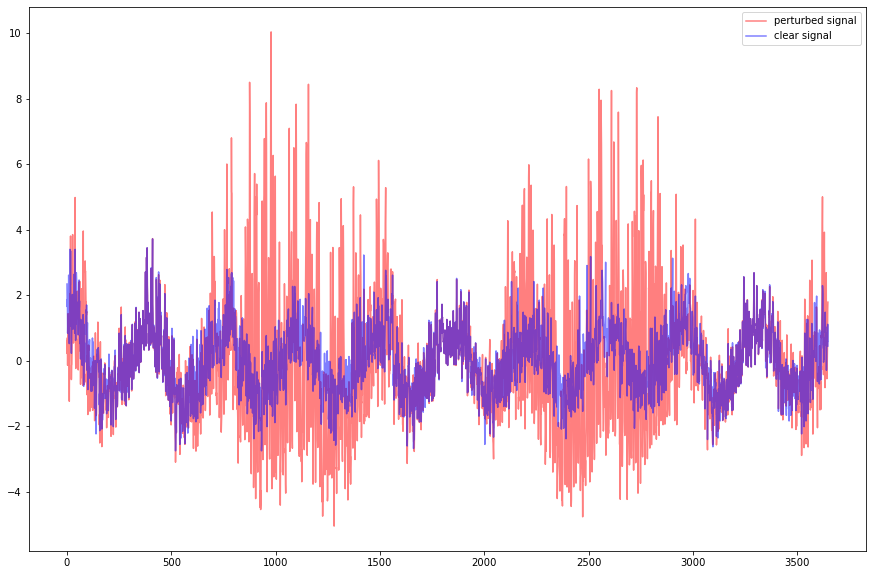

In [30]:
plt.figure(figsize=(15, 10))
series_3 = series + perturbation_3
plt.plot(series_3, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series, 'b', label='clear signal', alpha=0.5)
plt.legend()

In [31]:
resultsAR_3 = []
for order in range(1, 21):
    model = sm.tsa.ARMA(series_3, (order, 0))
    resultsAR_3.append(model.fit())

bic_criteria_3 = [result.bic for result in resultsAR_3]

/home/marsob/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53790D+00    |proj g|=  9.63674D-05

At iterate    5    f=  1.53790D+00    |proj g|=  0.00000D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      8      1     0     0   0.000D+00   1.538D+00
  F =   1.5378950544048045     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           12

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41545D+00    |proj g|=  2.44360D-04

At iterate    5    f=  1.41544D+00    |proj g|=  3.04201D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      7     10      1     0     0   2.220D-08   1.415D+00
  F =   1.4154447450305516     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40498D+00    |proj g|=  1.97509D-04

At iterate    5    f=  1.40498D+00    |proj g|=  3.28626D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7      8     10      1     0     0   2.220D-08   1.405D+00
  F =   1.4049784507915379     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38197D+00    |proj g|=  2.49045D-04

At iterate    5    f=  1.38197D+00    |proj g|=  2.14939D-05

At iterate   10    f=  1.38197D+00    |proj g|=  2.22045D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     11     13      1     0     0   2.220D-08   1.382D+00
  F =   1.3819656783857595     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate   10    f=  1.35782D+00    |proj g|=  2.28706D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     14     16      1     0     0   4.441D-08   1.358D+00
  F =   1.3578189987733642     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33478D+00    |proj g|=  2.88281D-04


 This problem is unconstrained.



At iterate    5    f=  1.33478D+00    |proj g|=  1.29341D-04

At iterate   10    f=  1.33478D+00    |proj g|=  2.03393D-05

At iterate   15    f=  1.33478D+00    |proj g|=  6.66134D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     16     18      1     0     0   2.220D-08   1.335D+00
  F =   1.3347808417554361     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33175D+00    |proj g|=  3.21498D-04


 This problem is unconstrained.



At iterate    5    f=  1.33175D+00    |proj g|=  1.52700D-04

At iterate   10    f=  1.33175D+00    |proj g|=  3.51941D-05

At iterate   15    f=  1.33175D+00    |proj g|=  4.44089D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     18     22      1     0     0   6.661D-08   1.332D+00
  F =   1.3317496382836564     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           12     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33114D+00    |proj g|=  3.42615D-04


 This problem is unconstrained.



At iterate    5    f=  1.33114D+00    |proj g|=  1.35847D-04

At iterate   10    f=  1.33114D+00    |proj g|=  4.19664D-05

At iterate   15    f=  1.33114D+00    |proj g|=  4.66294D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   12     19     24      1     0     0   2.220D-08   1.331D+00
  F =   1.3311398129773837     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           13     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33108D+00    |proj g|=  2.65410D-04


 This problem is unconstrained.



At iterate    5    f=  1.33108D+00    |proj g|=  4.82059D-05

At iterate   10    f=  1.33108D+00    |proj g|=  1.33227D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   13     14     20      1     0     0   8.882D-08   1.331D+00
  F =   1.3310820527936558     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           14     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33108D+00    |proj g|=  3.18523D-04


 This problem is unconstrained.



At iterate    5    f=  1.33108D+00    |proj g|=  5.99742D-05

At iterate   10    f=  1.33108D+00    |proj g|=  2.15383D-06

At iterate   15    f=  1.33108D+00    |proj g|=  1.33227D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   14     15     18      1     0     0   1.332D-07   1.331D+00
  F =   1.3310809324927990     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           15     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33083D+00    |proj g|=  4.20619D-04

At iterate    5    f=  1.33083D+00    |proj g|=  8.11795D-05

At iterate   10    f=  1.33083D+00    |proj g|=  1.03251D-05

At iterate   15    f=  1.33083D+00    |proj g|=  2.88658D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   15     18     24      1     0     0   4.441D-08   1.331D+00
  F =   1.3308311593716120     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           16     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33082D+00    |proj g|=  4.31921D-04

At iterate    5    f=  1.33082D+00    |proj g|=  1.07336D-04

At iterate   10    f=  1.33082D+00    |proj g|=  1.13909D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   16     14     17      1     0     0   4.441D-08   1.331D+00
  F =   1.3308164420597111     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate    5    f=  1.33056D+00    |proj g|=  7.79155D-05

At iterate   10    f=  1.33056D+00    |proj g|=  2.44249D-06

At iterate   15    f=  1.33056D+00    |proj g|=  9.32587D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   17     17     19      1     0     0   4.441D-08   1.331D+00
  F =   1.3305551188429627     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           18     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32714D+00    |proj g|=  3.35976D-04


 This problem is unconstrained.



At iterate    5    f=  1.32713D+00    |proj g|=  1.41842D-04

At iterate   10    f=  1.32713D+00    |proj g|=  8.72635D-06

At iterate   15    f=  1.32713D+00    |proj g|=  6.66134D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   18     16     20      1     0     0   2.220D-08   1.327D+00
  F =   1.3271339408069946     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           19     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32630D+00    |proj g|=  5.72142D-04


 This problem is unconstrained.



At iterate    5    f=  1.32629D+00    |proj g|=  2.35145D-04

At iterate   10    f=  1.32629D+00    |proj g|=  3.44835D-05

At iterate   15    f=  1.32629D+00    |proj g|=  7.54952D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   19     18     20      1     0     0   2.220D-08   1.326D+00
  F =   1.3262921317443641     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           20     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32622D+00    |proj g|=  6.29718D-04

At iterate    5    f=  1.32622D+00    |proj g|=  2.20890D-04

At iterate   10    f=  1.32622D+00    |proj g|=  4.33875D-05

At iterate   15    f=  1.32622D+00    |proj g|=  1.33227D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   20     19     21      1     0     0   2.220D-08   1.326D+00
  F =   1.3262182961893150     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate    5    f=  1.32528D+00    |proj g|=  2.53486D-04

At iterate   10    f=  1.32528D+00    |proj g|=  4.69624D-05

At iterate   15    f=  1.32528D+00    |proj g|=  1.31006D-06

At iterate   20    f=  1.32528D+00    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   21     21     25      1     0     0   6.661D-08   1.325D+00
  F =   1.3252773179593165     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


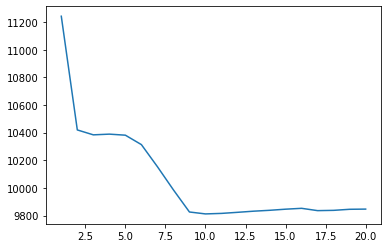

In [32]:
plt.plot(range(1, len(bic_criteria_3)+1), bic_criteria_3)

In [33]:
# based on the BIC criterion, the model order is found
orderOfModel_3 = np.argmin(bic_criteria_3)+1
orderOfModel_3

10

In [34]:
# As the nature of case studied is known: series_3 is perturbed `series` with natural period equal 12 (in monthly scale),
# so instead of 10 for 'orderOfModel_3' we take 12 as model order
orderOfModel_3 = 12

In [35]:
# to compare the prediction results for different time series, the series is normalized
series_3 -= series_3.mean()
series_3 /= np.std(series_3)

In [36]:
testDickeyFuller = adfuller(
    series_3, maxlag=orderOfModel_3, autolag=None)  # 'BIC')
dfOutput = pd.Series(testDickeyFuller[0:4], index=[
                     'Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
pValue = dfOutput[1]
print(f'pValue: {pValue}\n')
dfOutput

pValue: 5.608510280728829e-12



Test Statistic                -7.850790e+00
p-value                        5.608510e-12
#Lags Used                     1.200000e+01
Number of Observations Used    3.634000e+03
dtype: float64

Test DickeyFuller does not confirm stationarity of `series_3` even though it is a linear combination of stationary `series` and modulated non-stationary `series_2` 

### 3.4. Model 4 - stationary time series (model 1) disturbed by a periodically modulated random walk 
It is used to check how the presented solutions work in the case of a periodically disturbed data. For this purpose, we disturb the time series from model 1 by periodically modulated random walk.

Below, we construct a disturbance based on a random walk and present the next steps of disturbance formation in the figure.

Construction and visualization of disturbance 

<Figure size 720x360 with 0 Axes>

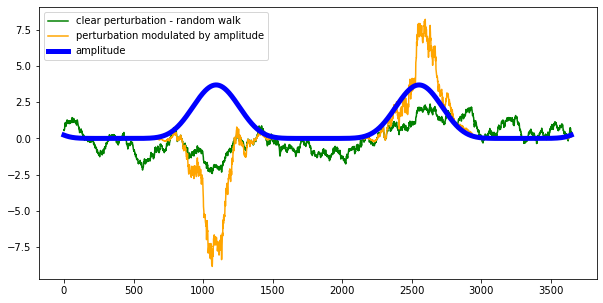

In [38]:
plt.figure(figsize=(10, 5))

# clear perturbution based on random walk
np.random.seed(13)
perturbation_4 = [0]
for j in range(len(series)-1):
    perturbation_4.append(perturbation_4[j] + np.random.normal())
perturbation_4 = np.array(perturbation_4)

perturbation_4 -= perturbation_4.mean()
perturbation_4 /= np.std(perturbation_4)


plt.figure(figsize=(10, 5))
plt.plot(perturbation_4, 'g', label='clear perturbation - random walk')

# amplitude
levelOfPerturbution = 3.7
periodNumberOfPerturbution = 2.5
amplitude = np.power(0.5*(1 - np.sin(periodNumberOfPerturbution *
                     (2*np.pi)*np.linspace(0, 1, len(series)))), 4)*levelOfPerturbution

# perturbation modulate by periodic amplitude
perturbation_4 *= amplitude
plt.plot(perturbation_4, 'orange', label='perturbation modulated by amplitude')

plt.plot(amplitude, 'b', lw=5, label='amplitude')
plt.legend()

The figure below present the disturbed time series and the original undisturbed time series.

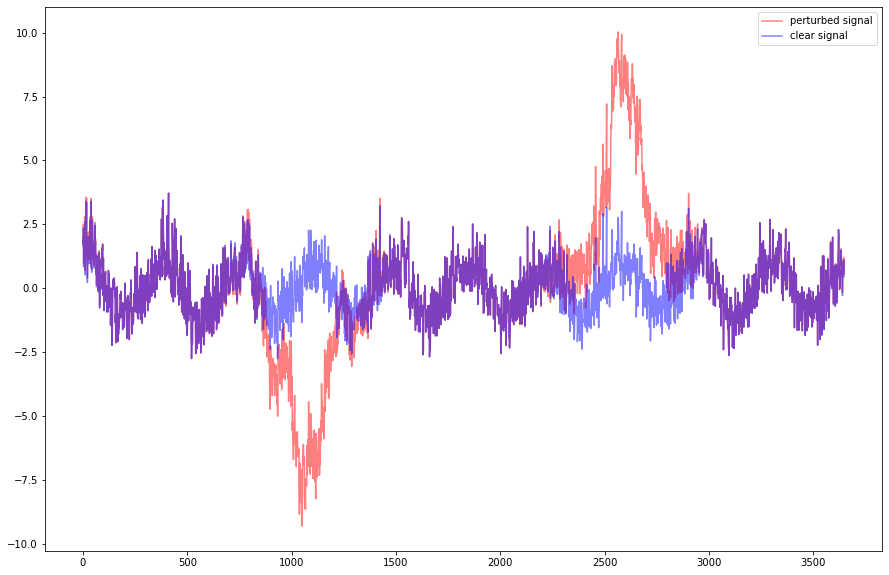

In [39]:
plt.figure(figsize=(15, 10))
series_4 = series+perturbation_4
plt.plot(series_4, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series, 'b', label='clear signal', alpha=0.5)
plt.legend()

/home/marsob/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.03136D+00    |proj g|=  1.08247D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      9      1     0     0   0.000D+00   1.031D+00
  F =   1.0313610548671990     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.0

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.87791D-01    |proj g|=  9.83325D-05

At iterate    5    f=  9.87788D-01    |proj g|=  8.57314D-05

At iterate   10    f=  9.87787D-01    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     14      1     0     0   4.441D-08   9.878D-01
  F =  0.98778748613511835     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate   10    f=  9.60944D-01    |proj g|=  9.42246D-05

At iterate   15    f=  9.60943D-01    |proj g|=  1.50369D-04

At iterate   20    f=  9.60943D-01    |proj g|=  3.33067D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     21     25      1     0     0   4.441D-08   9.609D-01
  F =  0.96094254430911985     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.54865D-01    |proj g|=  3.84015D-04

At iterate    5    f=  9.54863D-01    |proj g|=  2.91256D-04

At iterate   10    f=  9.54861D-01    |proj g|=  2.58848D-04

At iterate   15    f=  9.54860D-01    |proj g|=  1.08247D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     25      1     0     0   3.331D-08   9.549D-01
  F =  0.95485969422900030     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate    5    f=  9.49785D-01    |proj g|=  3.34144D-04

At iterate   10    f=  9.49783D-01    |proj g|=  7.22422D-05

At iterate   15    f=  9.49781D-01    |proj g|=  3.07432D-04

At iterate   20    f=  9.49780D-01    |proj g|=  7.77156D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     22     27      1     0     0   2.220D-08   9.498D-01
  F =  0.94978026216273914     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.46632D-01    |proj g|=  3.66740D-04

At iterate    5    f=  9.46630D-01    |proj g|=  5.03553D-04

At iterate   10    f=  9.46627D-01    |proj g|=  1.57896D-04

At iterate   15    f=  9.46624D-01    |proj g|=  2.97840D-04

At iterate   20    f=  9.46624D-01    |proj g|=  3.55271D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     23     30      1     0     0   1.110D-08   9.466D-01
  F =  0.94662386536876242     

CONVERG

 This problem is unconstrained.



At iterate   10    f=  9.44801D-01    |proj g|=  2.39408D-04

At iterate   15    f=  9.44800D-01    |proj g|=  4.99112D-04

At iterate   20    f=  9.44797D-01    |proj g|=  4.36318D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     24     29      1     0     0   2.220D-08   9.448D-01
  F =  0.94479743967039964     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.44170D-01    |proj g|=  3.90699D-04

At iterate    5    f=  9.44168D-01    |proj g|=  1.67744D-04

At iterate   10    f=  9.44162D-01    |proj g|=  1.93345D-04

At iterate   15    f=  9.44160D-01    |proj g|=  3.22198D-04

At iterate   20    f=  9.44157D-01    |proj g|=  5.08482D-06

At iterate   25    f=  9.44157D-01    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     27     34      1     0     0   

 This problem is unconstrained.



At iterate    5    f=  9.43308D-01    |proj g|=  4.09883D-04

At iterate   10    f=  9.43301D-01    |proj g|=  7.56062D-05

At iterate   15    f=  9.43298D-01    |proj g|=  3.63332D-04

At iterate   20    f=  9.43298D-01    |proj g|=  5.55112D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   12     24     30      1     0     0   3.331D-08   9.433D-01
  F =  0.94329762316704313     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           13     M =           12

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    5    f=  9.42146D-01    |proj g|=  2.71450D-04

At iterate   10    f=  9.42141D-01    |proj g|=  6.32938D-05

At iterate   15    f=  9.42137D-01    |proj g|=  3.80551D-04

At iterate   20    f=  9.42136D-01    |proj g|=  4.77396D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   13     23     27      1     0     0   2.109D-07   9.421D-01
  F =  0.94213598626017536     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           14     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.41537D-01    |proj g|=  4.10783D-04

At iterate    5    f=  9.41536D-01    |proj g|=  2.32103D-04

At iterate   10    f=  9.41529D-01    |proj g|=  1.55420D-04

At iterate   15    f=  9.41527D-01    |proj g|=  5.31986D-04

At iterate   20    f=  9.41523D-01    |proj g|=  1.35669D-05

At iterate   25    f=  9.41523D-01    |proj g|=  3.33067D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   14     25     34      1     0     0   

 This problem is unconstrained.



At iterate    5    f=  9.41376D-01    |proj g|=  1.81866D-04

At iterate   10    f=  9.41369D-01    |proj g|=  6.38767D-04

At iterate   15    f=  9.41366D-01    |proj g|=  4.90008D-04

At iterate   20    f=  9.41362D-01    |proj g|=  9.15601D-05

At iterate   25    f=  9.41362D-01    |proj g|=  2.22045D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   15     26     29      1     0     0   1.110D-08   9.414D-01
  F =  0.94136154688626972     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           16     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.40575D-01    |proj g|=  1.03726D-03

At iterate    5    f=  9.40569D-01    |proj g|=  1.40732D-04

At iterate   10    f=  9.40556D-01    |proj g|=  8.22997D-04

At iterate   15    f=  9.40552D-01    |proj g|=  1.32139D-04

At iterate   20    f=  9.40550D-01    |proj g|=  1.72851D-04

At iterate   25    f=  9.40550D-01    |proj g|=  3.21965D-07

At iterate   30    f=  9.40550D-01    |proj g|=  6.66134D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           17     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.40507D-01    |proj g|=  9.38560D-04

At iterate    5    f=  9.40500D-01    |proj g|=  3.15359D-04

At iterate   10    f=  9.40486D-01    |proj g|=  4.53537D-04

At iterate   15    f=  9.40484D-01    |proj g|=  2.94942D-04

At iterate   20    f=  9.40482D-01    |proj g|=  2.35367D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   17     23     30      1     0     0   5.551D-08   9.405D-01
  F =  0.94048249285043606     

CONVERG

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           18     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.40173D-01    |proj g|=  7.87737D-04

At iterate    5    f=  9.40167D-01    |proj g|=  2.56228D-04

At iterate   10    f=  9.40152D-01    |proj g|=  5.90328D-04

At iterate   15    f=  9.40149D-01    |proj g|=  2.34268D-04

At iterate   20    f=  9.40148D-01    |proj g|=  3.81917D-06

At iterate   25    f=  9.40148D-01    |proj g|=  2.33147D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   18     28     34      1     0     0   

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           19     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.39858D-01    |proj g|=  8.30003D-04

At iterate    5    f=  9.39853D-01    |proj g|=  1.56430D-04

At iterate   10    f=  9.39837D-01    |proj g|=  1.29420D-03

At iterate   15    f=  9.39829D-01    |proj g|=  2.40141D-05

At iterate   20    f=  9.39829D-01    |proj g|=  6.37268D-06

At iterate   25    f=  9.39829D-01    |proj g|=  5.55112D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   19     25     33      1     0     0   

 This problem is unconstrained.



At iterate    5    f=  9.39810D-01    |proj g|=  1.81744D-04

At iterate   10    f=  9.39796D-01    |proj g|=  1.17180D-03

At iterate   15    f=  9.39791D-01    |proj g|=  1.70841D-04

At iterate   20    f=  9.39789D-01    |proj g|=  3.14193D-05

At iterate   25    f=  9.39789D-01    |proj g|=  8.88178D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   20     28     36      1     0     0   5.551D-08   9.398D-01
  F =  0.93978912983661345     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           21     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.39535D-01    |proj g|=  8.91764D-04

At iterate    5    f=  9.39527D-01    |proj g|=  1.61304D-04

At iterate   10    f=  9.39516D-01    |proj g|=  1.16447D-03

At iterate   15    f=  9.39510D-01    |proj g|=  2.10554D-04

At iterate   20    f=  9.39507D-01    |proj g|=  8.24785D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   21     24     28      1     0     0   3.331D-08   9.395D-01
  F =  0.93950677360002965     

CONVERG

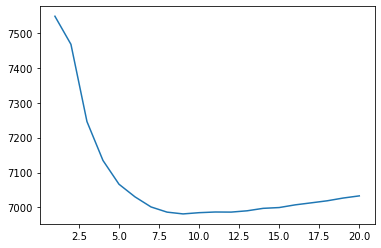

In [40]:
# searching for model order (max lag)
resultsAR_4 = []
for order in range(1, 21):
    model = sm.tsa.ARMA(series_4, (order, 0))
    resultsAR_4.append(model.fit())

bic_criteria_4 = [result.bic for result in resultsAR_4]

plt.plot(range(1, len(bic_criteria_4)+1), bic_criteria_4)

In [41]:
orderOfModel_4 = np.argmin(bic_criteria_4)+1
orderOfModel_4

9

In [42]:
# as the nature of case studied is known: series_4 is perturbed `series` with natural period equal 12 (in monthly scale),
# so instead of 9 for 'orderOfModel_4' we take 12 as model order
orderOfModel_4 = 12

In [43]:
# to compare the prediction results for different time series, the series is normalized
series_4 -= series_4.mean()
series_4 /= np.std(series_4)

In [44]:
testDickeyFuller = adfuller(
    series_4, maxlag=orderOfModel_4, autolag=None)  # 'BIC')
dfOutput = pd.Series(testDickeyFuller[0:4], index=[
                     'Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
pValue = dfOutput[1]
print(f'pValue: {pValue}\n')
dfOutput

pValue: 0.1477793822531437



Test Statistic                   -2.378904
p-value                           0.147779
#Lags Used                       12.000000
Number of Observations Used    3634.000000
dtype: float64

As one would expect the `series_4` as a linear combination of a stationary `series` and a (non-stationary) modulated random walk is non-stationary 

### 3.5. Model 5 - stationary time series (model 1) disturbed by Gaussian-shape enhancement.
Another disturbance model for a case study.

<Figure size 720x360 with 0 Axes>

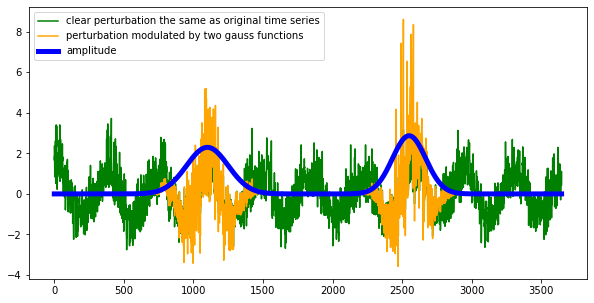

In [46]:
from scipy.stats import norm as gauss
plt.figure(figsize=(10, 5))

# clear perturbution based on original time series (Model 1)
perturbation_5 = series.copy()


# amplitude
levelOfPerturbution = 0.8  # z
amplitude = gauss(1100, 150).pdf(range(len(series))) + \
    gauss(2550, 120).pdf(range(len(series)))
amplitude /= np.std(amplitude)
amplitude *= levelOfPerturbution

plt.figure(figsize=(10, 5))
plt.plot(perturbation_5, 'g',
         label='clear perturbation the same as original time series')

perturbation_5 *= amplitude
plt.plot(perturbation_5, 'orange',
         label='perturbation modulated by two gauss functions ')
plt.plot(amplitude, 'b', lw=5, label='amplitude')
plt.legend()

The figure below present the disturbed time series and the original undisturbed time series.

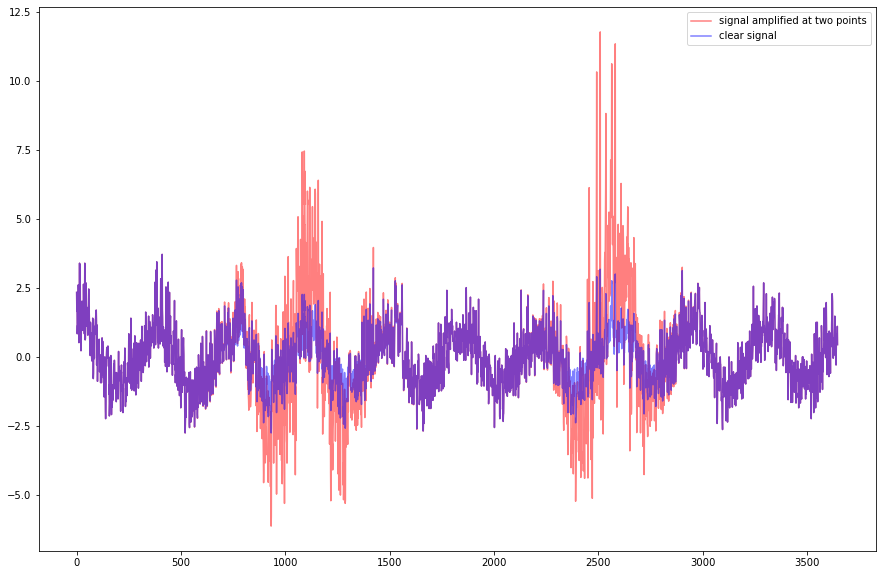

In [47]:
plt.figure(figsize=(15, 10))
series_5 = series+perturbation_5
plt.plot(series_5, 'r', label='signal amplified at two points', alpha=0.5)
plt.plot(series, 'b', label='clear signal', alpha=0.5)
plt.legend()

/home/marsob/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.45985D+00    |proj g|=  2.37432D-04

At iterate    5    f=  1.45985D+00    |proj g|=  2.22045D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      7      1     0     0   2.220D-08   1.460D+00
  F =   1.4598497933815240     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           12

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.42609D+00    |proj g|=  3.19078D-05

At iterate   10    f=  1.42609D+00    |proj g|=  2.22045D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     15      1     0     0   2.220D-08   1.426D+00
  F =   1.4260929246785810     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42099D+00    |proj g|=  2.24198D-04


 This problem is unconstrained.



At iterate    5    f=  1.42099D+00    |proj g|=  3.84359D-05

At iterate   10    f=  1.42099D+00    |proj g|=  2.22045D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     11     14      1     0     0   4.441D-08   1.421D+00
  F =   1.4209869104114610     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41677D+00    |proj g|=  2.22800D-04

At iterate    5    f=  1.41677D+00    |proj g|=  4.25215D-05

At iterate   10    f=  1.41677D+00    |proj g|=  2.22045D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     12     16      1     0     0   4.441D-08   1.417D+00
  F =   1.4167668234971293     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41535D+00    |proj g|=  2.34346D-04

At iterate    5    f=  1.41535D+00    |proj g|=  4.81615D-05

At iterate   10    f=  1.41535D+00    |proj g|=  3.77476D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     12     15      1     0     0   4.441D-08   1.415D+00
  F =   1.4153492079388503     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41260D+00    |proj g|=  2.71427D-04

At iterate    5    f=  1.41259D+00    |proj g|=  9.91207D-05

At iterate   10    f=  1.41259D+00    |proj g|=  2.04281D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     13     16      1     0     0   2.220D-08   1.413D+00
  F =   1.4125923937767166     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate    5    f=  1.41124D+00    |proj g|=  1.03806D-04

At iterate   10    f=  1.41124D+00    |proj g|=  4.28546D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     13     16      1     0     0   2.220D-08   1.411D+00
  F =   1.4112417403801831     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           12     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40886D+00    |proj g|=  2.63367D-04


 This problem is unconstrained.



At iterate    5    f=  1.40886D+00    |proj g|=  1.13820D-04

At iterate   10    f=  1.40886D+00    |proj g|=  2.22045D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   12     14     18      1     0     0   2.220D-08   1.409D+00
  F =   1.4088560698013102     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           13     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40741D+00    |proj g|=  2.45581D-04


 This problem is unconstrained.



At iterate    5    f=  1.40741D+00    |proj g|=  1.25278D-04

At iterate   10    f=  1.40741D+00    |proj g|=  3.91465D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   13     14     17      1     0     0   4.441D-08   1.407D+00
  F =   1.4074071623319537     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           14     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40659D+00    |proj g|=  2.57461D-04

At iterate    5    f=  1.40658D+00    |proj g|=  1.18905D-04

At iterate   10    f=  1.40658D+00    |proj g|=  7.74936D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   14     13     16      1     0     0   6.661D-08   1.407D+00
  F =   1.4065829378510957     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           15     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40457D+00    |proj g|=  2.92433D-04

At iterate    5    f=  1.40456D+00    |proj g|=  2.24110D-04

At iterate   10    f=  1.40456D+00    |proj g|=  2.81331D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   15     14     19      1     0     0   4.441D-08   1.405D+00
  F =   1.4045575470879041     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           16     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40390D+00    |proj g|=  3.44658D-04

At iterate    5    f=  1.40389D+00    |proj g|=  1.59983D-04

At iterate   10    f=  1.40389D+00    |proj g|=  1.24190D-04

At iterate   15    f=  1.40389D+00    |proj g|=  2.22045D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   16     16     21      1     0     0   4.441D-08   1.404D+00
  F =   1.4038898970115943     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           17     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40291D+00    |proj g|=  3.70370D-04

At iterate    5    f=  1.40290D+00    |proj g|=  1.81632D-04

At iterate   10    f=  1.40289D+00    |proj g|=  2.37099D-04

At iterate   15    f=  1.40289D+00    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   17     17     21      1     0     0   2.220D-08   1.403D+00
  F =   1.4028933880502794     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           18     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40193D+00    |proj g|=  3.22919D-04

At iterate    5    f=  1.40192D+00    |proj g|=  1.75304D-04

At iterate   10    f=  1.40192D+00    |proj g|=  2.00728D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   18     14     18      1     0     0   2.220D-08   1.402D+00
  F =   1.4019175183085377     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate    5    f=  1.40191D+00    |proj g|=  2.84128D-04

At iterate   10    f=  1.40191D+00    |proj g|=  3.09530D-05

At iterate   15    f=  1.40191D+00    |proj g|=  2.22045D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   19     15     19      1     0     0   2.220D-08   1.402D+00
  F =   1.4019090512594203     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           20     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40172D+00    |proj g|=  3.31246D-04

At iterate    5    f=  1.40171D+00    |proj g|=  1.61671D-04

At iterate   10    f=  1.40170D+00    |proj g|=  4.38538D-05

At iterate   15    f=  1.40170D+00    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   20     16     21      1     0     0   4.441D-08   1.402D+00
  F =   1.4017029086544079     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           21     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40142D+00    |proj g|=  3.63309D-04

At iterate    5    f=  1.40141D+00    |proj g|=  2.50999D-04

At iterate   10    f=  1.40141D+00    |proj g|=  1.63691D-04

At iterate   15    f=  1.40141D+00    |proj g|=  1.55431D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   21     17     21      1     0     0   2.220D-08   1.401D+00
  F =   1.4014096381719046     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


14

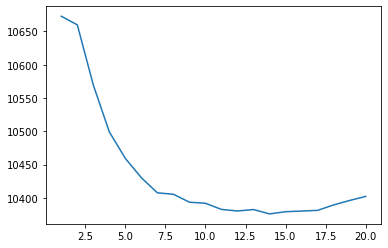

In [48]:
# searching for model order (max lag)
resultsAR_5 = []
for order in range(1, 21):
    model = sm.tsa.ARMA(series_5, (order, 0))
    resultsAR_5.append(model.fit())

bic_criteria_5 = [result.bic for result in resultsAR_5]

plt.plot(range(1, len(bic_criteria_5)+1), bic_criteria_5)

orderOfModel_5 = np.argmin(bic_criteria_5)+1
orderOfModel_5

In [49]:
# as the nature of case studied is known: series_5 is perturbed `series` with natural period equal 12 (in monthly scale),
# so instead of 14 for 'orderOfModel_4' we take 12 as model order
orderOfModel_5 = 12

In [50]:
# to compare the prediction results for different time series, the series is normalized
series_5 -= series_5.mean()
series_5 /= np.std(series_5)

In [51]:
testDickeyFuller = adfuller(series_5, maxlag=orderOfModel_5, autolag=None)
dfOutput = pd.Series(testDickeyFuller[0:4], index=[
                     'Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
pValue = dfOutput[1]
print(f'pValue: {pValue}\n')
dfOutput

pValue: 1.087650386419726e-07



Test Statistic                -6.081812e+00
p-value                        1.087650e-07
#Lags Used                     1.200000e+01
Number of Observations Used    3.634000e+03
dtype: float64

### 3.6. Model 6 - non-stationary time series (model 2) disturbed by a periodically modulated random walk 
Another disturbance model for a case study.

<Figure size 720x360 with 0 Axes>

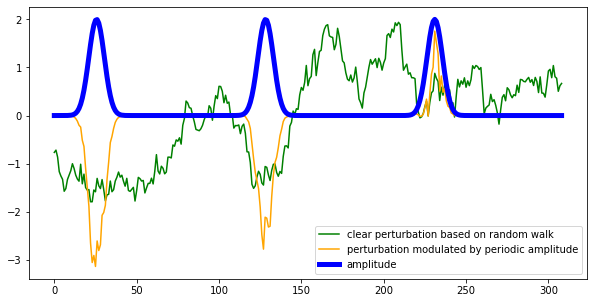

In [52]:
plt.figure(figsize=(10, 5))

# clear perturbution based on random walk
np.random.seed(34)
perturbation_6 = [0]
for j in range(len(series_2)-1):
    perturbation_6.append(perturbation_6[j] + np.random.normal())
perturbation_6 = np.array(perturbation_6)

perturbation_6 -= perturbation_6.mean()
perturbation_6 /= np.std(perturbation_6)


plt.figure(figsize=(10, 5))
plt.plot(perturbation_6, 'g', label='clear perturbation based on random walk')

# amplitude
levelOfPerturbution = 2.
periodNumberOfPerturbution = 3
amplitude = np.power(0.5*(1 + np.sin(periodNumberOfPerturbution*(2*np.pi)
                     * np.linspace(0, 1, len(series_2)))), 24)*levelOfPerturbution

# perturbation modulated by periodic amplitude
perturbation_6 *= amplitude
plt.plot(perturbation_6, 'orange',
         label='perturbation modulated by periodic amplitude')

plt.plot(amplitude, 'b', lw=5, label='amplitude')
plt.legend()

The figure below present the disturbed time series and the original undisturbed time series.

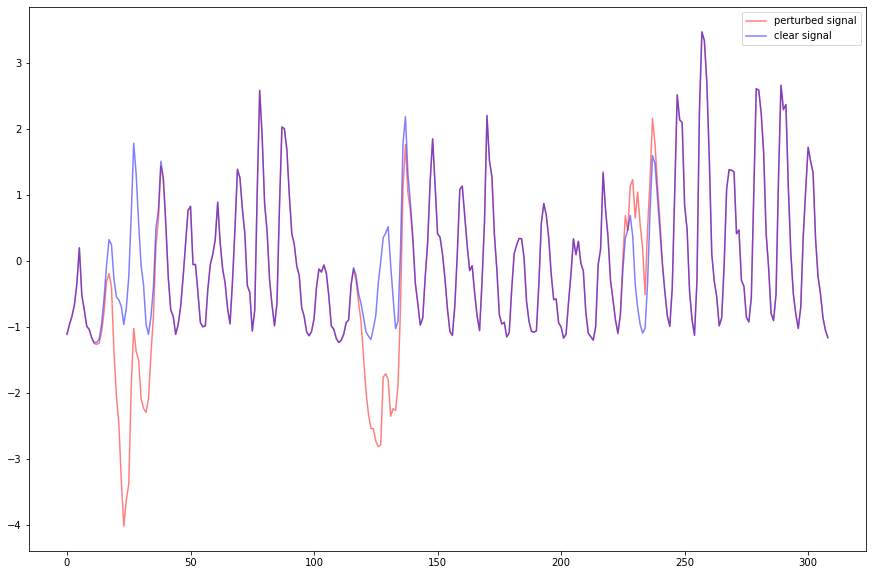

In [53]:
plt.figure(figsize=(15, 10))
series_6 = series_2 + perturbation_6
plt.plot(series_6, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series_2, 'b', label='clear signal', alpha=0.5)

plt.legend()

/home/marsob/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.94982D-01    |proj g|=  2.07242D-03

At iterate    5    f=  8.94935D-01    |proj g|=  3.33067D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      6     10      1     0     0   0.000D+00   8.949D-01
  F =  0.89493499065460114     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           12

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.09534D-01    |proj g|=  1.62372D-03

At iterate    5    f=  6.09500D-01    |proj g|=  5.65659D-05

At iterate   10    f=  6.09500D-01    |proj g|=  1.44329D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     12     14      1     0     0   4.441D-08   6.095D-01
  F =  0.60950017839687642     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.85087D-01    |proj g|=  3.36863D-03

At iterate    5    f=  5.84931D-01    |proj g|=  1.15030D-04

At iterate   10    f=  5.84931D-01    |proj g|=  1.03251D-06

At iterate   15    f=  5.84931D-01    |proj g|=  5.55112D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     15     17      1     0     0   5.551D-08   5.849D-01
  F =  0.58493072000227675     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate   15    f=  5.73080D-01    |proj g|=  5.55112D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     15     20      1     0     0   5.551D-08   5.731D-01
  F =  0.57308010712235868     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.62253D-01    |proj g|=  3.64860D-03

At iterate    5    f=  5.61986D-01    |proj g|=  4.28935D-04

At iterate   10    f=  5.61981D-01    |proj g|=  5.51781D-06

At iterate   15    f=  5.61981D-01    |proj g|=  6.66134D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     16     19      1     0     0   4.441D-08   5.620D-01
  F =  0.56198074136705167     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate    5    f=  5.57009D-01    |proj g|=  2.50566D-04

At iterate   10    f=  5.57007D-01    |proj g|=  3.49720D-06

At iterate   15    f=  5.57007D-01    |proj g|=  1.11022D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     16     18      1     0     0   1.332D-07   5.570D-01
  F =  0.55700724159844173     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           12     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.55170D-01    |proj g|=  3.58773D-03


 This problem is unconstrained.



At iterate    5    f=  5.54929D-01    |proj g|=  7.67775D-04

At iterate   10    f=  5.54926D-01    |proj g|=  6.98330D-06

At iterate   15    f=  5.54926D-01    |proj g|=  4.99600D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   12     18     21      1     0     0   4.441D-08   5.549D-01
  F =  0.55492550087506465     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           13     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.51704D-01    |proj g|=  3.79557D-03

At iterate    5    f=  5.51456D-01    |proj g|=  9.01768D-04

At iterate   10    f=  5.51450D-01    |proj g|=  1.64424D-05

At iterate   15    f=  5.51450D-01    |proj g|=  2.55351D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   13     18     25      1     0     0   6.661D-08   5.514D-01
  F =  0.55144984016420784     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate    5    f=  5.50586D-01    |proj g|=  4.24050D-04

At iterate   10    f=  5.50581D-01    |proj g|=  8.12683D-06

At iterate   15    f=  5.50581D-01    |proj g|=  1.11022D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   14     16     24      1     0     0   1.110D-07   5.506D-01
  F =  0.55058078674281508     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           15     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.48212D-01    |proj g|=  4.68365D-03

At iterate    5    f=  5.47868D-01    |proj g|=  4.22340D-04

At iterate   10    f=  5.47866D-01    |proj g|=  7.26086D-06

At iterate   15    f=  5.47866D-01    |proj g|=  1.77636D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   15     17     25      1     0     0   5.551D-08   5.479D-01
  F =  0.54786633432902854     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate    5    f=  5.42585D-01    |proj g|=  5.23204D-04

At iterate   10    f=  5.42581D-01    |proj g|=  2.17604D-06

At iterate   15    f=  5.42581D-01    |proj g|=  4.44089D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   16     16     19      1     0     0   9.992D-08   5.426D-01
  F =  0.54258121308692941     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


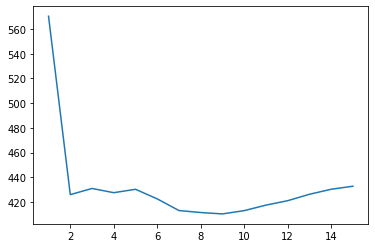

In [54]:
resultsAR_6 = []
for order in range(1, 16):
    model = sm.tsa.ARMA(series_6, (order, 0))
    resultsAR_6.append(model.fit())

bic_criteria_6 = [result.bic for result in resultsAR_6]

plt.plot(range(1, len(bic_criteria_6)+1), bic_criteria_6)

In [55]:
orderOfModel_6 = np.argmin(bic_criteria_6)+1
orderOfModel_6

9

In [56]:
# we take the best order from unperturbed origin `series 2`; the order is equal 9
orderOfModel_6 = orderOfModel_2

In [57]:
# to compare the prediction results for different time series, the series is normalized 
series_6 -= series_6.mean()
series_6 /= np.std(series_6)

In [58]:
testDickeyFuller = adfuller(
    series_6, maxlag=orderOfModel_6, autolag=None)
dfOutput = pd.Series(testDickeyFuller[0:4], index=[
                     'Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
pValue = dfOutput[1]
print(f'pValue: {pValue}\n')
dfOutput

pValue: 0.10814266096622899



Test Statistic                  -2.530871
p-value                          0.108143
#Lags Used                       9.000000
Number of Observations Used    299.000000
dtype: float64

As one would expect `series_6` as a linear combination including a modulated random walk is non-stationary. 

### 3.7. Model 7 - non-stationary time series (model 2) disturbed by a Gaussian-shape modulated random walk
Another disturbance model for a case study.

<Figure size 720x360 with 0 Axes>

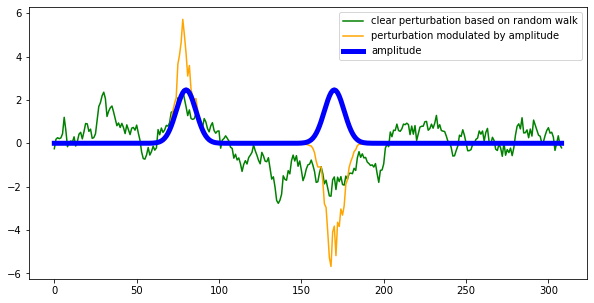

In [60]:
plt.figure(figsize=(10, 5))

# clear perturbution based on random walk
np.random.seed(39)
perturbation_7 = [0]
for j in range(len(series_2)-1):
    perturbation_7.append(perturbation_7[j] + np.random.normal())
perturbation_7 = np.array(perturbation_7)

perturbation_7 -= perturbation_7.mean()
perturbation_7 /= np.std(perturbation_7)


plt.figure(figsize=(10, 5))
plt.plot(perturbation_7, 'g', label='clear perturbation based on random walk')

# amplitude
levelOfPerturbution = 0.6
amplitude = gauss(80, 6).pdf(range(len(series_2))) + \
    gauss(170, 6).pdf(range(len(series_2)))
amplitude /= np.std(amplitude)
amplitude *= levelOfPerturbution

# perturbation modulated by periodic amplitude
perturbation_7 *= amplitude
plt.plot(perturbation_7, 'orange', label='perturbation modulated by amplitude')

plt.plot(amplitude, 'b', lw=5, label='amplitude')
plt.legend()

The figure below present the disturbed time series and the original undisturbed time series.

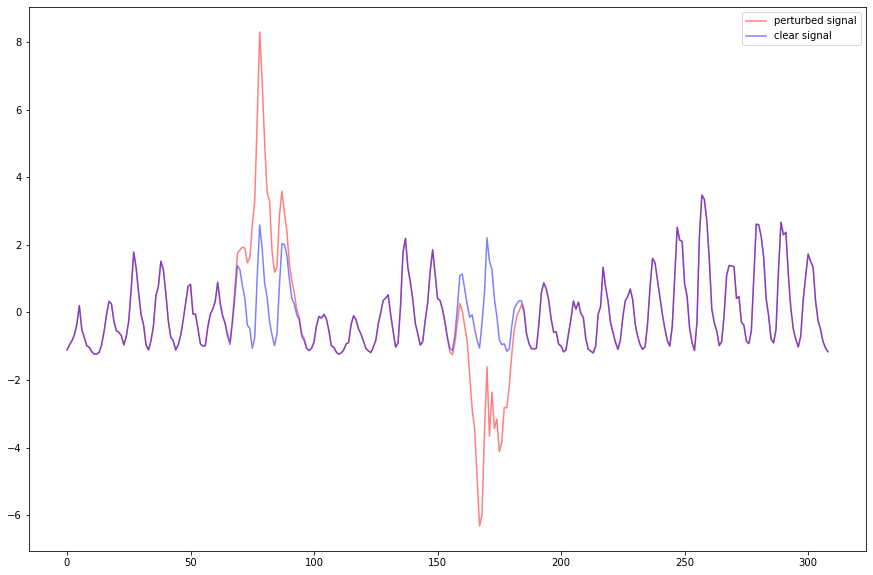

In [61]:
plt.figure(figsize=(15, 10))
series_7 = series_2 + perturbation_7
plt.plot(series_7, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series_2, 'b', label='clear signal', alpha=0.5)

plt.legend()

/home/marsob/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/arima_model.py:472: FutureWarning: 
statsmodels.tsa.arima_model.ARMA and statsmodels.tsa.arima_model.ARIMA have
been deprecated in favor of statsmodels.tsa.arima.model.ARIMA (note the .
between arima and model) and
statsmodels.tsa.SARIMAX. These will be removed after the 0.12 release.

statsmodels.tsa.arima.model.ARIMA makes use of the statespace framework and
is both well tested and maintained.

To silence this warning and continue using ARMA and ARIMA until they are
removed, use:

import warnings
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

  warnings.warn(ARIMA_DEPRECATION_WARN, FutureWarning)
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.01551D+00    |proj g|=  1.40405D-03

At iterate    5    f=  1.01545D+00    |proj g|=  0.00000D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      7      1     0     0   0.000D+00   1.015D+00
  F =   1.0154532813194943     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           12

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.37741D-01    |proj g|=  1.51941D-03

At iterate    5    f=  8.37709D-01    |proj g|=  1.66422D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      9     12      1     0     0   5.551D-08   8.377D-01
  F =  0.83770865447163489     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           12

At X0         0 v

 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     12     15      1     0     0   5.551D-08   8.059D-01
  F =  0.80585057946168703     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.74517D-01    |proj g|=  2.83968D-03


 This problem is unconstrained.



At iterate    5    f=  7.74384D-01    |proj g|=  1.08613D-03

At iterate   10    f=  7.74368D-01    |proj g|=  5.25247D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     14     17      1     0     0   4.441D-08   7.744D-01
  F =  0.77436827250765905     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.74495D-01    |proj g|=  3.10096D-03

At iterate    5    f=  7.74367D-01    |proj g|=  8.07698D-04

At iterate   10    f=  7.74350D-01    |proj g|=  4.89941D-05

At iterate   15    f=  7.74350D-01    |proj g|=  3.33067D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     16     21      1     0     0   3.331D-08   7.743D-01
  F =  0.77434971863671009     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate   10    f=  7.72711D-01    |proj g|=  3.73146D-05

At iterate   15    f=  7.72711D-01    |proj g|=  5.55112D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     17     21      1     0     0   2.220D-08   7.727D-01
  F =  0.77271093441624061     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.67613D-01    |proj g|=  3.03462D-03

At iterate    5    f=  7.67479D-01    |proj g|=  1.13799D-03

At iterate   10    f=  7.67465D-01    |proj g|=  2.39475D-05

At iterate   15    f=  7.67465D-01    |proj g|=  1.33227D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     17     21      1     0     0   5.551D-08   7.675D-01
  F =  0.76746538496756611     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           12     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50998D-01    |proj g|=  2.99785D-03

At iterate    5    f=  7.50861D-01    |proj g|=  9.82758D-04

At iterate   10    f=  7.50852D-01    |proj g|=  2.71561D-05

At iterate   15    f=  7.50852D-01    |proj g|=  7.77156D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   12     17     21      1     0     0   4.441D-08   7.509D-01
  F =  0.75085210089838972     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           13     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.44475D-01    |proj g|=  2.76102D-03

At iterate    5    f=  7.44327D-01    |proj g|=  1.26242D-03

At iterate   10    f=  7.44311D-01    |proj g|=  1.15152D-04

At iterate   15    f=  7.44311D-01    |proj g|=  4.80727D-06

At iterate   20    f=  7.44311D-01    |proj g|=  8.88178D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   13     20     24      1     0     0   8.882D-08   7.443D-01
  F =  0.74431059930527266     

CONVERG

 This problem is unconstrained.



At iterate    5    f=  7.42988D-01    |proj g|=  5.83500D-04

At iterate   10    f=  7.42981D-01    |proj g|=  1.42775D-05

At iterate   15    f=  7.42981D-01    |proj g|=  8.77076D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   14     19     25      1     0     0   7.772D-08   7.430D-01
  F =  0.74298137152707566     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           15     M =           12

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.42740D-01    |proj g|=  2.49594D-03

At iterate    5    f=  7.42534D-01    |proj g|=  5.30243D-04

At iterate   10    f=  7.42530D-01    |proj g|=  3.58602D-06

At iterate   15    f=  7.42530D-01    |proj g|=  1.55431D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   15     17     24      1     0     0   1.221D-07   7.425D-01
  F =  0.74252998231242251     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING 

 This problem is unconstrained.



At iterate    5    f=  7.38091D-01    |proj g|=  6.33049D-04

At iterate   10    f=  7.38085D-01    |proj g|=  1.75526D-05

At iterate   15    f=  7.38085D-01    |proj g|=  5.32907D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   16     19     22      1     0     0   9.992D-08   7.381D-01
  F =  0.73808453738108371     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


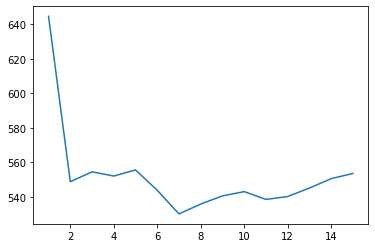

In [62]:
resultsAR_7 = []
for order in range(1, 16):
    model = sm.tsa.ARMA(series_7, (order, 0))
    resultsAR_7.append(model.fit())

bic_criteria_7 = [result.bic for result in resultsAR_7]

plt.plot(range(1, len(bic_criteria_7)+1), bic_criteria_7)

orderOfModel_7 = np.argmin(bic_criteria_7)+1
orderOfModel_7

In [63]:
orderOfModel_7 = orderOfModel_2

In [64]:
# to compare the prediction results for different time series, the series is normalized
series_7 -= series_7.mean()
series_7 /= np.std(series_7)

In [65]:
testDickeyFuller = adfuller(series_7, maxlag=orderOfModel_7, autolag=None)
dfOutput = pd.Series(testDickeyFuller[0:4], index=[
                     'Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
pValue = dfOutput[1]
print(f'pValue: {pValue}\n')
dfOutput

pValue: 0.09323373002656415



Test Statistic                  -2.598857
p-value                          0.093234
#Lags Used                       9.000000
Number of Observations Used    299.000000
dtype: float64

As one would expect `series_7` as a linear combination including a modulated random walk is non-stationary.

## 4. Calculations
We will describe the structure of the calculations on the first tested time series. 

### 4.1. Model 1

We split the data into a training set and a test set.

In [66]:
series_train, series_test = train_test_split(
    series, test_size=0.20, random_state=42, shuffle=False)

The function below was taken from Jason Brownlee's  article: 'How to Convert a Time Series to a Supervised Learning Problem in Python'(https://machinelearningmastery.com/convert-time-series-supervised-learning-problem-python/). 

It allows to convert a forecasting task of time series into a supervised learning task.

In [67]:
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    """
    Frame a time series as a supervised learning dataset.
    Arguments:
        data: Sequence of observations as a list or NumPy array.
        n_in: Number of lag observations as input (X).
        n_out: Number of observations as output (y).
        dropnan: Boolean whether or not to drop rows with NaN values.
    Returns:
        Pandas DataFrame of series framed for supervised learning.
    """
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

Transformation of training data `df_train` into supervised learning dataset `dataframe_train`. The last column is a dependent variable, the previous columns are explanatory variables.

In [68]:
df_train = pd.DataFrame()
df_train['t'] = [x for x in series_train]
dataframe_train = series_to_supervised(df_train, orderOfModel)
dataframe_train.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,2.342548,1.653082,1.874696,0.840497,1.135982,1.135982,1.135982,1.529963,2.613409,2.170181,1.234477,0.520388,1.357596
13,1.653082,1.874696,0.840497,1.135982,1.135982,1.135982,1.529963,2.613409,2.170181,1.234477,0.520388,1.357596,2.539538
14,1.874696,0.840497,1.135982,1.135982,1.135982,1.529963,2.613409,2.170181,1.234477,0.520388,1.357596,2.539538,3.401371
15,0.840497,1.135982,1.135982,1.135982,1.529963,2.613409,2.170181,1.234477,0.520388,1.357596,2.539538,3.401371,2.342548
16,1.135982,1.135982,1.135982,1.529963,2.613409,2.170181,1.234477,0.520388,1.357596,2.539538,3.401371,2.342548,2.317924


As before for test data. 

In [69]:
df_test = pd.DataFrame()
df_test['t'] = [x for x in series_test]
dataframe_test = series_to_supervised(df_test, orderOfModel)
dataframe_test.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,0.766625,1.529963,1.800825,1.382220,0.077159,-0.415316,0.249526,1.111359,1.259101,0.594259,0.348021,0.643507,0.224902
13,1.529963,1.800825,1.382220,0.077159,-0.415316,0.249526,1.111359,1.259101,0.594259,0.348021,0.643507,0.224902,0.545011
14,1.800825,1.382220,0.077159,-0.415316,0.249526,1.111359,1.259101,0.594259,0.348021,0.643507,0.224902,0.545011,1.505339
15,1.382220,0.077159,-0.415316,0.249526,1.111359,1.259101,0.594259,0.348021,0.643507,0.224902,0.545011,1.505339,2.022439
16,0.077159,-0.415316,0.249526,1.111359,1.259101,0.594259,0.348021,0.643507,0.224902,0.545011,1.505339,2.022439,1.332973


Split into input (explanatory) variables, `X_`, and output (dependent) variable, `y_`  

In [70]:
X_train, y_train = dataframe_train.values[:,
                                          :-1], dataframe_train.values[:, -1]
X_test, y_test = dataframe_test.values[:, :-1], dataframe_test.values[:, -1]

I check the dimensions to make sure everything is fine.

In [71]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((2905, 12), (2905,), (718, 12), (718,))

Below we initialize the dictionaries: `models` i `grids_xxx`.

In dictionary `models` we will put sets of the best estimators obtained for various machine learning methods  (`ElasticNet`, `Lasso`, `Ridge`, `SVR`), different  CV (`KFold`, `TimeSeriesSplit`, `PrimitiveFold`, `RollingTimeSeriesSplit`) and different  mean(`'MSE - arithmetic'`, `'RMSE - arithmetic'`, `'MSE - harmonic'`, `'RMSE - harmonic'`,`'RMSE - weighted by MSE'`) used to find an optimal set of hyperparameters. The structure of `models` is as follows:
```python
models = {cv_name: [((approach, name_estimator), estimator), ...], ...}
    cv_name: str
        Pointing at the cross-validation.
        Np.: 'KFold', 'TimeSeriesSplit', 'PrimitiveFold', 'RollingTimeSeriesSplit'.
    approach: str
        Pointing at the metric and kind of mean used to find the best hyperparameterization.
        Choose from: 'MSE - arithmetic', 'RMSE - arithmetic', 'MSE - harmonic', 'RMSE - harmonic',
            'RMSE - weighted by MSE'. 
    name_estimator: str
        Specifies the kind of the machine learning method.
        Np.: 'ElasticNet', 'Lasso', 'Ridge', 'SVR' 
    estimator: estimator object
```

In turn `grids_xxx` is a dictionary assigned to a specific method of machine learning (ML) `_xxx` (`xxx` $\in$ {ElasticNet, Lasso, Ridge, SVR, ...}),  in which we will input `GridSearchCV` class objects performing an exhaustive hyperparameter search for different CVs. The structure of `grids_xxx` is as follows:
```python
grids_xxx = {cv_name: grid, ...}
    grid: GridSearchCV object
```



In [72]:
models = {}
grids_ElasticNet, grids_Lasso, grids_Ridge, grids_SVR = {}, {}, {}, {}

We create dictionaries:
    `kfolds`- contains objects that perform various validations type,
    `scoring`- contains metrics to find the optimal hyperparameterization.

In [73]:
kfolds = {'KFold_10': KFold(n_splits=10, shuffle=False), 'TimeSeriesSplit_9': TimeSeriesSplit(n_splits=9),
          'PrimitiveFold_9': PrimitiveFold(ratioTrainTest=9), 'RollingTSS_9': RollingTimeSeriesSplit(n_splits=9)}
scoring = {'MSE': 'neg_mean_squared_error',
           'RMSE': 'neg_root_mean_squared_error'}

Below we define function `bestParamsForTimeSeriesObtainedByVariousApproaches`, which based on fitted (with metric MSE and RMSE) instance of class `GridSearchCV` returns sets of the best hyperparameters, each the set is selected on a different mean type ('MSE - arithmetic', 'RMSE - arithmetic', 'MSE - harmonic', 'RMSE - harmonic', 'RMSE - weighted by MSE').

In [75]:
def bestParamsForTimeSeriesObtainedByVariousApproaches(gridWithMetricsMSE_AndRMSE):
    '''
    Finds the best sets of hyperparameters based on a various approaches to calculate a mean of
    the prediction error ('MSE - arithmetic', 'RMSE - arithmetic','MSE - harmonic', 'RMSE - harmonic',
    'RMSE - weighted by MSE') of CV-iteration . 
    Arguments: 
        gridWithMetricsMSE_AndRMSE: a fitted instance of GridSearchCV, initialized with
        the parameter: `scoring={'MSE': 'neg_mean_squared_error', 'RMSE': 'neg_root_mean_squared_error'}`
    Returns: dict
        GridSearchCV object, for example, the returned dictionary looks like this:
        {' MSE - arithmetic': {'ridge__alpha': 1.0},
         'RMSE - arithmetic': {'ridge__alpha': 1.0},
         ' MSE - harmonic': {'ridge__alpha': 0.0},
         'RMSE - harmonic': {'ridge__alpha': 0.25},
         'RMSE - weighted by MSE': {'ridge__alpha': 0.0}} 
    '''

    # preparation of auxiliary variables

    grid = gridWithMetricsMSE_AndRMSE
    cvResults = grid.cv_results_
    matrix_cvResultsOfMetrics = {}
    bestParams_variousApproaches = {}

    # finding the best hyperparameters based on arithmetic means from MSE and RMSE

    for nameMetric in ['MSE', 'RMSE']:
        matrix_cvResultsOfMetrics[nameMetric] = np.array(
            [cvResults[k] for k in grid.cv_results_.keys() if fnmatch(k, f'split*_test_{nameMetric}')])
        # determination the arithmetic means of folds for each set of hyperparameters
        scoresForHiperparameters = np.mean(
            matrix_cvResultsOfMetrics[nameMetric], axis=0)
        argsortedScore = np.argsort(scoresForHiperparameters)[::-1]
        bestParams = grid.cv_results_['params'][argsortedScore[0]]
        # assigning the best hyperparameters according to the used mean
        bestParams_variousApproaches['%4s - arithmetic' %
                                     nameMetric] = bestParams
    for nameMetric in ['MSE', 'RMSE']:
        # determination the harmonic means of folds for each set of hyperparameters
        scoresForHiperparameters = harmonicMean(
            matrix_cvResultsOfMetrics[nameMetric], axis=0)
        argsortedScore = np.argsort(scoresForHiperparameters)[::-1]
        bestParams = grid.cv_results_['params'][argsortedScore[0]]
        # assigning the best hyperparameters according to the used mean
        bestParams_variousApproaches['%4s - harmonic' %
                                     nameMetric] = bestParams
    # determination the weighted means of folds for each set of hyperparameters
    scorePerSplits = weightedArithmeticMean(
        matrix_cvResultsOfMetrics['RMSE'], variances=matrix_cvResultsOfMetrics['MSE'], axis=0)
    argsortedScore = np.argsort(scorePerSplits)[::-1]
    bestParams = grid.cv_results_['params'][argsortedScore[0]]
    # assigning the best hyperparameters according to the used mean
    bestParams_variousApproaches['RMSE - weighted by MSE'] = bestParams

    return bestParams_variousApproaches

We define an auxiliary function that prints the best found hyperparameters to compare them with the range of hyperparameters under considaration. The function is used to check if the range of searched hyperparameters was large enough for the found model to be considered as sufficiently well trained.

In [76]:
def toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name):
    for k, v in bestParamsForMethod.items():
        print(k)
        print(v)

A very important element of this project is the selection of a sufficiently large range of considered hyperparameters. This is a necessary requirement to be able to compare the results obtained for different types of validation and different types of means used to optimize the hyperparameters. For this, it is first carried out grid search for a standard KFold-type CV starting from the intuitively assumed/guessed range of hyperparameters, and then it is compared whether the resulting best sets of hyperparameters are reasonably within the range under consideration. If not, the range of hyperparameter is extended and the calculation is redone. The procedure is repeated until a reasonable result has been obtained. 

In [77]:
cv_name = list(kfolds.keys())[0]
kfold = kfolds[cv_name]
print(
    f'Type of k-fold used to find a reasonable range of hiperparameters:\n{kfold}')

Type of k-fold used to find a reasonable range of hiperparameters:
KFold(n_splits=10, random_state=None, shuffle=False)


In [78]:
%%time
# %%time is useful for estimating the time needed for calculations

# uthe range of hyperparameters is assumed
param_grid_ElasticNet = {'polynomialfeatures__degree': [1, 2],
                         'elasticnet__alpha': np.linspace(0, 0.125, 33),
                         'elasticnet__l1_ratio': np.linspace(0, 0.250, 33)
                         }

# execute function GridSearchCV(...) necessarily with the parameter:
# `scoring={'MSE': 'neg_mean_squared_error', 'RMSE': 'neg_root_mean_squared_error'}`
grids_ElasticNet[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), ElasticNet(alpha=1, tol=0.1)),
                                         param_grid=param_grid_ElasticNet,
                                         cv=kfold,
                                         refit=False,
                                         scoring=scoring)
grids_ElasticNet[cv_name].fit(X_train, y_train)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.27603153144514, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479.02772174706445, tolerance: 262.93479441483123
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 465.5510515516353, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479.02772174706445, tolerance: 262.93479441483123
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 465.5510515516353, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.3664766092258, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.20566340545577, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 484.2057915181943, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 492.6812195899302, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 481.0702071273891, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 465.27197626182266, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 468.9862898386477, tolerance: 258.69163917802297
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 467.263029313246, tolerance: 262.93479441483123
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 470.78794237557645, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 487.45530074317384, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.4053675029843, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 499.93423614471897, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 488.7476882644525, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 494.5688426407056, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 478.1215566352034, tolerance: 258.69163917802297
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 476.36840601109884, tolerance: 262.93479441483123
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 478.773759515173, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 494.05930091407737, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 488.5126693130852, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.91021351188954, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.12102589323257, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 476.6192769324416, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479.86987184414556, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 484.971732824114, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 489.74713081914103, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 485.6687297575234, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.31074078262634, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 500.70932443485214, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 505.44299912135, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.51381854081035, tolerance: 258.69163917802297
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 489.80350366538556, tolerance: 262.93479441483123
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.2958028449513, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 504.49960866257425, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 498.2055061832888, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.4549344692183, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.85832826514684, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 487.7389657085711, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.922867439327, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 497.3149283087033, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 501.26524286857693, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 498.00379927628734, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 521.3793148330325, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.23089719626466, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 515.0806841787822, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.8619682031127, tolerance: 258.69163917802297
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 501.2334576074616, tolerance: 262.93479441483123
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.02057268369373, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 513.810042908917, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 506.8852533766711, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.88648843594655, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.04995461559605, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 497.3830212133796, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.37781863572366, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 508.0173878349284, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.29335218893027, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 508.72186003439333, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 530.4356803622047, tolerance: 261.06394188209066
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 520.6546620292646, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 523.759383051524, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 512.8241839264924, tolerance: 258.69163917802297
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.28762582400384, tolerance: 262.93479441483123
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.4946556673458, tolerance: 253.57440110542248
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 522.2319635882901, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 514.7635041245271, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 520.4394038974782, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.1196931848625, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 505.9666425721053, tolerance: 244.04373456723616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.6816852084158, tolerance: 256.98852575865504
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 517.5366376856834, tolerance: 268.91134538602665
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 520.2344816918913, tolerance: 255.7956738811318
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 518.2665470907431, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

CPU times: user 39min 33s, sys: 2min 23s, total: 41min 56s
Wall time: 5min 14s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('elasticnet',
                                        ElasticNet(alpha=1, tol=0.1))]),
             param_grid={'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
       0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.0351562...
       0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
       0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
       0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
       0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
       0.234375 , 0.2421875, 0.25     ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=Fal

In [79]:
# porównujemy czy najlepszę dopasowania uzyskana przy pomocy różnych podejść rozsadnie mieszczą się przeszukiwanym zbiorze hiperparametrów
# jeżeli nie to wracamy krok wyżej i zmieniamy odpowiednio zbiór przeszukiwanych hiperparametrów
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_ElasticNet[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_ElasticNet[cv_name].param_grid

 MSE - arithmetic
{'elasticnet__alpha': 0.0078125, 'elasticnet__l1_ratio': 0.0234375, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'elasticnet__alpha': 0.00390625, 'elasticnet__l1_ratio': 0.1328125, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'elasticnet__alpha': 0.00390625, 'elasticnet__l1_ratio': 0.1328125, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'elasticnet__alpha': 0.00390625, 'elasticnet__l1_ratio': 0.1328125, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'elasticnet__alpha': 0.00390625, 'elasticnet__l1_ratio': 0.2265625, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
        0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.03515625,
        0.0390625 , 0.04296875, 0.046875  , 0.05078125, 0.0546875 ,
        0.05859375, 0.0625    , 0.06640625, 0.0703125 , 0.07421875,
        0.078125  , 0.08203125, 0.0859375 , 0.08984375, 0.09375   ,
        0.09765625, 0.1015625 , 0.10546875, 0.109375  , 0.11328125,
        0.1171875 , 0.12109375, 0.125     ]),
 'elasticnet__l1_ratio': array([0.       , 0.0078125, 0.015625 , 0.0234375, 0.03125  , 0.0390625,
        0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
        0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
        0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
        0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
        0.234375 , 0.2421875, 0.25     ])}

In [80]:
%%time
param_grid_Lasso = {'polynomialfeatures__degree': [1, 2],
                    'lasso__alpha': np.linspace(0, 0.03, 201)
                    }
grids_Lasso[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Lasso(alpha=1, tol=0.1)),
                                    param_grid=param_grid_Lasso,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring)
grids_Lasso[cv_name].fit(X_train, y_train)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.27603153144514, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.22018390377434, tolerance: 250.8803002643385
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

CPU times: user 3min 48s, sys: 14.7 s, total: 4min 2s
Wall time: 30.4 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('lasso', Lasso(alpha=1, tol=0.1))]),
             param_grid={'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
       0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
       0.0021 ,...
       0.0252 , 0.02535, 0.0255 , 0.02565, 0.0258 , 0.02595, 0.0261 ,
       0.02625, 0.0264 , 0.02655, 0.0267 , 0.02685, 0.027  , 0.02715,
       0.0273 , 0.02745, 0.0276 , 0.02775, 0.0279 , 0.02805, 0.0282 ,
       0.02835, 0.0285 , 0.02865, 0.0288 , 0.02895, 0.0291 , 0.02925,
       0.0294 , 0.02955, 0.0297 , 0.02985, 0.03   ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=False,
             scoring={'MSE'

In [81]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Lasso[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Lasso[cv_name].param_grid

 MSE - arithmetic
{'lasso__alpha': 0.0012, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'lasso__alpha': 0.0012, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'lasso__alpha': 0.00045, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'lasso__alpha': 0.0012, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'lasso__alpha': 0.00045, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
        0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
        0.0021 , 0.00225, 0.0024 , 0.00255, 0.0027 , 0.00285, 0.003  ,
        0.00315, 0.0033 , 0.00345, 0.0036 , 0.00375, 0.0039 , 0.00405,
        0.0042 , 0.00435, 0.0045 , 0.00465, 0.0048 , 0.00495, 0.0051 ,
        0.00525, 0.0054 , 0.00555, 0.0057 , 0.00585, 0.006  , 0.00615,
        0.0063 , 0.00645, 0.0066 , 0.00675, 0.0069 , 0.00705, 0.0072 ,
        0.00735, 0.0075 , 0.00765, 0.0078 , 0.00795, 0.0081 , 0.00825,
        0.0084 , 0.00855, 0.0087 , 0.00885, 0.009  , 0.00915, 0.0093 ,
        0.00945, 0.0096 , 0.00975, 0.0099 , 0.01005, 0.0102 , 0.01035,
        0.0105 , 0.01065, 0.0108 , 0.01095, 0.0111 , 0.01125, 0.0114 ,
        0.01155, 0.0117 , 0.01185, 0.012  , 0.01215, 0.0123 , 0.01245,
        0.0126 , 0.01275, 0.0129 , 0.01305, 0.0132 , 0.01335, 0.0135 ,
        0.01365, 0.013

In [82]:
%%time
param_grid_Ridge = {'polynomialfeatures__degree': [1, 2],
                    'ridge__alpha':  np.linspace(1, 30, 117)
                    }
grids_Ridge[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Ridge(alpha=1, tol=0.1)),
                                    param_grid=param_grid_Ridge,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring)
grids_Ridge[cv_name].fit(X_train, y_train)

CPU times: user 1min 45s, sys: 7.01 s, total: 1min 52s
Wall time: 14.1 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('ridge', Ridge(alpha=1, tol=0.1))]),
             param_grid={'polynomialfeatures__degree': [1, 2],
                         'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
        3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5....
       16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
       19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
       21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
       23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
       25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
       28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 2

In [83]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Ridge[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Ridge[cv_name].param_grid

 MSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 14.75}
RMSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 14.75}
 MSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 14.0}
RMSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 14.25}
RMSE - weighted by MSE
{'polynomialfeatures__degree': 1, 'ridge__alpha': 13.5}


{'polynomialfeatures__degree': [1, 2],
 'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
         3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5.25,
         5.5 ,  5.75,  6.  ,  6.25,  6.5 ,  6.75,  7.  ,  7.25,  7.5 ,
         7.75,  8.  ,  8.25,  8.5 ,  8.75,  9.  ,  9.25,  9.5 ,  9.75,
        10.  , 10.25, 10.5 , 10.75, 11.  , 11.25, 11.5 , 11.75, 12.  ,
        12.25, 12.5 , 12.75, 13.  , 13.25, 13.5 , 13.75, 14.  , 14.25,
        14.5 , 14.75, 15.  , 15.25, 15.5 , 15.75, 16.  , 16.25, 16.5 ,
        16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
        19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
        21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
        23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
        25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
        28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 29.75, 30.  ])}

In [84]:
%%time
param_grid_SVR = {"svr__C": np.linspace(100, 240, 36),
                  "svr__gamma": np.linspace(0.00010, 0.00052, 43)}
grids_SVR[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                  param_grid=param_grid_SVR,
                                  cv=kfold,
                                  refit=False,
                                  scoring=scoring
                                  )
grids_SVR[cv_name].fit(X_train, y_train)

CPU times: user 1h 59min 3s, sys: 177 ms, total: 1h 59min 3s
Wall time: 1h 59min 5s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('svr', SVR(gamma=0.1))]),
             param_grid={'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
       144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
       188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
       232...
       0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
       0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
       0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
       0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
       0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
       0.00052])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE': 'neg_root_mean_squared_error'})

In [85]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_SVR[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_SVR[cv_name].param_grid

 MSE - arithmetic
{'svr__C': 100.0, 'svr__gamma': 0.00044999999999999993}
RMSE - arithmetic
{'svr__C': 100.0, 'svr__gamma': 0.00044999999999999993}
 MSE - harmonic
{'svr__C': 100.0, 'svr__gamma': 0.00044999999999999993}
RMSE - harmonic
{'svr__C': 100.0, 'svr__gamma': 0.00044999999999999993}
RMSE - weighted by MSE
{'svr__C': 100.0, 'svr__gamma': 0.00044999999999999993}


{'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
        144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
        188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
        232., 236., 240.]),
 'svr__gamma': array([0.0001 , 0.00011, 0.00012, 0.00013, 0.00014, 0.00015, 0.00016,
        0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
        0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
        0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
        0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
        0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
        0.00052])}

It should be noted here that  `GridSearchCV` was called/invoked with a parameter `refit=False`, so objects `grids_xxx[cv_name]` have no attribute  `best_estimator_`, and therefore do not have a trained estimator. However, they have the results from the CV, which will be used later in the notebook to create and train optimal estimators. For this purpose, they will be used: previously defined function `bestParamsForTimeSeriesObtainedByVariousApproaches`, which returns the best sets of hyperparameters and the two functions defined below  `unhiperparameterizedNestedCopyOfEstimator` and `refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method`. The first one returns a "deep" unparameterized copy of the estimator, the second trains the models contained in the dictionary `models` based on the hyperparameters pointed by the functions `bestParamsForTimeSeriesObtainedByVariousApproaches` and dictionary `grids_xxx`.

In [86]:
def unhiperparameterizedNestedCopyOfEstimator(estimator):
    '''
    The function creates a "deep" copy of the estimator (including nested estimators) using recursion.This copy
    is untrained. Making a "deep" copy is important because an estimators used in sklearn are nested.
    Arguments:
        estimator: estimator object
    Returns:
        estimator object
            Untrained copy of the estimator
    '''
    try:
        return estimator.__class__()
    except TypeError:
        steps = [(name, unhiperparameterizedNestedCopyOfEstimator(estimator))
                 for name, estimator in estimator.steps]
        return estimator.__class__(steps)

In [87]:
def refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(models, cv_name, listOfGrids_method, X, y):
    """
    Funkcja nadpisuje wskazaną przez zmienną `cv_name` pozycje słownika `models` listą najlepszych estymatorów uzyskanych
    w ramach różnych średnich (`'MSE - arithmetic'`, `'RMSE - arithmetic'`, `'MSE - harmonic'`, `'RMSE - harmonic'`,
    `'RMSE - weighted by MSE'`) oraz metod uczenia maszynowego dostepnych w sklearn np.:
    `ElasticNet`, `Lasso`, `Ridge`, `SVR`.

    W słowniku `models` mieszczą się zestawy najlepszych estymatorów uzyskanych
    dla różnych metod uczenia maszynowego (`ElasticNet`, `Lasso`, `Ridge`, `SVR`),
    różnych CV (`KFold`, `TimeSeriesSplit`, `PrimitiveFold`, `RollingTimeSeriesSplit`) oraz różnych średnich
    (`'MSE - arithmetic'`, `'RMSE - arithmetic'`, `'MSE - harmonic'`, `'RMSE - harmonic'`,`'RMSE - weighted by MSE'`)
    stosowanych w celu znalezienia optymalnego zestawu hiperparametrów. Struktura `models` przedstawia się następujaco:
    ```
    models = {cv_name: [((approach, name_estimator), estimator), ...], ...}
        cv_name: str
            Wskazuje na kroswalidacje.
            Np.: 'KFold', 'TimeSeriesSplit', 'PrimitiveFold', 'RollingTimeSeriesSplit'.
        approach: str
            Wskazuje na metrykę i rodzaj średniej użytej do wyodrebnienia najlepszej hiperparametryzacji.
            Do wyboru spośród: 'MSE - arithmetic', 'RMSE - arithmetic', 'MSE - harmonic', 'RMSE - harmonic',
                'RMSE - weighted by MSE'. 
        name_estimator: str
            Określa rodzaj użytej metody uczenia maszynowego.
            Np.: 'ElasticNet', 'Lasso', 'Ridge', 'SVR' 
        estimator: estimator object
    ```

    `listOfGrids_method ` ot lista składająca sie ze słowników `grids_xxx`. Z kolei `grids_xxx` to słownik przypisany
    do okreslonej metody ML `_xxx` (`xxx` $\in$ {ElasticNet, Lasso, Ridge, SVR, ...}), umieszcza się w nim obiekty
    klasy `GridSearchCV` realizujące wyczerpujące wyszukiwanie hiperparametrów dla różnych CV.
    Struktura `grids_xxx` przedstawia się następujaco:
    ```
    grids_xxx = {cv_name: grid, ...}
        grid: GridSearchCV object
    ```

    `X` -- input variables, `y` -- output variables.
    """

    models[cv_name] = []
    for grids_ in listOfGrids_method:
        grid_ = grids_[cv_name]
        # `approach` represents kind of mean (arithmetic, harmonic, weighted, MSE, RMSE)
        # used for find best hiperparametrization.
        for approach, params in bestParamsForTimeSeriesObtainedByVariousApproaches(grid_).items():
            # create a untrained (unset) copy of estimator for the approach
            estimator = unhiperparameterizedNestedCopyOfEstimator(
                grid_.estimator).set_params(**params)
            try:  # if the estimator is nested
                name_estimator = estimator.steps[-1][-1].__str__()
            except AttributeError:  # if the estimator is not nested
                name_estimator = estimator.__str__()
            name_estimator = name_estimator[:name_estimator.find('(')]
            #
            models[cv_name].append(
                ((approach, name_estimator), estimator.fit(X, y)))

The function `outcomeOfModelsPredictionForVariousApproaches` returns tables with results that determine the quality of fitted models trained on the dataset in the form of input variables` X` and output variables `y` 

In [88]:
def outcomeOfModelsPredictionForVariousApproaches(models, cv_name, X, y):
    '''
    Returns tables with results in metrics:
    $R^2$ - coefficient of determination
    MSE - mean squared error
    RMSE - root mean squared error
    MAE - mean absolute error
    '''
    r2 = []
    mean_squared_error = []
    root_mean_squared_error = []
    mean_absolute_error = []
    for name, model in models[cv_name]:
        r2.append(metrics.r2_score(y, model.predict(X)))
        mean_squared_error.append(
            metrics.mean_squared_error(y, model.predict(X)))
        root_mean_squared_error.append(np.sqrt(mean_squared_error[-1]))
        mean_absolute_error.append(
            metrics.mean_absolute_error(y, model.predict(X)))

    d = {'$R^2$': r2,
         'MSE': mean_squared_error,
         'RMSE': root_mean_squared_error,
         'MAE': mean_absolute_error,
         }
    df = pd.DataFrame(data=d)
    df.insert(loc=0, column='MeanToBestHiperparams', value=[
              name[0] for name, _ in models[cv_name]])
    df.insert(loc=0, column='Method', value=[
              name[1] for name, _ in models[cv_name]])
    print(cv_name)
    return df

In [227]:
# using calculated grids for a given cross-validation type and training data
# best models are created (best hiperparameters are found)
listOfGrids_method = grids_ElasticNet, grids_Lasso, grids_Ridge, grids_SVR
refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
    models, cv_name, listOfGrids_method, X_train, y_train)

We check how the found models will work on the test data 

$R^2$ - coefficient of determination

$MSE$ - mean squared error

$RMSE$ - root mean squared error

$MAE$ - mean absolute error

In [90]:
outcomeOfModelsPredictionForVariousApproaches(models, cv_name, X_test, y_test)

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.707928,0.298793,0.546620,0.431238
1,ElasticNet,RMSE - arithmetic,0.708111,0.298606,0.546448,0.431153
2,ElasticNet,MSE - harmonic,0.708111,0.298606,0.546448,0.431153
3,ElasticNet,RMSE - harmonic,0.708111,0.298606,0.546448,0.431153
4,ElasticNet,RMSE - weighted by MSE,0.708100,0.298617,0.546458,0.431141
5,Lasso,MSE - arithmetic,0.708218,0.298496,0.546348,0.431094
6,Lasso,RMSE - arithmetic,0.708218,0.298496,0.546348,0.431094
7,Lasso,MSE - harmonic,0.708268,0.298444,0.546301,0.431106
8,Lasso,RMSE - harmonic,0.708218,0.298496,0.546348,0.431094
9,Lasso,RMSE - weighted by MSE,0.708268,0.298444,0.546301,0.431106


In [91]:
%%time

# gdy ustalimy już rozsądny zestaw parametrów wykonujemy na nim gridSearch dla wszystkich rozważanych metod i CV

for cv_name, kfold in list(kfolds.items())[1:]:
    grids_ElasticNet[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                           ElasticNet(alpha=1, tol=0.1)),
                                             param_grid=param_grid_ElasticNet,
                                             cv=kfold,
                                             refit=False,
                                             scoring=scoring)
    grids_ElasticNet[cv_name].fit(X_train, y_train)

    grids_Lasso[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                      Lasso(alpha=1, tol=0.1)),
                                        param_grid=param_grid_Lasso,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_Lasso[cv_name].fit(X_train, y_train)

    grids_Ridge[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                      Ridge(alpha=1, tol=0.1)),
                                        param_grid=param_grid_Ridge,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_Ridge[cv_name].fit(X_train, y_train)

    grids_SVR[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                      param_grid=param_grid_SVR,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
    grids_SVR[cv_name].fit(X_train, y_train)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53.9594828762043, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estima

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 261.3864761148059, tolerance: 158.1158755496323
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 92.49550542797758, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 92.49550542797758, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.1942420810718, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.2109120329016, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.325454506532424, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 95.33441241743742, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 468.3245017813516, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 54.73268223060079, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 115.64712893451303, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.895408114167424, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 100.76950360078962, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 157.71857708000547, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.450719541688485, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 117.51788742341395, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 174.4080357962027, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.13782943166661, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 104.47824401511208, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 161.8147938112263, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.12262655670855, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 119.2525038029482, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 176.7513709504357, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.827350760738796, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 107.43342125173655, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 165.2482802731546, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.75520765435749, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 120.87193406833457, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 178.9372501926539, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.20458556078593, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 109.94724538988991, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 168.2600265457612, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 57.35375062395519, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 122.39241798569627, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 180.98797696576742, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 112.16333246187862, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 170.96901994790508, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 226.57131359761286, tolerance: 134.87893556884535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 113.51592344469015, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 172.64258268584862, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 228.45226386839448, tolerance: 134.87893556884535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 513.6480768245171, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 50.72458621930249, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 114.78738623378291, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 504.29240114209904, tolerance: 264.5187608009373
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 58.6401913762419, tolerance: 35.62387885007262
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 125.62331073414782, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 116.56718801297251, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 176.46245395748673, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 232.79301018146901, tolerance: 134.87893556884535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 117.68131147674298, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 177.8699114309895, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 234.4071116574322, tolerance: 134.87893556884535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 118.74531530120429, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 179.2193301848019, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 235.96128358232764, tolerance: 134.87893556884535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 119.76453657254709, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 180.5162929024719, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 237.46075010456377, tolerance: 134.87893556884535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 120.74342264066226, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 181.76553922371005, tolerance: 106.82361726813511
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 238.91000858015065, tolerance: 134.87893556884535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 92.49550542797758, tolerance: 78.11483600055827
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.1120840000309, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.1120840000309, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.1120840000309, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.1120840000309, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.1120840000309, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.1120840000309, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 484.4797365556553, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 498.5247931118193, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 486.30207745349406, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 516.952604607028, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 506.85058973522314, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 518.2275017430421, tolerance: 261.40202635524474
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.76395974844468, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.12468434399014, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.137920404599335, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.935923614447084, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.66197139176819, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.064653642378595, tolerance: 28.080908807545597
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.794165461560056, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.59070319333055, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.650103041463275, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.12468434399014, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.137920404599335, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.66197139176819, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.064653642378595, tolerance: 28.080908807545597
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.794165461560056, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.59070319333055, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53.553196761672766, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.76395974844468, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.12468434399014, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.137920404599335, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.935923614447084, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.66197139176819, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.064653642378595, tolerance: 28.080908807545597
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.794165461560056, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.59070319333055, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53.553196761672766, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.76395974844468, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.12468434399014, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.137920404599335, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.935923614447084, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.66197139176819, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.064653642378595, tolerance: 28.080908807545597
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.794165461560056, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.59070319333055, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.650103041463275, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.76395974844468, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.12468434399014, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.935923614447084, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 54.07662005184, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.44938179638965, tolerance: 41.84877306543495
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53.98767656650944, tolerance: 28.080908807545597
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_des

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.11675859489886, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.36594694420063, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 54.57361281260861, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.83283780460648, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.84445290986553, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.57166198405482, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.484086254789204, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.5777531199889, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.500447983344145, tolerance: 35.55902028769375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.5744854917978, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.56990299105118, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.058503140911284, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.26859237502986, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.58222899035782, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.24190473473836, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.89213440579914, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.06514986426004, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.95920444588021, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.4568276339412, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.51434201065979, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.621836452540634, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.97404405581362, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.93507091397502, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.23983827933517, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.45205475814659, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.331377203200226, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.820506006912716, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.89707628394497, tolerance: 22.804113462597698
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.70644014569073, tolerance: 18.853958933275333
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.36933765858559, tolerance: 31.25125872346497
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.88220009116047, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.23803773920819, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.31738273917421, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.36122294215384, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.66320761355523, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.9225810276627, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.81570105491881, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.068351096758676, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.495141644717435, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.24838964469585, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.455449592370805, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49.03879406901801, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.661589107119106, tolerance: 27.798931301107633
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.82618601454446, tolerance: 19.806420437423252
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49.5566402567453, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.137920404599335, tolerance: 32.35665359401047
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

CPU times: user 1h 43min 24s, sys: 2min 36s, total: 1h 46min
Wall time: 1h 6min 42s


In [92]:
# Następnie w oparciu o obliczenia uzyskane dla gridsearch'y wyznaczamy potencjalnie najlepsze modele
# i ponownie je przeuczamy na danych treningowych, aby potem sprawdzić jak wypadną na danych testowych

listOfGrids_method = grids_ElasticNet, grids_Lasso, grids_Ridge, grids_SVR

outcomes = {}
for cv_name in kfolds:
    refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
        models, cv_name, listOfGrids_method, X_train, y_train)
    outcomes[cv_name] = outcomeOfModelsPredictionForVariousApproaches(
        models, cv_name, X_test, y_test)
    display(outcomes[cv_name])

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.707928,0.298793,0.546620,0.431238
1,ElasticNet,RMSE - arithmetic,0.708111,0.298606,0.546448,0.431153
2,ElasticNet,MSE - harmonic,0.708111,0.298606,0.546448,0.431153
3,ElasticNet,RMSE - harmonic,0.708111,0.298606,0.546448,0.431153
4,ElasticNet,RMSE - weighted by MSE,0.708100,0.298617,0.546458,0.431141
5,Lasso,MSE - arithmetic,0.708218,0.298496,0.546348,0.431094
6,Lasso,RMSE - arithmetic,0.708218,0.298496,0.546348,0.431094
7,Lasso,MSE - harmonic,0.708268,0.298444,0.546301,0.431106
8,Lasso,RMSE - harmonic,0.708218,0.298496,0.546348,0.431094
9,Lasso,RMSE - weighted by MSE,0.708268,0.298444,0.546301,0.431106


TimeSeriesSplit_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.707125,0.299614,0.547370,0.431685
1,ElasticNet,RMSE - arithmetic,0.707125,0.299614,0.547370,0.431685
2,ElasticNet,MSE - harmonic,0.707669,0.299057,0.546861,0.431345
3,ElasticNet,RMSE - harmonic,0.707125,0.299614,0.547370,0.431685
4,ElasticNet,RMSE - weighted by MSE,0.707669,0.299057,0.546861,0.431345
5,Lasso,MSE - arithmetic,0.708167,0.298548,0.546395,0.431091
6,Lasso,RMSE - arithmetic,0.708167,0.298548,0.546395,0.431091
7,Lasso,MSE - harmonic,0.708167,0.298548,0.546395,0.431091
8,Lasso,RMSE - harmonic,0.708167,0.298548,0.546395,0.431091
9,Lasso,RMSE - weighted by MSE,0.708167,0.298548,0.546395,0.431091


PrimitiveFold_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.702174,0.304679,0.551977,0.433550
1,ElasticNet,RMSE - arithmetic,0.702174,0.304679,0.551977,0.433550
2,ElasticNet,MSE - harmonic,0.702174,0.304679,0.551977,0.433550
3,ElasticNet,RMSE - harmonic,0.702174,0.304679,0.551977,0.433550
4,ElasticNet,RMSE - weighted by MSE,0.702174,0.304679,0.551977,0.433550
5,Lasso,MSE - arithmetic,0.709492,0.297193,0.545154,0.429860
6,Lasso,RMSE - arithmetic,0.709492,0.297193,0.545154,0.429860
7,Lasso,MSE - harmonic,0.709492,0.297193,0.545154,0.429860
8,Lasso,RMSE - harmonic,0.709492,0.297193,0.545154,0.429860
9,Lasso,RMSE - weighted by MSE,0.709492,0.297193,0.545154,0.429860


RollingTSS_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.706728,0.300020,0.547741,0.431943
1,ElasticNet,RMSE - arithmetic,0.706728,0.300020,0.547741,0.431943
2,ElasticNet,MSE - harmonic,0.706133,0.300629,0.548296,0.432349
3,ElasticNet,RMSE - harmonic,0.706728,0.300020,0.547741,0.431943
4,ElasticNet,RMSE - weighted by MSE,0.706133,0.300629,0.548296,0.432349
5,Lasso,MSE - arithmetic,0.708039,0.298679,0.546515,0.431115
6,Lasso,RMSE - arithmetic,0.708039,0.298679,0.546515,0.431115
7,Lasso,MSE - harmonic,0.708039,0.298679,0.546515,0.431115
8,Lasso,RMSE - harmonic,0.708039,0.298679,0.546515,0.431115
9,Lasso,RMSE - weighted by MSE,0.708039,0.298679,0.546515,0.431115


### 4.2. Model 2

In [93]:
series_train_2, series_test_2 = train_test_split(
    series_2, test_size=0.20, random_state=42, shuffle=False)

In [94]:
df_train_2 = pd.DataFrame()
df_train_2['t'] = [x for x in series_train_2]
dataframe_train_2 = series_to_supervised(df_train_2, orderOfModel_2)
dataframe_train_2.head()

,var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
9,-1.108080,-0.959517,-0.835715,-0.662393,-0.340507,0.204221,-0.513830,-0.736674,-0.984278,-1.033798
10,-0.959517,-0.835715,-0.662393,-0.340507,0.204221,-0.513830,-0.736674,-0.984278,-1.033798,-1.157600
11,-0.835715,-0.662393,-0.340507,0.204221,-0.513830,-0.736674,-0.984278,-1.033798,-1.157600,-1.231882
12,-0.662393,-0.340507,0.204221,-0.513830,-0.736674,-0.984278,-1.033798,-1.157600,-1.231882,-1.231882
13,-0.340507,0.204221,-0.513830,-0.736674,-0.984278,-1.033798,-1.157600,-1.231882,-1.231882,-1.182361


In [95]:
df_test_2 = pd.DataFrame()
df_test_2['t'] = [x for x in series_test_2]
dataframe_test_2 = series_to_supervised(df_test_2, orderOfModel_2)
dataframe_test_2.head()

,var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
9,2.521794,2.142960,2.103343,0.845515,0.486490,-0.451929,-0.887712,-1.122936,-0.290987,2.276666
10,2.142960,2.103343,0.845515,0.486490,-0.451929,-0.887712,-1.122936,-0.290987,2.276666,3.477545
11,2.103343,0.845515,0.486490,-0.451929,-0.887712,-1.122936,-0.290987,2.276666,3.477545,3.343839
12,0.845515,0.486490,-0.451929,-0.887712,-1.122936,-0.290987,2.276666,3.477545,3.343839,2.705021
13,0.486490,-0.451929,-0.887712,-1.122936,-0.290987,2.276666,3.477545,3.343839,2.705021,1.548710


In [96]:
X_train_2, y_train_2 = dataframe_train_2.values[:,
                                                :-1], dataframe_train_2.values[:, -1]
X_test_2, y_test_2 = dataframe_test_2.values[:,
                                             :-1], dataframe_test_2.values[:, -1]

In [97]:
X_train_2.shape, y_train_2.shape, X_test_2.shape, y_test_2.shape

((238, 9), (238,), (53, 9), (53,))

In [98]:
models_2 = {}
grids_ElasticNet_2, grids_Lasso_2, grids_Ridge_2, grids_SVR_2 = {}, {}, {}, {}

In [99]:
kfolds_2 = {'KFold_10': KFold(n_splits=10, shuffle=False), 'TimeSeriesSplit_9': TimeSeriesSplit(n_splits=9),
            'PrimitiveFold_9': PrimitiveFold(ratioTrainTest=9), 'RollingTSS_9': RollingTimeSeriesSplit(n_splits=9)}

scoring = {'MSE': 'neg_mean_squared_error',
           'RMSE': 'neg_root_mean_squared_error'}

In [100]:
cv_name = list(kfolds_2.keys())[0]
kfold = kfolds_2[cv_name]
print(
    f'Type of k-fold used to find a reasonable set of hiperparameters:\n{kfold}')

Type of k-fold used to find a reasonable set of hiperparameters:
KFold(n_splits=10, random_state=None, shuffle=False)


In [101]:
%%time
param_grid_ElasticNet_2 = {'elasticnet__alpha': np.linspace(0, 0.2, 81),
                           'elasticnet__l1_ratio': np.linspace(0, 0.05, 257)}
grids_ElasticNet_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), ElasticNet(alpha=1, tol=0.1)),
                                           param_grid=param_grid_ElasticNet_2,
                                           cv=kfold,
                                           refit=False,
                                           scoring=scoring)
grids_ElasticNet_2[cv_name].fit(X_train_2, y_train_2)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.58908228672168, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.78927509119914, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.021797720665496, tolerance: 15.818695759134554
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.654769627469484, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.943248620121704, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.558441677423822, tolerance: 15.085500445390245
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.23251517704995, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.564589335658102, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.071511510733984, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.773503325487894, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.14426618815591, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.588505671095799, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.2832639121191, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.6888866479564, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.07684373976881, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.76608909323217, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.203500645944253, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.540455821041594, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.22538750184897, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.692068080799793, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.982446364464707, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.663918123878467, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.157760568221253, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.40531916279929, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.083950298695648, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.60316390541632, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.811129101482504, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.48737647603173, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.03041839065147, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.20158781149565, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.87579371502474, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.441318783418808, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.578139255663512, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.25056389199037, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.837387217825402, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.94201509180886, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.612859035894857, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.219927493163894, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.294276065270253, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.963696043838944, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.590066235427226, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.635843521169143, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.303963663986003, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.948784608280885, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.96752378266758, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.634443749903042, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.296943094506446, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.290027281960455, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.95582820449895, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.63530111176309, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.603983767205534, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.268732634915384, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.964532719852592, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.90995453071388, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.573707465653918, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.28523933064189, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.208442345179993, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.871247064598332, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.597960091091167, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.49989961453817, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.161797299058115, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.90318043958145, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.78473511835822, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.445761839298534, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.201339213446232, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.0633196368197, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.72350745387595, tolerance: 15.573679348244804
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.49283459656915, tolerance: 15.706679469058788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.335990676269454, tolerance: 14.773449458367503
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

CPU times: user 7min 42s, sys: 521 ms, total: 7min 42s
Wall time: 7min 41s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('elasticnet',
                                        ElasticNet(alpha=1, tol=0.1))]),
             param_grid={'elasticnet__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
       0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
       0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0....
       0.04492188, 0.04511719, 0.0453125 , 0.04550781, 0.04570313,
       0.04589844, 0.04609375, 0.04628906, 0.04648438, 0.04667969,
       0.046875  , 0.04707031, 0.04726563, 0.04746094, 0.04765625,
       0.04785156, 0.04804688, 0.04824219, 0.0484375 , 0.04863281,
       0.04882812, 0.04902344, 0.04921875, 0.04941406, 0.04960938,
       0.04980469, 0.05      ])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE

In [102]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_ElasticNet_2[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_ElasticNet_2[cv_name].param_grid

 MSE - arithmetic
{'elasticnet__alpha': 0.0425, 'elasticnet__l1_ratio': 0.0001953125}
RMSE - arithmetic
{'elasticnet__alpha': 0.0275, 'elasticnet__l1_ratio': 0.0}
 MSE - harmonic
{'elasticnet__alpha': 0.0275, 'elasticnet__l1_ratio': 0.0}
RMSE - harmonic
{'elasticnet__alpha': 0.0275, 'elasticnet__l1_ratio': 0.0}
RMSE - weighted by MSE
{'elasticnet__alpha': 0.025, 'elasticnet__l1_ratio': 0.0}


{'elasticnet__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
        0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
        0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
        0.06  , 0.0625, 0.065 , 0.0675, 0.07  , 0.0725, 0.075 , 0.0775,
        0.08  , 0.0825, 0.085 , 0.0875, 0.09  , 0.0925, 0.095 , 0.0975,
        0.1   , 0.1025, 0.105 , 0.1075, 0.11  , 0.1125, 0.115 , 0.1175,
        0.12  , 0.1225, 0.125 , 0.1275, 0.13  , 0.1325, 0.135 , 0.1375,
        0.14  , 0.1425, 0.145 , 0.1475, 0.15  , 0.1525, 0.155 , 0.1575,
        0.16  , 0.1625, 0.165 , 0.1675, 0.17  , 0.1725, 0.175 , 0.1775,
        0.18  , 0.1825, 0.185 , 0.1875, 0.19  , 0.1925, 0.195 , 0.1975,
        0.2   ]),
 'elasticnet__l1_ratio': array([0.        , 0.00019531, 0.00039063, 0.00058594, 0.00078125,
        0.00097656, 0.00117188, 0.00136719, 0.0015625 , 0.00175781,
        0.00195312, 0.00214844, 0.00234375, 0.00253906, 0.00273438,
        0.002

In [103]:
%%time
param_grid_Lasso_2 = {'lasso__alpha': np.linspace(0, 0.5, 401)}
grids_Lasso_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), Lasso(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Lasso_2,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Lasso_2[cv_name].fit(X_train_2, y_train_2)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

CPU times: user 8.59 s, sys: 4.21 ms, total: 8.6 s
Wall time: 8.59 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('lasso', Lasso(alpha=1, tol=0.1))]),
             param_grid={'lasso__alpha': array([0.     , 0.00125, 0.0025 , 0.00375, 0.005  , 0.00625, 0.0075 ,
       0.00875, 0.01   , 0.01125, 0.0125 , 0.01375, 0.015  , 0.01625,
       0.0175 , 0.01875, 0.02   , 0.02125, 0.0225 , 0.02375, 0.025  ,
       0.0262...
       0.455  , 0.45625, 0.4575 , 0.45875, 0.46   , 0.46125, 0.4625 ,
       0.46375, 0.465  , 0.46625, 0.4675 , 0.46875, 0.47   , 0.47125,
       0.4725 , 0.47375, 0.475  , 0.47625, 0.4775 , 0.47875, 0.48   ,
       0.48125, 0.4825 , 0.48375, 0.485  , 0.48625, 0.4875 , 0.48875,
       0.49   , 0.49125, 0.4925 , 0.49375, 0.495  , 0.49625, 0.4975 ,
       0.49875, 0.5    ])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE': 'neg_root_mean_squa

In [104]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Lasso_2[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Lasso_2[cv_name].param_grid

 MSE - arithmetic
{'lasso__alpha': 0.0325}
RMSE - arithmetic
{'lasso__alpha': 0.03}
 MSE - harmonic
{'lasso__alpha': 0.0}
RMSE - harmonic
{'lasso__alpha': 0.02875}
RMSE - weighted by MSE
{'lasso__alpha': 0.0}


{'lasso__alpha': array([0.     , 0.00125, 0.0025 , 0.00375, 0.005  , 0.00625, 0.0075 ,
        0.00875, 0.01   , 0.01125, 0.0125 , 0.01375, 0.015  , 0.01625,
        0.0175 , 0.01875, 0.02   , 0.02125, 0.0225 , 0.02375, 0.025  ,
        0.02625, 0.0275 , 0.02875, 0.03   , 0.03125, 0.0325 , 0.03375,
        0.035  , 0.03625, 0.0375 , 0.03875, 0.04   , 0.04125, 0.0425 ,
        0.04375, 0.045  , 0.04625, 0.0475 , 0.04875, 0.05   , 0.05125,
        0.0525 , 0.05375, 0.055  , 0.05625, 0.0575 , 0.05875, 0.06   ,
        0.06125, 0.0625 , 0.06375, 0.065  , 0.06625, 0.0675 , 0.06875,
        0.07   , 0.07125, 0.0725 , 0.07375, 0.075  , 0.07625, 0.0775 ,
        0.07875, 0.08   , 0.08125, 0.0825 , 0.08375, 0.085  , 0.08625,
        0.0875 , 0.08875, 0.09   , 0.09125, 0.0925 , 0.09375, 0.095  ,
        0.09625, 0.0975 , 0.09875, 0.1    , 0.10125, 0.1025 , 0.10375,
        0.105  , 0.10625, 0.1075 , 0.10875, 0.11   , 0.11125, 0.1125 ,
        0.11375, 0.115  , 0.11625, 0.1175 , 0.11875, 0.12   ,

In [105]:
%%time
param_grid_Ridge_2 = {'ridge__alpha':  np.linspace(0, 1, 401)}
grids_Ridge_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), Ridge(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Ridge_2,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Ridge_2[cv_name].fit(X_train_2, y_train_2)

CPU times: user 1min 19s, sys: 5.38 s, total: 1min 25s
Wall time: 10.7 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('ridge', Ridge(alpha=1, tol=0.1))]),
             param_grid={'ridge__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
       0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
       0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
       0.06...
       0.88  , 0.8825, 0.885 , 0.8875, 0.89  , 0.8925, 0.895 , 0.8975,
       0.9   , 0.9025, 0.905 , 0.9075, 0.91  , 0.9125, 0.915 , 0.9175,
       0.92  , 0.9225, 0.925 , 0.9275, 0.93  , 0.9325, 0.935 , 0.9375,
       0.94  , 0.9425, 0.945 , 0.9475, 0.95  , 0.9525, 0.955 , 0.9575,
       0.96  , 0.9625, 0.965 , 0.9675, 0.97  , 0.9725, 0.975 , 0.9775,
       0.98  , 0.9825, 0.985 , 0.9875, 0.99  , 0.9925, 0.995 , 0.9975,
       1.    ])},
             refit=False,
             scoring={'MSE': 'neg_mea

In [106]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Ridge_2[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Ridge_2[cv_name].param_grid

 MSE - arithmetic
{'ridge__alpha': 1.0}
RMSE - arithmetic
{'ridge__alpha': 1.0}
 MSE - harmonic
{'ridge__alpha': 0.0}
RMSE - harmonic
{'ridge__alpha': 0.25}
RMSE - weighted by MSE
{'ridge__alpha': 0.0}


{'ridge__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
        0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
        0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
        0.06  , 0.0625, 0.065 , 0.0675, 0.07  , 0.0725, 0.075 , 0.0775,
        0.08  , 0.0825, 0.085 , 0.0875, 0.09  , 0.0925, 0.095 , 0.0975,
        0.1   , 0.1025, 0.105 , 0.1075, 0.11  , 0.1125, 0.115 , 0.1175,
        0.12  , 0.1225, 0.125 , 0.1275, 0.13  , 0.1325, 0.135 , 0.1375,
        0.14  , 0.1425, 0.145 , 0.1475, 0.15  , 0.1525, 0.155 , 0.1575,
        0.16  , 0.1625, 0.165 , 0.1675, 0.17  , 0.1725, 0.175 , 0.1775,
        0.18  , 0.1825, 0.185 , 0.1875, 0.19  , 0.1925, 0.195 , 0.1975,
        0.2   , 0.2025, 0.205 , 0.2075, 0.21  , 0.2125, 0.215 , 0.2175,
        0.22  , 0.2225, 0.225 , 0.2275, 0.23  , 0.2325, 0.235 , 0.2375,
        0.24  , 0.2425, 0.245 , 0.2475, 0.25  , 0.2525, 0.255 , 0.2575,
        0.26  , 0.2625, 0.265 , 0.2675, 0.27  , 

In [107]:
%%time
param_grid_SVR_2 = {"svr__C": np.logspace(3, 6, 37),
                    "svr__gamma": np.linspace(0.0000001, 0.0006001, 61)}
grids_SVR_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                    param_grid=param_grid_SVR_2,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring
                                    )
grids_SVR_2[cv_name].fit(X_train_2, y_train_2)

CPU times: user 3h 20min 38s, sys: 366 ms, total: 3h 20min 38s
Wall time: 3h 20min 40s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('svr', SVR(gamma=0.1))]),
             param_grid={'svr__C': array([   1000.        ,    1211.52765863,    1467.79926762,
          1778.27941004,    2154.43469003,    2610.15721568,
          3162.27766017,    3831.18684956,    4641.58883361,
          5623.4132519 ,    6812.92069058,    8254.04185268,
         10000.        ,   12...
       3.001e-04, 3.101e-04, 3.201e-04, 3.301e-04, 3.401e-04, 3.501e-04,
       3.601e-04, 3.701e-04, 3.801e-04, 3.901e-04, 4.001e-04, 4.101e-04,
       4.201e-04, 4.301e-04, 4.401e-04, 4.501e-04, 4.601e-04, 4.701e-04,
       4.801e-04, 4.901e-04, 5.001e-04, 5.101e-04, 5.201e-04, 5.301e-04,
       5.401e-04, 5.501e-04, 5.601e-04, 5.701e-04, 5.801e-04, 5.901e-04,
       6.001e-04])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
        

In [108]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_SVR_2[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_SVR_2[cv_name].param_grid

 MSE - arithmetic
{'svr__C': 26101.572156825332, 'svr__gamma': 0.0004901}
RMSE - arithmetic
{'svr__C': 38311.86849557285, 'svr__gamma': 0.00041010000000000005}
 MSE - harmonic
{'svr__C': 68129.20690579608, 'svr__gamma': 0.0004601}
RMSE - harmonic
{'svr__C': 38311.86849557285, 'svr__gamma': 0.00041010000000000005}
RMSE - weighted by MSE
{'svr__C': 1000000.0, 'svr__gamma': 0.00018010000000000001}


{'svr__C': array([   1000.        ,    1211.52765863,    1467.79926762,
           1778.27941004,    2154.43469003,    2610.15721568,
           3162.27766017,    3831.18684956,    4641.58883361,
           5623.4132519 ,    6812.92069058,    8254.04185268,
          10000.        ,   12115.27658629,   14677.99267622,
          17782.79410039,   21544.34690032,   26101.57215683,
          31622.77660168,   38311.86849557,   46415.88833613,
          56234.13251903,   68129.2069058 ,   82540.4185268 ,
         100000.        ,  121152.76586286,  146779.92676221,
         177827.94100389,  215443.46900319,  261015.72156825,
         316227.76601684,  383118.68495573,  464158.88336128,
         562341.32519035,  681292.06905796,  825404.18526802,
        1000000.        ]),
 'svr__gamma': array([1.000e-07, 1.010e-05, 2.010e-05, 3.010e-05, 4.010e-05, 5.010e-05,
        6.010e-05, 7.010e-05, 8.010e-05, 9.010e-05, 1.001e-04, 1.101e-04,
        1.201e-04, 1.301e-04, 1.401e-04, 1.501e-04, 1.60

In [109]:
listOfGrids_method_2 = grids_ElasticNet_2, grids_Lasso_2, grids_Ridge_2, grids_SVR_2
refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
    models_2, cv_name, listOfGrids_method_2, X_train_2, y_train_2)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_

In [110]:
outcomeOfModelsPredictionForVariousApproaches(
    models_2, cv_name, X_test_2, y_test_2)

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.862167,0.235171,0.484945,0.358694
1,ElasticNet,RMSE - arithmetic,0.866232,0.228235,0.477739,0.357305
2,ElasticNet,MSE - harmonic,0.866232,0.228235,0.477739,0.357305
3,ElasticNet,RMSE - harmonic,0.866232,0.228235,0.477739,0.357305
4,ElasticNet,RMSE - weighted by MSE,0.866787,0.227288,0.476747,0.357481
5,Lasso,MSE - arithmetic,0.855902,0.245861,0.495843,0.356853
6,Lasso,RMSE - arithmetic,0.857435,0.243244,0.493198,0.356116
7,Lasso,MSE - harmonic,0.866354,0.228027,0.477522,0.365180
8,Lasso,RMSE - harmonic,0.859022,0.240537,0.490446,0.355416
9,Lasso,RMSE - weighted by MSE,0.866354,0.228027,0.477522,0.365180


In [111]:
%%time
for cv_name, kfold in list(kfolds_2.items())[1:]:
    grids_ElasticNet_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                             ElasticNet(alpha=1, tol=0.1)),
                                               param_grid=param_grid_ElasticNet_2,
                                               cv=kfold,
                                               refit=False,
                                               scoring=scoring)
    grids_ElasticNet_2[cv_name].fit(X_train_2, y_train_2)

    grids_Lasso_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                        Lasso(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Lasso_2,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Lasso_2[cv_name].fit(X_train_2, y_train_2)

    grids_Ridge_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                        Ridge(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Ridge_2,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Ridge_2[cv_name].fit(X_train_2, y_train_2)

    grids_SVR_2[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                        param_grid=param_grid_SVR_2,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_SVR_2[cv_name].fit(X_train_2, y_train_2)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.70547032644757, tolerance: 15.633680568103514
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.93371468187943, tolerance: 15.633680568103514
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.822765181108724, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.755726086239675, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.354920353009588, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.293008925961825, tolerance: 8.908886425047834
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.984721326112578, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.732432534725616, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.73077245490833, tolerance: 8.908886425047834
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_de

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.194907428977402, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.077522350306687, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.131359731214909, tolerance: 8.908886425047834
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.38999484228531, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.396567568719867, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.502135342698548, tolerance: 8.908886425047834
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.572654444122328, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.694146874342076, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.848370830995295, tolerance: 8.908886425047834
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.7448777501632335, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.973673088016682, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.17398574721646, tolerance: 8.908886425047834
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.908192251211782, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.237766201416143, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.481982830798849, tolerance: 8.908886425047834
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.295845276410895, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.063797004936759, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.488486151745336, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3761826863805187, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.2126516810492465, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.727484859453122, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4539804701708645, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.355537111000814, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.956109292401592, tolerance: 7.728910211974375
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3770155937890163, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.529488378617871, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.4930976875211215, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4211615066263166, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.584743802250384, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.593100883791351, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.46434940714242, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.638905860866079, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.690608837835651, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5066406959338137, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.692042328543434, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.785794716127192, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5480902711356626, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7442137466161105, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.8788127240068615, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.588747445459564, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7954744514324243, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.969800817350058, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.628656703751287, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8458734234199916, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.058882942881477, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.667858333770264, tolerance: 2.336768519418342
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.895454993920663, tolerance: 3.2286574823829057
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.146170902682993, tolerance: 5.625776316227301
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.66832154175326, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.895096547670537, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.115573525909653, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.365122874441617, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.50224121771897, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.63763145340229, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.584107447281784, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.68807980927843, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.7911937568101, tolerance: 15.46582445046889
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.283435001665346, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.283435001665346, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.283435001665346, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.283435001665346, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.283435001665346, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.283435001665346, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3217508636256068, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3394432793945896, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3563072089455388, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.54863607182508, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.063653614913794, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.9657181484959316, tolerance: 1.7560197392847556
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.6161900845361545, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.404600786364725, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.145463299537713, tolerance: 1.7560197392847556
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.476744971787923, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.6759278749711615, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6956977197886967, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.5662669124489335, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.7225189966617864, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.916777148129054, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.6357804454499514, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.7587668648622174, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.085372653704244, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.7013852326646186, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.7930609053463344, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.242216554394133, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.7635957823978103, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.8256791476821745, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.389035526559487, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.8228223155820107, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.856840837141609, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.527178274944608, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.8793986420751356, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.8867219859526858, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.657722022028153, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.9336009721618441, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.9154661147386283, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.7815431895963965, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.985661065210163, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.9431918614721193, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.899366010574118, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.035775694971577, tolerance: 1.4753830172885092
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.969998490838386, tolerance: 1.248283426879068
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.011796970461173, tolerance: 3.0319377431378713
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

CPU times: user 2h 9min 27s, sys: 6.75 s, total: 2h 9min 34s
Wall time: 2h 8min 12s


In [112]:
listOfGrids_method_2 = grids_ElasticNet_2, grids_Lasso_2, grids_Ridge_2, grids_SVR_2
outcomes_2 = {}
for cv_name in kfolds_2:
    refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
        models_2, cv_name, listOfGrids_method_2, X_train_2, y_train_2)
    outcomes_2[cv_name] = outcomeOfModelsPredictionForVariousApproaches(
        models_2, cv_name, X_test_2, y_test_2)
    display(outcomes_2[cv_name])

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.862167,0.235171,0.484945,0.358694
1,ElasticNet,RMSE - arithmetic,0.866232,0.228235,0.477739,0.357305
2,ElasticNet,MSE - harmonic,0.866232,0.228235,0.477739,0.357305
3,ElasticNet,RMSE - harmonic,0.866232,0.228235,0.477739,0.357305
4,ElasticNet,RMSE - weighted by MSE,0.866787,0.227288,0.476747,0.357481
5,Lasso,MSE - arithmetic,0.855902,0.245861,0.495843,0.356853
6,Lasso,RMSE - arithmetic,0.857435,0.243244,0.493198,0.356116
7,Lasso,MSE - harmonic,0.866354,0.228027,0.477522,0.365180
8,Lasso,RMSE - harmonic,0.859022,0.240537,0.490446,0.355416
9,Lasso,RMSE - weighted by MSE,0.866354,0.228027,0.477522,0.365180


/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.129497194426833, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(


TimeSeriesSplit_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.865651,0.229227,0.478776,0.357487
1,ElasticNet,RMSE - arithmetic,0.866232,0.228235,0.477739,0.357305
2,ElasticNet,MSE - harmonic,0.866789,0.227284,0.476743,0.357474
3,ElasticNet,RMSE - harmonic,0.866232,0.228235,0.477739,0.357305
4,ElasticNet,RMSE - weighted by MSE,0.866789,0.227284,0.476743,0.357474
5,Lasso,MSE - arithmetic,0.857435,0.243244,0.493198,0.356116
6,Lasso,RMSE - arithmetic,0.859022,0.240537,0.490446,0.355416
7,Lasso,MSE - harmonic,0.859022,0.240537,0.490446,0.355416
8,Lasso,RMSE - harmonic,0.859022,0.240537,0.490446,0.355416
9,Lasso,RMSE - weighted by MSE,0.859022,0.240537,0.490446,0.355416


/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.61725278369047, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.61725278369047, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.61725278369047, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coo

PrimitiveFold_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.867289,0.226432,0.475848,0.357838
1,ElasticNet,RMSE - arithmetic,0.867289,0.226432,0.475848,0.357838
2,ElasticNet,MSE - harmonic,0.867289,0.226432,0.475848,0.357838
3,ElasticNet,RMSE - harmonic,0.867289,0.226432,0.475848,0.357838
4,ElasticNet,RMSE - weighted by MSE,0.867289,0.226432,0.475848,0.357838
5,Lasso,MSE - arithmetic,0.860535,0.237955,0.487807,0.354716
6,Lasso,RMSE - arithmetic,0.860535,0.237955,0.487807,0.354716
7,Lasso,MSE - harmonic,0.860535,0.237955,0.487807,0.354716
8,Lasso,RMSE - harmonic,0.860535,0.237955,0.487807,0.354716
9,Lasso,RMSE - weighted by MSE,0.860535,0.237955,0.487807,0.354716


RollingTSS_9


/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.748601704471762, tolerance: 0.017194602739132727
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression e

,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.868790,0.223871,0.473150,0.359119
1,ElasticNet,RMSE - arithmetic,0.863730,0.232503,0.482186,0.357868
2,ElasticNet,MSE - harmonic,0.864332,0.231477,0.481120,0.357978
3,ElasticNet,RMSE - harmonic,0.863683,0.232583,0.482269,0.358036
4,ElasticNet,RMSE - weighted by MSE,0.864332,0.231477,0.481120,0.357978
5,Lasso,MSE - arithmetic,0.866354,0.228027,0.477522,0.365180
6,Lasso,RMSE - arithmetic,0.866354,0.228027,0.477522,0.365180
7,Lasso,MSE - harmonic,0.836327,0.279258,0.528449,0.373415
8,Lasso,RMSE - harmonic,0.836327,0.279258,0.528449,0.373415
9,Lasso,RMSE - weighted by MSE,0.836327,0.279258,0.528449,0.373415


### 4.3. Model 3

In [113]:
series_train_3, series_test_3 = train_test_split(
    series_3, test_size=0.20, random_state=42, shuffle=False)

In [114]:
df_train_3 = pd.DataFrame()
df_train_3['t'] = [x for x in series_train_3]
dataframe_train_3 = series_to_supervised(df_train_3, orderOfModel_3)
dataframe_train_3.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,0.358871,0.117114,0.333402,-0.072049,0.334504,0.755455,0.203831,0.242221,0.625316,0.358434,-0.222687,-0.649449,-0.205675
13,0.117114,0.333402,-0.072049,0.334504,0.755455,0.203831,0.242221,0.625316,0.358434,-0.222687,-0.649449,-0.205675,0.455930
14,0.333402,-0.072049,0.334504,0.755455,0.203831,0.242221,0.625316,0.358434,-0.222687,-0.649449,-0.205675,0.455930,1.077400
15,-0.072049,0.334504,0.755455,0.203831,0.242221,0.625316,0.358434,-0.222687,-0.649449,-0.205675,0.455930,1.077400,0.816562
16,0.334504,0.755455,0.203831,0.242221,0.625316,0.358434,-0.222687,-0.649449,-0.205675,0.455930,1.077400,0.816562,1.168709


In [115]:
df_test_3 = pd.DataFrame()
df_test_3['t'] = [x for x in series_test_3]
dataframe_test_3 = series_to_supervised(df_test_3, orderOfModel_3)
dataframe_test_3.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,1.414381,1.997084,2.671154,1.193722,-0.190591,-1.025822,-0.502335,0.221338,0.610944,0.205894,0.358622,0.848945,0.970517
13,1.997084,2.671154,1.193722,-0.190591,-1.025822,-0.502335,0.221338,0.610944,0.205894,0.358622,0.848945,0.970517,1.097950
14,2.671154,1.193722,-0.190591,-1.025822,-0.502335,0.221338,0.610944,0.205894,0.358622,0.848945,0.970517,1.097950,0.884436
15,1.193722,-0.190591,-1.025822,-0.502335,0.221338,0.610944,0.205894,0.358622,0.848945,0.970517,1.097950,0.884436,0.570491
16,-0.190591,-1.025822,-0.502335,0.221338,0.610944,0.205894,0.358622,0.848945,0.970517,1.097950,0.884436,0.570491,-0.123071


In [116]:
X_train_3, y_train_3 = dataframe_train_3.values[:,
                                                :-1], dataframe_train_3.values[:, -1]
X_test_3, y_test_3 = dataframe_test_3.values[:,
                                             :-1], dataframe_test_3.values[:, -1]

X_train_3.shape, y_train_3.shape, X_test_3.shape, y_test_3.shape

((2905, 12), (2905,), (718, 12), (718,))

In [117]:
models_3 = {}
grids_ElasticNet_3, grids_Lasso_3, grids_Ridge_3, grids_SVR_3 = {}, {}, {}, {}

In [118]:
kfolds_3 = {'KFold_10': KFold(n_splits=10, shuffle=False), 'TimeSeriesSplit_9': TimeSeriesSplit(n_splits=9),
            'PrimitiveFold_9': PrimitiveFold(ratioTrainTest=9), 'RollingTSS_9': RollingTimeSeriesSplit(n_splits=9)}
scoring = {'MSE': 'neg_mean_squared_error',
           'RMSE': 'neg_root_mean_squared_error'}

In [119]:
cv_name = list(kfolds_3.keys())[0]
kfold = kfolds_3[cv_name]
print(
    f'Type of k-fold used to find a reasonable set of hiperparameters:\n{kfold}')

Type of k-fold used to find a reasonable set of hiperparameters:
KFold(n_splits=10, random_state=None, shuffle=False)


In [120]:
%%time
param_grid_ElasticNet_3 = {'polynomialfeatures__degree': [1, 2],
                           'elasticnet__alpha': np.linspace(0, 0.125, 33),
                           'elasticnet__l1_ratio': np.linspace(0, 0.250, 33)
                           }
grids_ElasticNet_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), ElasticNet(alpha=1, tol=0.1)),
                                           param_grid=param_grid_ElasticNet_3,
                                           cv=kfold,
                                           refit=False,
                                           scoring=scoring)
grids_ElasticNet_3[cv_name].fit(X_train_3, y_train_3)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.27940798914585, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1218644161272, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.83576534870184, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1218644161272, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.83576534870184, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1218644161272, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.83576534870184, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1218644161272, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.83576534870184, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.26820868203356, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.45575839934315, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.7738422926794, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 366.28639553219654, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.4381378239058, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.7569876045149, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.45258969559507, tolerance: 260.55950055070565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.1195908967886, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.348921856107, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 378.44910200508593, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.29620867647094, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.59241495745334, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.219199475003, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.84620239992785, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.91481550173, tolerance: 260.55950055070565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.6822987287064, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.57307225399717, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 399.76891555243435, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 402.4773090779987, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.9578318986594, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.7044530720813, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 382.2035306600695, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.66758292068806, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 371.8001453660591, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.1012453925358, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.1257876087246, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 425.3287642616864, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 404.81230902443895, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 366.77852210237336, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.95485849915985, tolerance: 260.55950055070565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.88218215199356, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 395.70176221795805, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.1682048339335, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 433.68971177107653, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 411.3839070721896, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.616663565117, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 410.9715291851572, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.81929219155575, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 398.5039249350955, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.0332554092462, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.29583537631953, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 453.9257210316093, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.6637085350677, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.2531638834246, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.2754627391394, tolerance: 260.55950055070565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.8047007229253, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.8732248353153, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 457.58447588862833, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.96742160877386, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 436.2080123517845, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 432.6760577675225, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 434.9055695490848, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 412.45835623219267, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.8996566490506, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.5297537187941, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.350385916861, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 478.5342671563037, tolerance: 326.86469345337053
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 454.778691341345, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.7446432864849, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.708081768162, tolerance: 260.55950055070565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 412.45826001416214, tolerance: 292.77333586737535
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 442.4050590840493, tolerance: 314.68044243326995
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.6081926960958, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.8841650959702, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 457.88068026742883, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 453.5607349864758, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 455.68491184539744, tolerance: 322.38498225166376
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 432.14051569992586, tolerance: 306.22289552697293
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 440.42726419569925, tolerance: 306.25360263876814
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.7251274966911, tolerance: 274.9793802868788
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.6760035698753, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

CPU times: user 36min 52s, sys: 2min 11s, total: 39min 4s
Wall time: 4min 53s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('elasticnet',
                                        ElasticNet(alpha=1, tol=0.1))]),
             param_grid={'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
       0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.0351562...
       0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
       0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
       0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
       0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
       0.234375 , 0.2421875, 0.25     ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=Fal

In [121]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_ElasticNet_3[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_ElasticNet_3[cv_name].param_grid

 MSE - arithmetic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'elasticnet__alpha': 0.0078125, 'elasticnet__l1_ratio': 0.0078125, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'elasticnet__alpha': 0.03125, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'elasticnet__alpha': 0.01953125, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'elasticnet__alpha': 0.0390625, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
        0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.03515625,
        0.0390625 , 0.04296875, 0.046875  , 0.05078125, 0.0546875 ,
        0.05859375, 0.0625    , 0.06640625, 0.0703125 , 0.07421875,
        0.078125  , 0.08203125, 0.0859375 , 0.08984375, 0.09375   ,
        0.09765625, 0.1015625 , 0.10546875, 0.109375  , 0.11328125,
        0.1171875 , 0.12109375, 0.125     ]),
 'elasticnet__l1_ratio': array([0.       , 0.0078125, 0.015625 , 0.0234375, 0.03125  , 0.0390625,
        0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
        0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
        0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
        0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
        0.234375 , 0.2421875, 0.25     ])}

In [122]:
%%time
param_grid_Lasso_3 = {'polynomialfeatures__degree': [1, 2],
                      'lasso__alpha': np.linspace(0, 0.03, 201)
                      }
grids_Lasso_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Lasso(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Lasso_3,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Lasso_3[cv_name].fit(X_train_3, y_train_3)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.27940798914585, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2911686192325, tolerance: 322.09120333194926
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

CPU times: user 2min 58s, sys: 11.2 s, total: 3min 10s
Wall time: 23.8 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('lasso', Lasso(alpha=1, tol=0.1))]),
             param_grid={'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
       0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
       0.0021 ,...
       0.0252 , 0.02535, 0.0255 , 0.02565, 0.0258 , 0.02595, 0.0261 ,
       0.02625, 0.0264 , 0.02655, 0.0267 , 0.02685, 0.027  , 0.02715,
       0.0273 , 0.02745, 0.0276 , 0.02775, 0.0279 , 0.02805, 0.0282 ,
       0.02835, 0.0285 , 0.02865, 0.0288 , 0.02895, 0.0291 , 0.02925,
       0.0294 , 0.02955, 0.0297 , 0.02985, 0.03   ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=False,
             scoring={'MSE'

In [123]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Lasso_3[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Lasso_3[cv_name].param_grid

 MSE - arithmetic
{'lasso__alpha': 0.0, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'lasso__alpha': 0.0, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'lasso__alpha': 0.00015, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'lasso__alpha': 0.00015, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'lasso__alpha': 0.00015, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
        0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
        0.0021 , 0.00225, 0.0024 , 0.00255, 0.0027 , 0.00285, 0.003  ,
        0.00315, 0.0033 , 0.00345, 0.0036 , 0.00375, 0.0039 , 0.00405,
        0.0042 , 0.00435, 0.0045 , 0.00465, 0.0048 , 0.00495, 0.0051 ,
        0.00525, 0.0054 , 0.00555, 0.0057 , 0.00585, 0.006  , 0.00615,
        0.0063 , 0.00645, 0.0066 , 0.00675, 0.0069 , 0.00705, 0.0072 ,
        0.00735, 0.0075 , 0.00765, 0.0078 , 0.00795, 0.0081 , 0.00825,
        0.0084 , 0.00855, 0.0087 , 0.00885, 0.009  , 0.00915, 0.0093 ,
        0.00945, 0.0096 , 0.00975, 0.0099 , 0.01005, 0.0102 , 0.01035,
        0.0105 , 0.01065, 0.0108 , 0.01095, 0.0111 , 0.01125, 0.0114 ,
        0.01155, 0.0117 , 0.01185, 0.012  , 0.01215, 0.0123 , 0.01245,
        0.0126 , 0.01275, 0.0129 , 0.01305, 0.0132 , 0.01335, 0.0135 ,
        0.01365, 0.013

In [124]:
%%time
param_grid_Ridge_3 = {'polynomialfeatures__degree': [1, 2],
                      'ridge__alpha':  np.linspace(1, 30, 117)
                      }
grids_Ridge_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Ridge(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Ridge_3,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Ridge_3[cv_name].fit(X_train_3, y_train_3)

CPU times: user 1min 20s, sys: 5.24 s, total: 1min 25s
Wall time: 10.7 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('ridge', Ridge(alpha=1, tol=0.1))]),
             param_grid={'polynomialfeatures__degree': [1, 2],
                         'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
        3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5....
       16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
       19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
       21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
       23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
       25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
       28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 2

In [125]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Ridge_3[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Ridge_3[cv_name].param_grid

 MSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 3.5}
RMSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 17.75}
 MSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 30.0}
RMSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 30.0}
RMSE - weighted by MSE
{'polynomialfeatures__degree': 1, 'ridge__alpha': 30.0}


{'polynomialfeatures__degree': [1, 2],
 'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
         3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5.25,
         5.5 ,  5.75,  6.  ,  6.25,  6.5 ,  6.75,  7.  ,  7.25,  7.5 ,
         7.75,  8.  ,  8.25,  8.5 ,  8.75,  9.  ,  9.25,  9.5 ,  9.75,
        10.  , 10.25, 10.5 , 10.75, 11.  , 11.25, 11.5 , 11.75, 12.  ,
        12.25, 12.5 , 12.75, 13.  , 13.25, 13.5 , 13.75, 14.  , 14.25,
        14.5 , 14.75, 15.  , 15.25, 15.5 , 15.75, 16.  , 16.25, 16.5 ,
        16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
        19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
        21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
        23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
        25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
        28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 29.75, 30.  ])}

In [126]:
%%time
param_grid_SVR_3 = {"svr__C": np.linspace(100, 240, 36),
                    "svr__gamma": np.linspace(0.00010, 0.00052, 43)}
grids_SVR_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                    param_grid=param_grid_SVR_3,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring
                                    )
grids_SVR_3[cv_name].fit(X_train_3, y_train_3)

CPU times: user 1h 54min 4s, sys: 388 ms, total: 1h 54min 4s
Wall time: 1h 54min 5s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('svr', SVR(gamma=0.1))]),
             param_grid={'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
       144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
       188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
       232...
       0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
       0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
       0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
       0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
       0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
       0.00052])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE': 'neg_root_mean_squared_error'})

In [127]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_SVR_3[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_SVR_3[cv_name].param_grid

 MSE - arithmetic
{'svr__C': 236.0, 'svr__gamma': 0.00033999999999999997}
RMSE - arithmetic
{'svr__C': 240.0, 'svr__gamma': 0.00028}
 MSE - harmonic
{'svr__C': 108.0, 'svr__gamma': 0.00013000000000000002}
RMSE - harmonic
{'svr__C': 236.0, 'svr__gamma': 0.00026}
RMSE - weighted by MSE
{'svr__C': 104.0, 'svr__gamma': 0.00013000000000000002}


{'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
        144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
        188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
        232., 236., 240.]),
 'svr__gamma': array([0.0001 , 0.00011, 0.00012, 0.00013, 0.00014, 0.00015, 0.00016,
        0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
        0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
        0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
        0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
        0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
        0.00052])}

In [128]:
# using calculated grids for a given cross-validation type and training data
# best models are created (best hiperparameters are found)
listOfGrids_method_3 = grids_ElasticNet_3, grids_Lasso_3, grids_Ridge_3, grids_SVR_3
refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
    models_3, cv_name, listOfGrids_method_3, X_train_3, y_train_3)

outcomeOfModelsPredictionForVariousApproaches(
    models_3, cv_name, X_test_3, y_test_3)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.37016791446734, tolerance: 0.3344693205456525
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.692490,0.121096,0.347989,0.271447
1,ElasticNet,RMSE - arithmetic,0.695157,0.120046,0.346476,0.269311
2,ElasticNet,MSE - harmonic,0.697850,0.118985,0.344943,0.266476
3,ElasticNet,RMSE - harmonic,0.697200,0.119241,0.345314,0.267371
4,ElasticNet,RMSE - weighted by MSE,0.697803,0.119004,0.344969,0.266146
5,Lasso,MSE - arithmetic,0.692490,0.121096,0.347989,0.271447
6,Lasso,RMSE - arithmetic,0.692490,0.121096,0.347989,0.271447
7,Lasso,MSE - harmonic,0.692548,0.121073,0.347956,0.271397
8,Lasso,RMSE - harmonic,0.692548,0.121073,0.347956,0.271397
9,Lasso,RMSE - weighted by MSE,0.692548,0.121073,0.347956,0.271397


In [129]:
%%time
for cv_name, kfold in list(kfolds_3.items())[1:]:
    grids_ElasticNet_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                             ElasticNet(alpha=1, tol=0.1)),
                                               param_grid=param_grid_ElasticNet_3,
                                               cv=kfold,
                                               refit=False,
                                               scoring=scoring)
    grids_ElasticNet_3[cv_name].fit(X_train_3, y_train_3)

    grids_Lasso_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                        Lasso(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Lasso_3,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Lasso_3[cv_name].fit(X_train_3, y_train_3)

    grids_Ridge_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                        Ridge(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Ridge_3,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Ridge_3[cv_name].fit(X_train_3, y_train_3)

    grids_SVR_3[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                        param_grid=param_grid_SVR_3,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_SVR_3[cv_name].fit(X_train_3, y_train_3)

listOfGrids_method_3 = grids_ElasticNet_3, grids_Lasso_3, grids_Ridge_3, grids_SVR_3

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.08751701964057, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 168.452500660159, tolerance: 167.37718647915005
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.198163102450007, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9506095512758, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.03690648937373, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.904005168181959, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.546034344109714, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.4299445678528, tolerance: 282.27921137535384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.511066793489437, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.24692738247849, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.218246884094894, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.32135287404341, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66.81018976924902, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.89733768222723, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.008374559101085, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 80.26706703300756, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.08661028052683, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.59693893418337, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 69.30417951177951, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.25386096955118, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.71123839977775, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 82.24633112231083, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.759665818816362, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.6407663725212, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 71.42096959189706, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.585910350378608, tolerance: 12.345787467766039
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.36523382841752, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 84.07615509515814, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.542168102941304, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73.29283235051169, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 154.81694573841696, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.086104636746924, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74.43856461880777, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 157.8517674743842, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.593950607636216, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 75.517715106245, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 160.7185890523572, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.07137675808557, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 76.53964051905618, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 163.44020828598954, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.522685108099864, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 77.51163257707964, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 166.03458208061974, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.95123588682965, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 78.43952500738834, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 168.5161970802861, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.359716662957275, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 79.32808348846683, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 170.89696542888964, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.75031957592082, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 80.18126788579376, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 173.18683640489687, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.12486235565829, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 81.0024152587532, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 175.3942289765452, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.48487352544025, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 81.79437153909558, tolerance: 52.96564766555223
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 177.526346640881, tolerance: 126.26977617934797
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.657494836654777, tolerance: 24.545296622757537
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283.9305350908659, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283.9305350908659, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283.9305350908659, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283.9305350908659, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283.9305350908659, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283.9305350908659, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.75815971885186, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 366.2317106994172, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.3982130450787, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.3879124147686, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.91752512001864, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 411.1902805366708, tolerance: 273.95044477740976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.053752923742838, tolerance: 6.6

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.965126997314583, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.02177712828015, tolerance: 27.63026880093226
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.053752923742838, tolerance: 6.683725320072596
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.043635822206554, tolerance: 27.515371135627937
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.965126997314583, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.918164958173591, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.053752923742838, tolerance: 6.683725320072596
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.043635822206554, tolerance: 27.515371135627937
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.053752923742838, tolerance: 6.683725320072596
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.965126997314583, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.608721745720835, tolerance: 36.389652329373696
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.053752923742838, tolerance: 6.683725320072596
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.965126997314583, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.608721745720835, tolerance: 36.389652329373696
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.388624267069426, tolerance: 6.683725320072596
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.225271566155566, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.224352022990928, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.62392235077006, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.64251363313572, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.45982816855619, tolerance: 27.63026880093226
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.990254599099877, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.020852701461667, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.705512858440024, tolerance: 27.63026880093226
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.2195870964063, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.254851430051907, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.47061115794363, tolerance: 27.63026880093226
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.438624638504564, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.47633392778281, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.192372362602086, tolerance: 27.63026880093226
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.64847040940391, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.686712711009356, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.87658413064305, tolerance: 27.63026880093226
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 61.42442668500819, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.850042699005503, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.887163399029514, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 63.28792086640303, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.04411608979191, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.07867636643374, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 65.03964093203702, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.23135148268526, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.262094833078883, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66.69504000664118, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.41231845211286, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.43814348275882, tolerance: 11.88978365996119
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.65546971194112, tolerance: 27.515371135627937
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 68.26627213267896, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.58751220215221, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.128006363656894, tolerance: 27.515371135627937
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 69.7631160107662, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.75736664164576, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.58161991167165, tolerance: 27.515371135627937
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 71.19358684287188, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.922264616260087, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.01818614236085, tolerance: 27.515371135627937
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72.56435716321229, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.08254602224181, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.43929081117172, tolerance: 27.515371135627937
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73.88105543612681, tolerance: 58.25258638789519
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.238514317533728, tolerance: 12.327199891607055
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

CPU times: user 1h 35min 46s, sys: 2min 17s, total: 1h 38min 3s
Wall time: 1h 3min 7s


In [130]:
outcomes_3 = {}
for cv_name in kfolds_3:
    refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
        models_3, cv_name, listOfGrids_method_3, X_train_3, y_train_3)
    outcomes_3[cv_name] = outcomeOfModelsPredictionForVariousApproaches(
        models_3, cv_name, X_test_3, y_test_3)
    display(outcomes_3[cv_name])

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.37016791446734, tolerance: 0.3344693205456525
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.692490,0.121096,0.347989,0.271447
1,ElasticNet,RMSE - arithmetic,0.695157,0.120046,0.346476,0.269311
2,ElasticNet,MSE - harmonic,0.697850,0.118985,0.344943,0.266476
3,ElasticNet,RMSE - harmonic,0.697200,0.119241,0.345314,0.267371
4,ElasticNet,RMSE - weighted by MSE,0.697803,0.119004,0.344969,0.266146
5,Lasso,MSE - arithmetic,0.692490,0.121096,0.347989,0.271447
6,Lasso,RMSE - arithmetic,0.692490,0.121096,0.347989,0.271447
7,Lasso,MSE - harmonic,0.692548,0.121073,0.347956,0.271397
8,Lasso,RMSE - harmonic,0.692548,0.121073,0.347956,0.271397
9,Lasso,RMSE - weighted by MSE,0.692548,0.121073,0.347956,0.271397


/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.37016791446734, tolerance: 0.3344693205456525
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

TimeSeriesSplit_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.692490,0.121096,0.347989,0.271447
1,ElasticNet,RMSE - arithmetic,0.692490,0.121096,0.347989,0.271447
2,ElasticNet,MSE - harmonic,0.696714,0.119433,0.345590,0.267856
3,ElasticNet,RMSE - harmonic,0.696046,0.119696,0.345971,0.268522
4,ElasticNet,RMSE - weighted by MSE,0.697745,0.119027,0.345002,0.266716
5,Lasso,MSE - arithmetic,0.692490,0.121096,0.347989,0.271447
6,Lasso,RMSE - arithmetic,0.692548,0.121073,0.347956,0.271397
7,Lasso,MSE - harmonic,0.692548,0.121073,0.347956,0.271397
8,Lasso,RMSE - harmonic,0.692548,0.121073,0.347956,0.271397
9,Lasso,RMSE - weighted by MSE,0.692548,0.121073,0.347956,0.271397


PrimitiveFold_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.693952,0.120520,0.347160,0.270302
1,ElasticNet,RMSE - arithmetic,0.693952,0.120520,0.347160,0.270302
2,ElasticNet,MSE - harmonic,0.693952,0.120520,0.347160,0.270302
3,ElasticNet,RMSE - harmonic,0.693952,0.120520,0.347160,0.270302
4,ElasticNet,RMSE - weighted by MSE,0.693952,0.120520,0.347160,0.270302
5,Lasso,MSE - arithmetic,0.692810,0.120970,0.347808,0.271164
6,Lasso,RMSE - arithmetic,0.692810,0.120970,0.347808,0.271164
7,Lasso,MSE - harmonic,0.692810,0.120970,0.347808,0.271164
8,Lasso,RMSE - harmonic,0.692810,0.120970,0.347808,0.271164
9,Lasso,RMSE - weighted by MSE,0.692810,0.120970,0.347808,0.271164


RollingTSS_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.693991,0.120505,0.347138,0.270255
1,ElasticNet,RMSE - arithmetic,0.693991,0.120505,0.347138,0.270255
2,ElasticNet,MSE - harmonic,0.697201,0.119241,0.345313,0.267376
3,ElasticNet,RMSE - harmonic,0.695155,0.120047,0.346477,0.269317
4,ElasticNet,RMSE - weighted by MSE,0.697747,0.119026,0.345001,0.266722
5,Lasso,MSE - arithmetic,0.692548,0.121073,0.347956,0.271397
6,Lasso,RMSE - arithmetic,0.692548,0.121073,0.347956,0.271397
7,Lasso,MSE - harmonic,0.692548,0.121073,0.347956,0.271397
8,Lasso,RMSE - harmonic,0.692548,0.121073,0.347956,0.271397
9,Lasso,RMSE - weighted by MSE,0.692548,0.121073,0.347956,0.271397


### 4.4. Model 4

In [131]:
series_train_4, series_test_4 = train_test_split(
    series_4, test_size=0.20, random_state=42, shuffle=False)

In [132]:
df_train_4 = pd.DataFrame()
df_train_4['t'] = [x for x in series_train_4]
dataframe_train_4 = series_to_supervised(df_train_4, orderOfModel_4)
dataframe_train_4.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,0.965289,0.679547,0.774036,0.353549,0.475597,0.483961,0.486474,0.654055,1.097602,0.926094,0.538618,0.242832,0.573193
13,0.679547,0.774036,0.353549,0.475597,0.483961,0.486474,0.654055,1.097602,0.926094,0.538618,0.242832,0.573193,1.054556
14,0.774036,0.353549,0.475597,0.483961,0.486474,0.654055,1.097602,0.926094,0.538618,0.242832,0.573193,1.054556,1.401294
15,0.353549,0.475597,0.483961,0.486474,0.654055,1.097602,0.926094,0.538618,0.242832,0.573193,1.054556,1.401294,0.976237
16,0.475597,0.483961,0.486474,0.654055,1.097602,0.926094,0.538618,0.242832,0.573193,1.054556,1.401294,0.976237,0.966839


In [133]:
df_test_4 = pd.DataFrame()
df_test_4['t'] = [x for x in series_test_4]
dataframe_test_4 = series_to_supervised(df_test_4, orderOfModel_4)
dataframe_test_4.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,0.462765,0.771532,0.881980,0.705591,0.157981,-0.041643,0.229445,0.586035,0.641065,0.370001,0.269870,0.386126,0.209980
13,0.771532,0.881980,0.705591,0.157981,-0.041643,0.229445,0.586035,0.641065,0.370001,0.269870,0.386126,0.209980,0.340134
14,0.881980,0.705591,0.157981,-0.041643,0.229445,0.586035,0.641065,0.370001,0.269870,0.386126,0.209980,0.340134,0.719342
15,0.705591,0.157981,-0.041643,0.229445,0.586035,0.641065,0.370001,0.269870,0.386126,0.209980,0.340134,0.719342,0.923646
16,0.157981,-0.041643,0.229445,0.586035,0.641065,0.370001,0.269870,0.386126,0.209980,0.340134,0.719342,0.923646,0.639286


In [134]:
# split into input and output
X_train_4, y_train_4 = dataframe_train_4.values[:,
                                                :-1], dataframe_train_4.values[:, -1]
X_test_4, y_test_4 = dataframe_test_4.values[:,
                                             :-1], dataframe_test_4.values[:, -1]

X_train_4.shape, y_train_4.shape, X_test_4.shape, y_test_4.shape

((2905, 12), (2905,), (718, 12), (718,))

In [135]:
models_4 = {}
grids_ElasticNet_4, grids_Lasso_4, grids_Ridge_4, grids_SVR_4 = {}, {}, {}, {}

In [136]:
kfolds_4 = {'KFold_10': KFold(n_splits=10, shuffle=False), 'TimeSeriesSplit_9': TimeSeriesSplit(n_splits=9),
            'PrimitiveFold_9': PrimitiveFold(ratioTrainTest=9), 'RollingTSS_9': RollingTimeSeriesSplit(n_splits=9)}

scoring = {'MSE': 'neg_mean_squared_error',
           'RMSE': 'neg_root_mean_squared_error'}

In [137]:
cv_name = list(kfolds_4.keys())[0]
kfold = kfolds_4[cv_name]
print(
    f'Type of k-fold used to find a reasonable set of hiperparameters:\n{kfold}')

Type of k-fold used to find a reasonable set of hiperparameters:
KFold(n_splits=10, random_state=None, shuffle=False)


In [138]:
%%time
param_grid_ElasticNet_4 = {'polynomialfeatures__degree': [1, 2],
                           'elasticnet__alpha': np.linspace(0, 0.125, 33),
                           'elasticnet__l1_ratio': np.linspace(0, 0.250, 33)
                           }
grids_ElasticNet_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), ElasticNet(alpha=1, tol=0.1)),
                                           param_grid=param_grid_ElasticNet_4,
                                           cv=kfold,
                                           refit=False,
                                           scoring=scoring)
grids_ElasticNet_4[cv_name].fit(X_train_4, y_train_4)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

CPU times: user 15min 33s, sys: 57.7 s, total: 16min 31s
Wall time: 2min 3s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('elasticnet',
                                        ElasticNet(alpha=1, tol=0.1))]),
             param_grid={'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
       0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.0351562...
       0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
       0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
       0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
       0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
       0.234375 , 0.2421875, 0.25     ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=Fal

In [139]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_ElasticNet_4[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_ElasticNet_4[cv_name].param_grid

 MSE - arithmetic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
        0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.03515625,
        0.0390625 , 0.04296875, 0.046875  , 0.05078125, 0.0546875 ,
        0.05859375, 0.0625    , 0.06640625, 0.0703125 , 0.07421875,
        0.078125  , 0.08203125, 0.0859375 , 0.08984375, 0.09375   ,
        0.09765625, 0.1015625 , 0.10546875, 0.109375  , 0.11328125,
        0.1171875 , 0.12109375, 0.125     ]),
 'elasticnet__l1_ratio': array([0.       , 0.0078125, 0.015625 , 0.0234375, 0.03125  , 0.0390625,
        0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
        0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
        0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
        0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
        0.234375 , 0.2421875, 0.25     ])}

In [140]:
%%time
param_grid_Lasso_4 = {'polynomialfeatures__degree': [1, 2],
                      'lasso__alpha': np.linspace(0, 0.03, 201)
                      }
grids_Lasso_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Lasso(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Lasso_4,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Lasso_4[cv_name].fit(X_train_4, y_train_4)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

CPU times: user 2min 49s, sys: 10.5 s, total: 2min 59s
Wall time: 22.5 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('lasso', Lasso(alpha=1, tol=0.1))]),
             param_grid={'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
       0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
       0.0021 ,...
       0.0252 , 0.02535, 0.0255 , 0.02565, 0.0258 , 0.02595, 0.0261 ,
       0.02625, 0.0264 , 0.02655, 0.0267 , 0.02685, 0.027  , 0.02715,
       0.0273 , 0.02745, 0.0276 , 0.02775, 0.0279 , 0.02805, 0.0282 ,
       0.02835, 0.0285 , 0.02865, 0.0288 , 0.02895, 0.0291 , 0.02925,
       0.0294 , 0.02955, 0.0297 , 0.02985, 0.03   ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=False,
             scoring={'MSE'

In [141]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Lasso_4[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Lasso_4[cv_name].param_grid

 MSE - arithmetic
{'lasso__alpha': 0.020249999999999997, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'lasso__alpha': 0.020399999999999998, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'lasso__alpha': 0.020399999999999998, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'lasso__alpha': 0.020399999999999998, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'lasso__alpha': 0.02865, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
        0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
        0.0021 , 0.00225, 0.0024 , 0.00255, 0.0027 , 0.00285, 0.003  ,
        0.00315, 0.0033 , 0.00345, 0.0036 , 0.00375, 0.0039 , 0.00405,
        0.0042 , 0.00435, 0.0045 , 0.00465, 0.0048 , 0.00495, 0.0051 ,
        0.00525, 0.0054 , 0.00555, 0.0057 , 0.00585, 0.006  , 0.00615,
        0.0063 , 0.00645, 0.0066 , 0.00675, 0.0069 , 0.00705, 0.0072 ,
        0.00735, 0.0075 , 0.00765, 0.0078 , 0.00795, 0.0081 , 0.00825,
        0.0084 , 0.00855, 0.0087 , 0.00885, 0.009  , 0.00915, 0.0093 ,
        0.00945, 0.0096 , 0.00975, 0.0099 , 0.01005, 0.0102 , 0.01035,
        0.0105 , 0.01065, 0.0108 , 0.01095, 0.0111 , 0.01125, 0.0114 ,
        0.01155, 0.0117 , 0.01185, 0.012  , 0.01215, 0.0123 , 0.01245,
        0.0126 , 0.01275, 0.0129 , 0.01305, 0.0132 , 0.01335, 0.0135 ,
        0.01365, 0.013

In [142]:
%%time
param_grid_Ridge_4 = {'polynomialfeatures__degree': [1, 2],
                      'ridge__alpha':  np.linspace(1, 30, 117)
                      }
grids_Ridge_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Ridge(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Ridge_4,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Ridge_4[cv_name].fit(X_train_4, y_train_4)

CPU times: user 1min 25s, sys: 5.37 s, total: 1min 30s
Wall time: 11.4 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('ridge', Ridge(alpha=1, tol=0.1))]),
             param_grid={'polynomialfeatures__degree': [1, 2],
                         'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
        3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5....
       16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
       19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
       21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
       23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
       25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
       28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 2

In [143]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Ridge_4[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Ridge_4[cv_name].param_grid

 MSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 2.75}
RMSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 3.25}
 MSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 4.5}
RMSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 4.0}
RMSE - weighted by MSE
{'polynomialfeatures__degree': 1, 'ridge__alpha': 5.0}


{'polynomialfeatures__degree': [1, 2],
 'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
         3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5.25,
         5.5 ,  5.75,  6.  ,  6.25,  6.5 ,  6.75,  7.  ,  7.25,  7.5 ,
         7.75,  8.  ,  8.25,  8.5 ,  8.75,  9.  ,  9.25,  9.5 ,  9.75,
        10.  , 10.25, 10.5 , 10.75, 11.  , 11.25, 11.5 , 11.75, 12.  ,
        12.25, 12.5 , 12.75, 13.  , 13.25, 13.5 , 13.75, 14.  , 14.25,
        14.5 , 14.75, 15.  , 15.25, 15.5 , 15.75, 16.  , 16.25, 16.5 ,
        16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
        19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
        21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
        23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
        25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
        28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 29.75, 30.  ])}

In [144]:
%%time
param_grid_SVR_4 = {"svr__C": np.linspace(100, 240, 36),
                    "svr__gamma": np.linspace(0.00010, 0.00052, 43)}
grids_SVR_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                    param_grid=param_grid_SVR_4,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring
                                    )
grids_SVR_4[cv_name].fit(X_train_4, y_train_4)

CPU times: user 1h 38min 15s, sys: 220 ms, total: 1h 38min 15s
Wall time: 1h 38min 16s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('svr', SVR(gamma=0.1))]),
             param_grid={'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
       144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
       188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
       232...
       0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
       0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
       0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
       0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
       0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
       0.00052])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE': 'neg_root_mean_squared_error'})

In [145]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_SVR_4[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_SVR_4[cv_name].param_grid

 MSE - arithmetic
{'svr__C': 164.0, 'svr__gamma': 0.0001}
RMSE - arithmetic
{'svr__C': 164.0, 'svr__gamma': 0.0001}
 MSE - harmonic
{'svr__C': 204.0, 'svr__gamma': 0.0001}
RMSE - harmonic
{'svr__C': 200.0, 'svr__gamma': 0.0001}
RMSE - weighted by MSE
{'svr__C': 228.0, 'svr__gamma': 0.0001}


{'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
        144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
        188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
        232., 236., 240.]),
 'svr__gamma': array([0.0001 , 0.00011, 0.00012, 0.00013, 0.00014, 0.00015, 0.00016,
        0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
        0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
        0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
        0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
        0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
        0.00052])}

In [146]:
# Using calculated grids for a given cross-validation type and training data
# best models are created (best hiperparameters are found).
listOfGrids_method_4 = grids_ElasticNet_4, grids_Lasso_4, grids_Ridge_4, grids_SVR_4
refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
    models_4, cv_name, listOfGrids_method_4, X_train_4, y_train_4)

outcomeOfModelsPredictionForVariousApproaches(
    models_4, cv_name, X_test_4, y_test_4)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 97.01507677094773, tolerance: 0.35137881614195543
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.714279,0.049424,0.222314,0.175717
1,ElasticNet,RMSE - arithmetic,0.714279,0.049424,0.222314,0.175717
2,ElasticNet,MSE - harmonic,0.714279,0.049424,0.222314,0.175717
3,ElasticNet,RMSE - harmonic,0.714279,0.049424,0.222314,0.175717
4,ElasticNet,RMSE - weighted by MSE,0.714279,0.049424,0.222314,0.175717
5,Lasso,MSE - arithmetic,0.713943,0.049482,0.222445,0.175497
6,Lasso,RMSE - arithmetic,0.713948,0.049481,0.222443,0.175494
7,Lasso,MSE - harmonic,0.713948,0.049481,0.222443,0.175494
8,Lasso,RMSE - harmonic,0.713948,0.049481,0.222443,0.175494
9,Lasso,RMSE - weighted by MSE,0.714181,0.049440,0.222352,0.175347


In [147]:
%%time
for cv_name, kfold in list(kfolds_4.items())[1:]:
    grids_ElasticNet_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                             ElasticNet(alpha=1, tol=0.1)),
                                               param_grid=param_grid_ElasticNet_4,
                                               cv=kfold,
                                               refit=False,
                                               scoring=scoring)
    grids_ElasticNet_4[cv_name].fit(X_train_4, y_train_4)

    grids_Lasso_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                        Lasso(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Lasso_4,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Lasso_4[cv_name].fit(X_train_4, y_train_4)

    grids_Ridge_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                        Ridge(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Ridge_4,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Ridge_4[cv_name].fit(X_train_4, y_train_4)

    grids_SVR_4[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                        param_grid=param_grid_SVR_4,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_SVR_4[cv_name].fit(X_train_4, y_train_4)

listOfGrids_method_4 = grids_ElasticNet_4, grids_Lasso_4, grids_Ridge_4, grids_SVR_4

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.87291231315153, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estima

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.87291231315153, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estima

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.21369984852367, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.01977963980227, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.222026161723583, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.052646955616305, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.126231338569823, tolerance: 13.271567849087052
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.471565492304364, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.253493699753182, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.628102056722717, tolerance: 13.271567849087052
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.413578600197905, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.43416136546712, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.07428553233539, tolerance: 13.271567849087052
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.19848767072485, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.599069317912063, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.477263562659466, tolerance: 13.271567849087052
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.881405797668304, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.751248286332755, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.84561102522652, tolerance: 13.271567849087052
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.892888782208669, tolerance: 6.280940736970976
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.1855143907213, tolerance: 13.271567849087052
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.915362141595544, tolerance: 19.424544168469858
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.806243537135753, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.605377241272295, tolerance: 3.3046626780234636
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.605377241272295, tolerance: 3.3046626780234636
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.605377241272295, tolerance: 3.3046626780234636
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.605377241272295, tolerance: 3.3046626780234636
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.605377241272295, tolerance: 3.3046626780234636
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.786346872376048, tolerance: 3.755067031139011
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.786346872376048, tolerance: 3.755067031139011
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.445723847090848, tolerance: 5.249231305606631
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.786346872376048, tolerance: 3.755067031139011
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.809947835276106, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.786346872376048, tolerance: 3.755067031139011
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.809947835276106, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.786346872376048, tolerance: 3.755067031139011
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.943155969991992, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.353148043534723, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.36757220304729, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_de

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.028492975043767, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.499159463361742, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.469489019981019, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.10976370084947, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.635793438122299, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.56545598902425, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_des

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.187428642510685, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.764315856568027, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.656215045262108, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.261867438403582, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.885742500877832, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.7423730014989, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_des

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.333397766594272, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.000902236521851, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.82443308324269, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.402288864067412, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.1104812472038, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.902817668989915, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_de

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.468771433524054, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.215054773179805, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.977885046177533, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.533045057027214, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.315110381432802, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.049941992331256, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.595283847506014, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.411065356718636, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.119253379580908, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.655640828161273, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.503279922010003, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.186049615614806, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.714251376014767, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.592067442759047, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.250532484915878, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.771235965197496, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.677702411710573, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.312879788919188, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.82670237819466, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.76042677475927, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.373249071855879, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.880747507232376, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.840454999051076, tolerance: 6.892683678970883
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.431780641821614, tolerance: 5.761924826499467
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.806243537135753, tolerance: 6.270695911104638
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

CPU times: user 1h 19min 44s, sys: 1min 52s, total: 1h 21min 37s
Wall time: 53min 47s


In [148]:
outcomes_4 = {}
for cv_name in kfolds_4:
    refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
        models_4, cv_name, listOfGrids_method_4, X_train_4, y_train_4)
    outcomes_4[cv_name] = outcomeOfModelsPredictionForVariousApproaches(
        models_4, cv_name, X_test_4, y_test_4)
    display(outcomes_4[cv_name])

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 97.01507677094773, tolerance: 0.35137881614195543
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.714279,0.049424,0.222314,0.175717
1,ElasticNet,RMSE - arithmetic,0.714279,0.049424,0.222314,0.175717
2,ElasticNet,MSE - harmonic,0.714279,0.049424,0.222314,0.175717
3,ElasticNet,RMSE - harmonic,0.714279,0.049424,0.222314,0.175717
4,ElasticNet,RMSE - weighted by MSE,0.714279,0.049424,0.222314,0.175717
5,Lasso,MSE - arithmetic,0.713943,0.049482,0.222445,0.175497
6,Lasso,RMSE - arithmetic,0.713948,0.049481,0.222443,0.175494
7,Lasso,MSE - harmonic,0.713948,0.049481,0.222443,0.175494
8,Lasso,RMSE - harmonic,0.713948,0.049481,0.222443,0.175494
9,Lasso,RMSE - weighted by MSE,0.714181,0.049440,0.222352,0.175347


/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 97.01507677094773, tolerance: 0.35137881614195543
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

TimeSeriesSplit_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.714279,0.049424,0.222314,0.175717
1,ElasticNet,RMSE - arithmetic,0.714279,0.049424,0.222314,0.175717
2,ElasticNet,MSE - harmonic,0.714279,0.049424,0.222314,0.175717
3,ElasticNet,RMSE - harmonic,0.714279,0.049424,0.222314,0.175717
4,ElasticNet,RMSE - weighted by MSE,0.714279,0.049424,0.222314,0.175717
5,Lasso,MSE - arithmetic,0.714104,0.049454,0.222382,0.175764
6,Lasso,RMSE - arithmetic,0.714104,0.049454,0.222382,0.175764
7,Lasso,MSE - harmonic,0.714104,0.049454,0.222382,0.175764
8,Lasso,RMSE - harmonic,0.714104,0.049454,0.222382,0.175764
9,Lasso,RMSE - weighted by MSE,0.714104,0.049454,0.222382,0.175764


PrimitiveFold_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.699012,0.052064,0.228176,0.178836
1,ElasticNet,RMSE - arithmetic,0.699012,0.052064,0.228176,0.178836
2,ElasticNet,MSE - harmonic,0.699012,0.052064,0.228176,0.178836
3,ElasticNet,RMSE - harmonic,0.699012,0.052064,0.228176,0.178836
4,ElasticNet,RMSE - weighted by MSE,0.699012,0.052064,0.228176,0.178836
5,Lasso,MSE - arithmetic,0.714211,0.049435,0.222341,0.175329
6,Lasso,RMSE - arithmetic,0.714211,0.049435,0.222341,0.175329
7,Lasso,MSE - harmonic,0.714211,0.049435,0.222341,0.175329
8,Lasso,RMSE - harmonic,0.714211,0.049435,0.222341,0.175329
9,Lasso,RMSE - weighted by MSE,0.714211,0.049435,0.222341,0.175329


RollingTSS_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.713537,0.049552,0.222603,0.175773
1,ElasticNet,RMSE - arithmetic,0.713506,0.049557,0.222615,0.175780
2,ElasticNet,MSE - harmonic,0.713414,0.049573,0.222650,0.175803
3,ElasticNet,RMSE - harmonic,0.713414,0.049573,0.222650,0.175803
4,ElasticNet,RMSE - weighted by MSE,0.713414,0.049573,0.222650,0.175803
5,Lasso,MSE - arithmetic,0.713886,0.049492,0.222467,0.175801
6,Lasso,RMSE - arithmetic,0.713886,0.049492,0.222467,0.175801
7,Lasso,MSE - harmonic,0.713886,0.049492,0.222467,0.175801
8,Lasso,RMSE - harmonic,0.713886,0.049492,0.222467,0.175801
9,Lasso,RMSE - weighted by MSE,0.713886,0.049492,0.222467,0.175801


### 4.5. Model 5

In [149]:
series_train_5, series_test_5 = train_test_split(
    series_5, test_size=0.20, random_state=42, shuffle=False)

In [150]:
df_train_5 = pd.DataFrame()
df_train_5['t'] = [x for x in series_train_5]
dataframe_train_5 = series_to_supervised(df_train_5, orderOfModel_5)
dataframe_train_5.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,1.412049,0.989989,1.125651,0.492560,0.673443,0.673443,0.673443,0.914621,1.577859,1.306534,0.733738,0.296603,0.809106
13,0.989989,1.125651,0.492560,0.673443,0.673443,0.673443,0.914621,1.577859,1.306534,0.733738,0.296603,0.809106,1.532638
14,1.125651,0.492560,0.673443,0.673443,0.673443,0.914621,1.577859,1.306534,0.733738,0.296603,0.809106,1.532638,2.060214
15,0.492560,0.673443,0.673443,0.673443,0.914621,1.577859,1.306534,0.733738,0.296603,0.809106,1.532638,2.060214,1.412049
16,0.673443,0.673443,0.673443,0.914621,1.577859,1.306534,0.733738,0.296603,0.809106,1.532638,2.060214,1.412049,1.396976


In [151]:
df_test_5 = pd.DataFrame()
df_test_5['t'] = [x for x in series_test_5]
dataframe_test_5 = series_to_supervised(df_test_5, orderOfModel_5)
dataframe_test_5.head()

,var1(t-12),var1(t-11),var1(t-10),var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
12,0.459873,0.939004,1.108405,0.845107,0.026417,-0.282166,0.134291,0.673545,0.765562,0.349527,0.195483,0.379887,0.118415
13,0.939004,1.108405,0.845107,0.026417,-0.282166,0.134291,0.673545,0.765562,0.349527,0.195483,0.379887,0.118415,0.318037
14,1.108405,0.845107,0.026417,-0.282166,0.134291,0.673545,0.765562,0.349527,0.195483,0.379887,0.118415,0.318037,0.916656
15,0.845107,0.026417,-0.282166,0.134291,0.673545,0.765562,0.349527,0.195483,0.379887,0.118415,0.318037,0.916656,1.238477
16,0.026417,-0.282166,0.134291,0.673545,0.765562,0.349527,0.195483,0.379887,0.118415,0.318037,0.916656,1.238477,0.808399


In [152]:
# split into input and output
X_train_5, y_train_5 = dataframe_train_5.values[:,
                                                :-1], dataframe_train_5.values[:, -1]
X_test_5, y_test_5 = dataframe_test_5.values[:,
                                             :-1], dataframe_test_5.values[:, -1]

X_train_5.shape, y_train_5.shape, X_test_5.shape, y_test_5.shape

((2905, 12), (2905,), (718, 12), (718,))

In [153]:
models_5 = {}
grids_ElasticNet_5, grids_Lasso_5, grids_Ridge_5, grids_SVR_5 = {}, {}, {}, {}

In [154]:
kfolds_5 = {'KFold_10': KFold(n_splits=10, shuffle=False), 'TimeSeriesSplit_9': TimeSeriesSplit(n_splits=9),
            'PrimitiveFold_9': PrimitiveFold(ratioTrainTest=9), 'RollingTSS_9': RollingTimeSeriesSplit(n_splits=9)}

scoring = {'MSE': 'neg_mean_squared_error',
           'RMSE': 'neg_root_mean_squared_error'}

In [155]:
cv_name = list(kfolds_5.keys())[0]
kfold = kfolds_5[cv_name]
print(
    f'Type of k-fold used to find a reasonable set of hiperparameters:\n{kfold}')

Type of k-fold used to find a reasonable set of hiperparameters:
KFold(n_splits=10, random_state=None, shuffle=False)


In [156]:
%%time
param_grid_ElasticNet_5 = {'polynomialfeatures__degree': [1, 2],
                           'elasticnet__alpha': np.linspace(0, 0.125, 33),
                           'elasticnet__l1_ratio': np.linspace(0, 0.250, 33)
                           }
grids_ElasticNet_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), ElasticNet(alpha=1, tol=0.1)),
                                           param_grid=param_grid_ElasticNet_5,
                                           cv=kfold,
                                           refit=False,
                                           scoring=scoring)
grids_ElasticNet_5[cv_name].fit(X_train_5, y_train_5)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.3301201695328, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.16603988204, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iter

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.1918317459468, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 560.786111365735, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 517.0432909159673, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.16603988204, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iter

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.16603988204, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iter

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.1918317459468, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 560.786111365735, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.16603988204, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iter

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.1918317459468, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 560.786111365735, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.16603988204, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iter

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.1918317459468, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 560.786111365735, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.16603988204, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iter

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.1918317459468, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 560.786111365735, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3410262097955, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.6506795470184, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 564.256646756209, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 555.0174456312153, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 391.04237104843827, tolerance: 221.70296884542705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 612.4542810313768, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 616.4868953397407, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 607.101693961085, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 557.3485651528483, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 426.07691213740486, tolerance: 255.68285985427974
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 509.04967310264493, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 532.4226950985587, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 619.4910717711701, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 617.199870538152, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 577.6100313765421, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 575.616963501237, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.7388022127344, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 576.0598484927409, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 406.1194498320547, tolerance: 221.70296884542705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 540.3904286697423, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 627.7975934209774, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 632.0633550409973, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 622.7762992775833, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 575.8440283287241, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 442.09910183456407, tolerance: 255.68285985427974
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 527.2843363414677, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 549.9932746481685, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 634.0814069739084, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 631.4940521324733, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 594.9188466605065, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 592.586024161728, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 582.7804851453224, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 593.1552966774808, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 418.4106385956061, tolerance: 221.70296884542705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.5875202173672, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 641.3631786352015, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 645.8253974193866, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 636.6010910432086, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 591.3388974114779, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 455.28023139632535, tolerance: 255.68285985427974
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 542.3818944792511, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 564.7256866591631, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 647.0742381854541, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 644.2375896887283, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 653.0398396267242, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 643.8413691074414, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.9709247554608, tolerance: 221.70296884542705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.96082570040926, tolerance: 255.68285985427974
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 550.0320896846141, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 611.8831670682545, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 653.9186337635608, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 650.9559075639048, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 640.9149029356686, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 617.257696848781, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 614.5149379552935, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 604.8062378962286, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 615.3022858973405, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 434.3056906701593, tolerance: 221.70296884542705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 577.5348972220419, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 660.013510976376, tolerance: 322.41874797381473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 664.7334625071817, tolerance: 326.0326115169487
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 655.568682218822, tolerance: 327.2802844799447
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_de

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 611.8077304019773, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.5444042647246, tolerance: 255.68285985427974
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 562.1372944326893, tolerance: 298.4547511876358
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 584.1954899243415, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 665.0553840631223, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 661.8949579452083, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 629.3921117307509, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 626.4383836920401, tolerance: 319.55936587610023
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 616.7829383293644, tolerance: 319.01616497578806
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

CPU times: user 45min 59s, sys: 2min 53s, total: 48min 52s
Wall time: 6min 6s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('elasticnet',
                                        ElasticNet(alpha=1, tol=0.1))]),
             param_grid={'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
       0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.0351562...
       0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
       0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
       0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
       0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
       0.234375 , 0.2421875, 0.25     ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=Fal

In [157]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_ElasticNet_5[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_ElasticNet_5[cv_name].param_grid

 MSE - arithmetic
{'elasticnet__alpha': 0.00390625, 'elasticnet__l1_ratio': 0.2421875, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'elasticnet__alpha': 0.0078125, 'elasticnet__l1_ratio': 0.1796875, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'elasticnet__alpha': 0.0078125, 'elasticnet__l1_ratio': 0.1796875, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'elasticnet__alpha': 0.0078125, 'elasticnet__l1_ratio': 0.21875, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'elasticnet__alpha': 0.0078125, 'elasticnet__l1_ratio': 0.1875, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'elasticnet__alpha': array([0.        , 0.00390625, 0.0078125 , 0.01171875, 0.015625  ,
        0.01953125, 0.0234375 , 0.02734375, 0.03125   , 0.03515625,
        0.0390625 , 0.04296875, 0.046875  , 0.05078125, 0.0546875 ,
        0.05859375, 0.0625    , 0.06640625, 0.0703125 , 0.07421875,
        0.078125  , 0.08203125, 0.0859375 , 0.08984375, 0.09375   ,
        0.09765625, 0.1015625 , 0.10546875, 0.109375  , 0.11328125,
        0.1171875 , 0.12109375, 0.125     ]),
 'elasticnet__l1_ratio': array([0.       , 0.0078125, 0.015625 , 0.0234375, 0.03125  , 0.0390625,
        0.046875 , 0.0546875, 0.0625   , 0.0703125, 0.078125 , 0.0859375,
        0.09375  , 0.1015625, 0.109375 , 0.1171875, 0.125    , 0.1328125,
        0.140625 , 0.1484375, 0.15625  , 0.1640625, 0.171875 , 0.1796875,
        0.1875   , 0.1953125, 0.203125 , 0.2109375, 0.21875  , 0.2265625,
        0.234375 , 0.2421875, 0.25     ])}

In [158]:
%%time
param_grid_Lasso_5 = {'polynomialfeatures__degree': [1, 2],
                      'lasso__alpha': np.linspace(0, 0.03, 201)
                      }
grids_Lasso_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Lasso(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Lasso_5,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Lasso_5[cv_name].fit(X_train_5, y_train_5)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.3301201695328, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estim

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 556.16603988204, tolerance: 322.0772533799691
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iter

CPU times: user 3min 46s, sys: 14.2 s, total: 4min 1s
Wall time: 30.2 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('lasso', Lasso(alpha=1, tol=0.1))]),
             param_grid={'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
       0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
       0.0021 ,...
       0.0252 , 0.02535, 0.0255 , 0.02565, 0.0258 , 0.02595, 0.0261 ,
       0.02625, 0.0264 , 0.02655, 0.0267 , 0.02685, 0.027  , 0.02715,
       0.0273 , 0.02745, 0.0276 , 0.02775, 0.0279 , 0.02805, 0.0282 ,
       0.02835, 0.0285 , 0.02865, 0.0288 , 0.02895, 0.0291 , 0.02925,
       0.0294 , 0.02955, 0.0297 , 0.02985, 0.03   ]),
                         'polynomialfeatures__degree': [1, 2]},
             refit=False,
             scoring={'MSE'

In [159]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Lasso_5[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Lasso_5[cv_name].param_grid

 MSE - arithmetic
{'lasso__alpha': 0.0009, 'polynomialfeatures__degree': 1}
RMSE - arithmetic
{'lasso__alpha': 0.0021, 'polynomialfeatures__degree': 1}
 MSE - harmonic
{'lasso__alpha': 0.0016499999999999998, 'polynomialfeatures__degree': 1}
RMSE - harmonic
{'lasso__alpha': 0.0016499999999999998, 'polynomialfeatures__degree': 1}
RMSE - weighted by MSE
{'lasso__alpha': 0.0014999999999999998, 'polynomialfeatures__degree': 1}


{'polynomialfeatures__degree': [1, 2],
 'lasso__alpha': array([0.     , 0.00015, 0.0003 , 0.00045, 0.0006 , 0.00075, 0.0009 ,
        0.00105, 0.0012 , 0.00135, 0.0015 , 0.00165, 0.0018 , 0.00195,
        0.0021 , 0.00225, 0.0024 , 0.00255, 0.0027 , 0.00285, 0.003  ,
        0.00315, 0.0033 , 0.00345, 0.0036 , 0.00375, 0.0039 , 0.00405,
        0.0042 , 0.00435, 0.0045 , 0.00465, 0.0048 , 0.00495, 0.0051 ,
        0.00525, 0.0054 , 0.00555, 0.0057 , 0.00585, 0.006  , 0.00615,
        0.0063 , 0.00645, 0.0066 , 0.00675, 0.0069 , 0.00705, 0.0072 ,
        0.00735, 0.0075 , 0.00765, 0.0078 , 0.00795, 0.0081 , 0.00825,
        0.0084 , 0.00855, 0.0087 , 0.00885, 0.009  , 0.00915, 0.0093 ,
        0.00945, 0.0096 , 0.00975, 0.0099 , 0.01005, 0.0102 , 0.01035,
        0.0105 , 0.01065, 0.0108 , 0.01095, 0.0111 , 0.01125, 0.0114 ,
        0.01155, 0.0117 , 0.01185, 0.012  , 0.01215, 0.0123 , 0.01245,
        0.0126 , 0.01275, 0.0129 , 0.01305, 0.0132 , 0.01335, 0.0135 ,
        0.01365, 0.013

In [160]:
%%time
param_grid_Ridge_5 = {'polynomialfeatures__degree': [1, 2],
                      'ridge__alpha':  np.linspace(1, 30, 117)
                      }
grids_Ridge_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2), Ridge(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Ridge_5,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Ridge_5[cv_name].fit(X_train_5, y_train_5)

CPU times: user 1min 45s, sys: 7.12 s, total: 1min 52s
Wall time: 14.1 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('ridge', Ridge(alpha=1, tol=0.1))]),
             param_grid={'polynomialfeatures__degree': [1, 2],
                         'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
        3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5....
       16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
       19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
       21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
       23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
       25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
       28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 2

In [161]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Ridge_5[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Ridge_5[cv_name].param_grid

 MSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 22.75}
RMSE - arithmetic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 19.25}
 MSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 1.0}
RMSE - harmonic
{'polynomialfeatures__degree': 1, 'ridge__alpha': 1.0}
RMSE - weighted by MSE
{'polynomialfeatures__degree': 1, 'ridge__alpha': 1.0}


{'polynomialfeatures__degree': [1, 2],
 'ridge__alpha': array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
         3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5.25,
         5.5 ,  5.75,  6.  ,  6.25,  6.5 ,  6.75,  7.  ,  7.25,  7.5 ,
         7.75,  8.  ,  8.25,  8.5 ,  8.75,  9.  ,  9.25,  9.5 ,  9.75,
        10.  , 10.25, 10.5 , 10.75, 11.  , 11.25, 11.5 , 11.75, 12.  ,
        12.25, 12.5 , 12.75, 13.  , 13.25, 13.5 , 13.75, 14.  , 14.25,
        14.5 , 14.75, 15.  , 15.25, 15.5 , 15.75, 16.  , 16.25, 16.5 ,
        16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
        19.  , 19.25, 19.5 , 19.75, 20.  , 20.25, 20.5 , 20.75, 21.  ,
        21.25, 21.5 , 21.75, 22.  , 22.25, 22.5 , 22.75, 23.  , 23.25,
        23.5 , 23.75, 24.  , 24.25, 24.5 , 24.75, 25.  , 25.25, 25.5 ,
        25.75, 26.  , 26.25, 26.5 , 26.75, 27.  , 27.25, 27.5 , 27.75,
        28.  , 28.25, 28.5 , 28.75, 29.  , 29.25, 29.5 , 29.75, 30.  ])}

In [162]:
%%time
param_grid_SVR_5 = {"svr__C": np.linspace(100, 240, 36),
                    "svr__gamma": np.linspace(0.00010, 0.00052, 43)}
grids_SVR_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                    param_grid=param_grid_SVR_5,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring
                                    )
grids_SVR_5[cv_name].fit(X_train_5, y_train_5)

CPU times: user 1h 54min 22s, sys: 572 ms, total: 1h 54min 22s
Wall time: 1h 54min 24s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('svr', SVR(gamma=0.1))]),
             param_grid={'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
       144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
       188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
       232...
       0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
       0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
       0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
       0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
       0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
       0.00052])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE': 'neg_root_mean_squared_error'})

In [163]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_SVR_5[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_SVR_5[cv_name].param_grid

 MSE - arithmetic
{'svr__C': 100.0, 'svr__gamma': 0.00031999999999999997}
RMSE - arithmetic
{'svr__C': 100.0, 'svr__gamma': 0.00031999999999999997}
 MSE - harmonic
{'svr__C': 104.0, 'svr__gamma': 0.00044999999999999993}
RMSE - harmonic
{'svr__C': 104.0, 'svr__gamma': 0.00044999999999999993}
RMSE - weighted by MSE
{'svr__C': 236.0, 'svr__gamma': 0.00051}


{'svr__C': array([100., 104., 108., 112., 116., 120., 124., 128., 132., 136., 140.,
        144., 148., 152., 156., 160., 164., 168., 172., 176., 180., 184.,
        188., 192., 196., 200., 204., 208., 212., 216., 220., 224., 228.,
        232., 236., 240.]),
 'svr__gamma': array([0.0001 , 0.00011, 0.00012, 0.00013, 0.00014, 0.00015, 0.00016,
        0.00017, 0.00018, 0.00019, 0.0002 , 0.00021, 0.00022, 0.00023,
        0.00024, 0.00025, 0.00026, 0.00027, 0.00028, 0.00029, 0.0003 ,
        0.00031, 0.00032, 0.00033, 0.00034, 0.00035, 0.00036, 0.00037,
        0.00038, 0.00039, 0.0004 , 0.00041, 0.00042, 0.00043, 0.00044,
        0.00045, 0.00046, 0.00047, 0.00048, 0.00049, 0.0005 , 0.00051,
        0.00052])}

In [164]:
# Using calculated grids for a given cross-validation type and training data
# best models are created (best hiperparameters are found).
listOfGrids_method_5 = grids_ElasticNet_5, grids_Lasso_5, grids_Ridge_5, grids_SVR_5
refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
    models_5, cv_name, listOfGrids_method_5, X_train_5, y_train_5)

outcomeOfModelsPredictionForVariousApproaches(
    models_5, cv_name, X_test_5, y_test_5)

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.709371,0.111763,0.334310,0.263938
1,ElasticNet,RMSE - arithmetic,0.709149,0.111848,0.334437,0.264019
2,ElasticNet,MSE - harmonic,0.709149,0.111848,0.334437,0.264019
3,ElasticNet,RMSE - harmonic,0.709107,0.111864,0.334461,0.264045
4,ElasticNet,RMSE - weighted by MSE,0.709141,0.111851,0.334442,0.264024
5,Lasso,MSE - arithmetic,0.709487,0.111718,0.334243,0.263924
6,Lasso,RMSE - arithmetic,0.709293,0.111793,0.334354,0.264013
7,Lasso,MSE - harmonic,0.709369,0.111763,0.334310,0.263974
8,Lasso,RMSE - harmonic,0.709369,0.111763,0.334310,0.263974
9,Lasso,RMSE - weighted by MSE,0.709394,0.111754,0.334296,0.263962


In [165]:
%%time
for cv_name, kfold in list(kfolds_5.items())[1:]:
    grids_ElasticNet_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                             ElasticNet(alpha=1, tol=0.1)),
                                               param_grid=param_grid_ElasticNet_5,
                                               cv=kfold,
                                               refit=False,
                                               scoring=scoring)
    grids_ElasticNet_5[cv_name].fit(X_train_5, y_train_5)

    grids_Lasso_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                        Lasso(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Lasso_5,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Lasso_5[cv_name].fit(X_train_5, y_train_5)

    grids_Ridge_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), PolynomialFeatures(degree=2),
                                                        Ridge(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Ridge_5,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Ridge_5[cv_name].fit(X_train_5, y_train_5)

    grids_SVR_5[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                        param_grid=param_grid_SVR_5,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_SVR_5[cv_name].fit(X_train_5, y_train_5)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.220503037377384, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 184.26584901586693, tolerance: 125.86634096670531
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.4311158610649, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 567.8065621396953, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.736621483029497, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.77040528889028, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 523.5841720425731, tolerance: 305.4802673734643
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.510247750668082, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.38633225475814, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.07440718597585, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.809397750249, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 68.74291924816322, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_de

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.779321328000215, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.0884893238572, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 76.20279084800046, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.91472053834083, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.20073702727063, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 70.4148636089905, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.03110827904421, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.739513760795404, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 77.24876376014444, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.547843064912673, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.30942316360438, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 71.84339538672772, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.26815844104739, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.34728186653648, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 78.22185870766455, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.06394096964656, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.25256081503849, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73.11101228643733, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.492453332495252, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.917896146218375, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 79.1327915158988, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.5037243592288, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.084014867782535, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74.26015280554581, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.70557146018327, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.45619973836144, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 79.98998179330285, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.889307576927926, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.83353371864783, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 75.31661319299859, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.908795928196444, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.96611232456088, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 80.80018551281216, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 215.03475228305703, tolerance: 125.86634096670531
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.0457515408089, tolerance: 160.92826983151463
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.9094769252023, tolerance: 173.67435470480532
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.44589361750051, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.94785089318875, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 76.91607805496486, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.2283192126012, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.76138714879596, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 82.0606587502771, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_de

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.741100325118374, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.55359967583542, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 77.79735374363091, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.409896700515947, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.20995376890461, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 82.77006364769645, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 222.27771213608258, tolerance: 125.86634096670531
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.28234489850377, tolerance: 160.92826983151463
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.6055809658762, tolerance: 173.67435470480532
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.18468559525948, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.48173797029309, tolerance: 29.31744575251294
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 79.16069871381637, tolerance: 45.73885894204429
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.979184605475858, tolerance: 13.349509020107616
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.475473277539, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.475473277539, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.475473277539, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.475473277539, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.475473277539, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.475473277539, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of ite

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 531.8856847892276, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 575.4902255452976, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 534.107189566471, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_de

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 596.8908865321667, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 559.0054483733935, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 598.3792406012068, tolerance: 291.6035009143875
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.121186842160288, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.915467718816645, tolerance: 8.54671117964939
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.991084268154708, tolerance: 12.74202795041157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.816727514391914, tolerance: 29.223906564930715
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 100.55005247826907, tolerance: 78.94445795740488
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.158931409767725, tolerance: 15.611001622699275
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 181.88923861489735, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.961853663236305, tolerance: 12.74202795041157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.817285467421343, tolerance: 15.725213605322626
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.121186842160288, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.915467718816645, tolerance: 8.54671117964939
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.991084268154708, tolerance: 12.74202795041157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.816727514391914, tolerance: 29.223906564930715
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 100.55005247826907, tolerance: 78.94445795740488
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 100.55005247826907, tolerance: 78.94445795740488
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.158931409767725, tolerance: 15.611001622699275
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 181.88923861489735, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 120.41958701954312, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.121186842160288, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.158931409767725, tolerance: 15.611001622699275
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.788058984826067, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 181.88923861489735, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 154.38930292433554, tolerance: 78.94445795740488
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 120.41958701954312, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.121186842160288, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.915467718816645, tolerance: 8.54671117964939
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of it

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.991084268154708, tolerance: 12.74202795041157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.816727514391914, tolerance: 29.223906564930715
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 100.55005247826907, tolerance: 78.94445795740488
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.158931409767725, tolerance: 15.611001622699275
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.788058984826067, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.961853663236305, tolerance: 12.74202795041157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression esti

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.06825296111223, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 120.41958701954312, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 128.751321786684, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.358675569208952, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.365543302225916, tolerance: 15.725213605322626
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.96422434647665, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 134.4545380434557, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.540426859591786, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.29208862084486, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 139.00554205479523, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.713975924229448, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.582050068359045, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 142.86795568547444, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.880202710912368, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.843319805209276, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 146.2608538734089, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.03984007983692, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.33799850608227, tolerance: 8.54671117964939
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.081967563955676, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 149.30829345134518, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.302230668805176, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 152.0884578626463, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.34173056910801, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.50719867594596, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 154.65429052322972, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.48496750244672, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.699202191172635, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 157.0435568211274, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.623613860504147, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.88004808300772, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 159.2842823410331, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.758017285543872, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.051169084050027, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 161.397923274037, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.88848474307992, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.213722901441855, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 163.40132595937496, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.015288956609417, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.368660140479037, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 165.307995874698, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.138673572604272, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.51677220750549, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 167.12895144745818, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.258857351998255, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.65872593312583, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 168.8733171698534, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.376037605632888, tolerance: 13.325204171083392
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.795089135989635, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 170.54874694789072, tolerance: 111.31685492952397
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent 

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.121186842160288, tolerance: 8.355899998127095
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of i

CPU times: user 1h 42min 55s, sys: 2min 46s, total: 1h 45min 42s
Wall time: 1h 4min 5s


In [166]:
listOfGrids_method_5 = grids_ElasticNet_5, grids_Lasso_5, grids_Ridge_5, grids_SVR_5
outcomes_5 = {}
for cv_name in kfolds_5:
    refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
        models_5, cv_name, listOfGrids_method_5, X_train_5, y_train_5)
    outcomes_5[cv_name] = outcomeOfModelsPredictionForVariousApproaches(
        models_5, cv_name, X_test_5, y_test_5)
    display(outcomes_5[cv_name])

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.709371,0.111763,0.334310,0.263938
1,ElasticNet,RMSE - arithmetic,0.709149,0.111848,0.334437,0.264019
2,ElasticNet,MSE - harmonic,0.709149,0.111848,0.334437,0.264019
3,ElasticNet,RMSE - harmonic,0.709107,0.111864,0.334461,0.264045
4,ElasticNet,RMSE - weighted by MSE,0.709141,0.111851,0.334442,0.264024
5,Lasso,MSE - arithmetic,0.709487,0.111718,0.334243,0.263924
6,Lasso,RMSE - arithmetic,0.709293,0.111793,0.334354,0.264013
7,Lasso,MSE - harmonic,0.709369,0.111763,0.334310,0.263974
8,Lasso,RMSE - harmonic,0.709369,0.111763,0.334310,0.263974
9,Lasso,RMSE - weighted by MSE,0.709394,0.111754,0.334296,0.263962


TimeSeriesSplit_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.708733,0.112008,0.334676,0.264205
1,ElasticNet,RMSE - arithmetic,0.708878,0.111952,0.334593,0.264123
2,ElasticNet,MSE - harmonic,0.709165,0.111842,0.334428,0.264008
3,ElasticNet,RMSE - harmonic,0.709165,0.111842,0.334428,0.264008
4,ElasticNet,RMSE - weighted by MSE,0.709165,0.111842,0.334428,0.264008
5,Lasso,MSE - arithmetic,0.709068,0.111879,0.334484,0.264135
6,Lasso,RMSE - arithmetic,0.709369,0.111763,0.334310,0.263974
7,Lasso,MSE - harmonic,0.709464,0.111727,0.334256,0.263933
8,Lasso,RMSE - harmonic,0.709464,0.111727,0.334256,0.263933
9,Lasso,RMSE - weighted by MSE,0.709464,0.111727,0.334256,0.263933


PrimitiveFold_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.708647,0.112041,0.334726,0.264202
1,ElasticNet,RMSE - arithmetic,0.708647,0.112041,0.334726,0.264202
2,ElasticNet,MSE - harmonic,0.708647,0.112041,0.334726,0.264202
3,ElasticNet,RMSE - harmonic,0.708647,0.112041,0.334726,0.264202
4,ElasticNet,RMSE - weighted by MSE,0.708647,0.112041,0.334726,0.264202
5,Lasso,MSE - arithmetic,0.709267,0.111803,0.334370,0.264028
6,Lasso,RMSE - arithmetic,0.709267,0.111803,0.334370,0.264028
7,Lasso,MSE - harmonic,0.709267,0.111803,0.334370,0.264028
8,Lasso,RMSE - harmonic,0.709267,0.111803,0.334370,0.264028
9,Lasso,RMSE - weighted by MSE,0.709267,0.111803,0.334370,0.264028


RollingTSS_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.707561,0.112459,0.335349,0.264645
1,ElasticNet,RMSE - arithmetic,0.707294,0.112562,0.335502,0.264730
2,ElasticNet,MSE - harmonic,0.708489,0.112102,0.334816,0.264241
3,ElasticNet,RMSE - harmonic,0.708231,0.112201,0.334965,0.264325
4,ElasticNet,RMSE - weighted by MSE,0.708489,0.112102,0.334816,0.264241
5,Lasso,MSE - arithmetic,0.708777,0.111991,0.334651,0.264282
6,Lasso,RMSE - arithmetic,0.708777,0.111991,0.334651,0.264282
7,Lasso,MSE - harmonic,0.709344,0.111773,0.334325,0.263985
8,Lasso,RMSE - harmonic,0.709344,0.111773,0.334325,0.263985
9,Lasso,RMSE - weighted by MSE,0.709344,0.111773,0.334325,0.263985


### 4.6. Model 6

In [167]:
series_train_6, series_test_6 = train_test_split(
    series_6, test_size=0.20, random_state=42, shuffle=False)

In [168]:
df_train_6 = pd.DataFrame()
df_train_6['t'] = [x for x in series_train_6]
dataframe_train_6 = series_to_supervised(df_train_6, orderOfModel_6)
dataframe_train_6.head()

,var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
9,-0.772970,-0.650051,-0.547619,-0.404218,-0.137909,0.312746,-0.281537,-0.466297,-0.671901,-0.714483
10,-0.650051,-0.547619,-0.404218,-0.137909,0.312746,-0.281537,-0.466297,-0.671901,-0.714483,-0.820043
11,-0.547619,-0.404218,-0.137909,0.312746,-0.281537,-0.466297,-0.671901,-0.714483,-0.820043,-0.886509
12,-0.404218,-0.137909,0.312746,-0.281537,-0.466297,-0.671901,-0.714483,-0.820043,-0.886509,-0.899491
13,-0.137909,0.312746,-0.281537,-0.466297,-0.671901,-0.714483,-0.820043,-0.886509,-0.899491,-0.885086


In [169]:
df_test_6 = pd.DataFrame()
df_test_6['t'] = [x for x in series_test_6]
dataframe_test_6 = series_to_supervised(df_test_6, orderOfModel_6)
dataframe_test_6.head()

,var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
9,2.233328,1.918108,1.884739,0.843598,0.546446,-0.230052,-0.590631,-0.785259,-0.096912,2.027547
10,1.918108,1.884739,0.843598,0.546446,-0.230052,-0.590631,-0.785259,-0.096912,2.027547,3.021146
11,1.884739,0.843598,0.546446,-0.230052,-0.590631,-0.785259,-0.096912,2.027547,3.021146,2.910519
12,0.843598,0.546446,-0.230052,-0.590631,-0.785259,-0.096912,2.027547,3.021146,2.910519,2.381965
13,0.546446,-0.230052,-0.590631,-0.785259,-0.096912,2.027547,3.021146,2.910519,2.381965,1.425241


In [170]:
# split into input and output
X_train_6, y_train_6 = dataframe_train_6.values[:,
                                                :-1], dataframe_train_6.values[:, -1]
X_test_6, y_test_6 = dataframe_test_6.values[:,
                                             :-1], dataframe_test_6.values[:, -1]

X_train_6.shape, y_train_6.shape, X_test_6.shape, y_test_6.shape

((238, 9), (238,), (53, 9), (53,))

In [171]:
models_6 = {}
grids_ElasticNet_6, grids_Lasso_6, grids_Ridge_6, grids_SVR_6 = {}, {}, {}, {}

In [172]:
kfolds_6 = {'KFold_10': KFold(n_splits=10, shuffle=False), 'TimeSeriesSplit_9': TimeSeriesSplit(n_splits=9),
            'PrimitiveFold_9': PrimitiveFold(ratioTrainTest=9), 'RollingTSS_9': RollingTimeSeriesSplit(n_splits=9)}

scoring = {'MSE': 'neg_mean_squared_error',
           'RMSE': 'neg_root_mean_squared_error'}

In [173]:
cv_name = list(kfolds_6.keys())[0]
kfold = kfolds_6[cv_name]
print(
    f'Type of k-fold used to find a reasonable set of hiperparameters:\n{kfold}')

Type of k-fold used to find a reasonable set of hiperparameters:
KFold(n_splits=10, random_state=None, shuffle=False)


In [174]:
%%time
param_grid_ElasticNet_6 = {'elasticnet__alpha': np.linspace(0, 0.2, 81),
                           'elasticnet__l1_ratio': np.linspace(0, 0.05, 257)}
grids_ElasticNet_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), ElasticNet(alpha=1, tol=0.1)),
                                           param_grid=param_grid_ElasticNet_6,
                                           cv=kfold,
                                           refit=False,
                                           scoring=scoring)
grids_ElasticNet_6[cv_name].fit(X_train_6, y_train_6)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.19404930393303, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.98735216120548, tolerance: 18.74482833855114
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.581471761745824, tolerance: 17.361557887769106
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.888507193365733, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.908966240448585, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.32628130806117, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.37877965537405, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.499609302906567, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.903663161445223, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.846439055709016, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.062548907138037, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.45546317472157, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.29406160899463, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.601038449505133, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.98456056510135, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.723774775617844, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.117750118907125, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.493330659631265, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.137358814704047, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.61490926505948, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.983760374774416, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.536320658313123, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.094391428264235, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.457531679087516, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.921948790272864, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.55779395790723, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.91608327844572, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.29535476931781, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.00648989491544, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.360657102463456, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.657505160170047, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.441669198552006, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.79233394173194, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.00924644487524, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.864370764658823, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.2120611851076, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.35132471005127, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.275507626100737, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.62067470190831, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.684401387451764, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.675887026283334, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.018916315335915, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.009065972127665, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.066226582803246, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.407447908551013, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.325846397312922, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.44716743125891, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.786862925478474, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.635217572045143, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.819285009530844, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.157695832226004, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.937608463375028, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.18309797888538, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.520429964948175, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.23340801471455, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.53907565952717, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.875504088532267, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.522970125334943, tolerance: 15.227235127382697
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.88764427108233, tolerance: 19.137036745642085
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.223317915978114, tolerance: 18.27630395759012
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

CPU times: user 7min 43s, sys: 653 ms, total: 7min 43s
Wall time: 7min 43s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('elasticnet',
                                        ElasticNet(alpha=1, tol=0.1))]),
             param_grid={'elasticnet__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
       0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
       0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0....
       0.04492188, 0.04511719, 0.0453125 , 0.04550781, 0.04570313,
       0.04589844, 0.04609375, 0.04628906, 0.04648438, 0.04667969,
       0.046875  , 0.04707031, 0.04726563, 0.04746094, 0.04765625,
       0.04785156, 0.04804688, 0.04824219, 0.0484375 , 0.04863281,
       0.04882812, 0.04902344, 0.04921875, 0.04941406, 0.04960938,
       0.04980469, 0.05      ])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE

In [175]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_ElasticNet_6[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_ElasticNet_6[cv_name].param_grid

 MSE - arithmetic
{'elasticnet__alpha': 0.0575, 'elasticnet__l1_ratio': 0.0}
RMSE - arithmetic
{'elasticnet__alpha': 0.0575, 'elasticnet__l1_ratio': 0.0}
 MSE - harmonic
{'elasticnet__alpha': 0.0525, 'elasticnet__l1_ratio': 0.0}
RMSE - harmonic
{'elasticnet__alpha': 0.055, 'elasticnet__l1_ratio': 0.0001953125}
RMSE - weighted by MSE
{'elasticnet__alpha': 0.0525, 'elasticnet__l1_ratio': 0.0}


{'elasticnet__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
        0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
        0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
        0.06  , 0.0625, 0.065 , 0.0675, 0.07  , 0.0725, 0.075 , 0.0775,
        0.08  , 0.0825, 0.085 , 0.0875, 0.09  , 0.0925, 0.095 , 0.0975,
        0.1   , 0.1025, 0.105 , 0.1075, 0.11  , 0.1125, 0.115 , 0.1175,
        0.12  , 0.1225, 0.125 , 0.1275, 0.13  , 0.1325, 0.135 , 0.1375,
        0.14  , 0.1425, 0.145 , 0.1475, 0.15  , 0.1525, 0.155 , 0.1575,
        0.16  , 0.1625, 0.165 , 0.1675, 0.17  , 0.1725, 0.175 , 0.1775,
        0.18  , 0.1825, 0.185 , 0.1875, 0.19  , 0.1925, 0.195 , 0.1975,
        0.2   ]),
 'elasticnet__l1_ratio': array([0.        , 0.00019531, 0.00039063, 0.00058594, 0.00078125,
        0.00097656, 0.00117188, 0.00136719, 0.0015625 , 0.00175781,
        0.00195312, 0.00214844, 0.00234375, 0.00253906, 0.00273438,
        0.002

In [176]:
%%time
param_grid_Lasso_6 = {'lasso__alpha': np.linspace(0, 0.5, 401)}
grids_Lasso_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), Lasso(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Lasso_6,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Lasso_6[cv_name].fit(X_train_6, y_train_6)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

CPU times: user 8.65 s, sys: 45 µs, total: 8.65 s
Wall time: 8.65 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('lasso', Lasso(alpha=1, tol=0.1))]),
             param_grid={'lasso__alpha': array([0.     , 0.00125, 0.0025 , 0.00375, 0.005  , 0.00625, 0.0075 ,
       0.00875, 0.01   , 0.01125, 0.0125 , 0.01375, 0.015  , 0.01625,
       0.0175 , 0.01875, 0.02   , 0.02125, 0.0225 , 0.02375, 0.025  ,
       0.0262...
       0.455  , 0.45625, 0.4575 , 0.45875, 0.46   , 0.46125, 0.4625 ,
       0.46375, 0.465  , 0.46625, 0.4675 , 0.46875, 0.47   , 0.47125,
       0.4725 , 0.47375, 0.475  , 0.47625, 0.4775 , 0.47875, 0.48   ,
       0.48125, 0.4825 , 0.48375, 0.485  , 0.48625, 0.4875 , 0.48875,
       0.49   , 0.49125, 0.4925 , 0.49375, 0.495  , 0.49625, 0.4975 ,
       0.49875, 0.5    ])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE': 'neg_root_mean_squa

In [177]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Lasso_6[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Lasso_6[cv_name].param_grid

 MSE - arithmetic
{'lasso__alpha': 0.0525}
RMSE - arithmetic
{'lasso__alpha': 0.0525}
 MSE - harmonic
{'lasso__alpha': 0.0475}
RMSE - harmonic
{'lasso__alpha': 0.0475}
RMSE - weighted by MSE
{'lasso__alpha': 0.0475}


{'lasso__alpha': array([0.     , 0.00125, 0.0025 , 0.00375, 0.005  , 0.00625, 0.0075 ,
        0.00875, 0.01   , 0.01125, 0.0125 , 0.01375, 0.015  , 0.01625,
        0.0175 , 0.01875, 0.02   , 0.02125, 0.0225 , 0.02375, 0.025  ,
        0.02625, 0.0275 , 0.02875, 0.03   , 0.03125, 0.0325 , 0.03375,
        0.035  , 0.03625, 0.0375 , 0.03875, 0.04   , 0.04125, 0.0425 ,
        0.04375, 0.045  , 0.04625, 0.0475 , 0.04875, 0.05   , 0.05125,
        0.0525 , 0.05375, 0.055  , 0.05625, 0.0575 , 0.05875, 0.06   ,
        0.06125, 0.0625 , 0.06375, 0.065  , 0.06625, 0.0675 , 0.06875,
        0.07   , 0.07125, 0.0725 , 0.07375, 0.075  , 0.07625, 0.0775 ,
        0.07875, 0.08   , 0.08125, 0.0825 , 0.08375, 0.085  , 0.08625,
        0.0875 , 0.08875, 0.09   , 0.09125, 0.0925 , 0.09375, 0.095  ,
        0.09625, 0.0975 , 0.09875, 0.1    , 0.10125, 0.1025 , 0.10375,
        0.105  , 0.10625, 0.1075 , 0.10875, 0.11   , 0.11125, 0.1125 ,
        0.11375, 0.115  , 0.11625, 0.1175 , 0.11875, 0.12   ,

In [178]:
%%time
param_grid_Ridge_6 = {'ridge__alpha':  np.linspace(0, 1, 401)}
grids_Ridge_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), Ridge(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Ridge_6,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Ridge_6[cv_name].fit(X_train_6, y_train_6)

CPU times: user 1min 5s, sys: 4.41 s, total: 1min 10s
Wall time: 8.78 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('ridge', Ridge(alpha=1, tol=0.1))]),
             param_grid={'ridge__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
       0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
       0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
       0.06...
       0.88  , 0.8825, 0.885 , 0.8875, 0.89  , 0.8925, 0.895 , 0.8975,
       0.9   , 0.9025, 0.905 , 0.9075, 0.91  , 0.9125, 0.915 , 0.9175,
       0.92  , 0.9225, 0.925 , 0.9275, 0.93  , 0.9325, 0.935 , 0.9375,
       0.94  , 0.9425, 0.945 , 0.9475, 0.95  , 0.9525, 0.955 , 0.9575,
       0.96  , 0.9625, 0.965 , 0.9675, 0.97  , 0.9725, 0.975 , 0.9775,
       0.98  , 0.9825, 0.985 , 0.9875, 0.99  , 0.9925, 0.995 , 0.9975,
       1.    ])},
             refit=False,
             scoring={'MSE': 'neg_mea

In [179]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Ridge_6[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Ridge_6[cv_name].param_grid

 MSE - arithmetic
{'ridge__alpha': 0.3225}
RMSE - arithmetic
{'ridge__alpha': 0.3725}
 MSE - harmonic
{'ridge__alpha': 0.28250000000000003}
RMSE - harmonic
{'ridge__alpha': 0.365}
RMSE - weighted by MSE
{'ridge__alpha': 0.1775}


{'ridge__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
        0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
        0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
        0.06  , 0.0625, 0.065 , 0.0675, 0.07  , 0.0725, 0.075 , 0.0775,
        0.08  , 0.0825, 0.085 , 0.0875, 0.09  , 0.0925, 0.095 , 0.0975,
        0.1   , 0.1025, 0.105 , 0.1075, 0.11  , 0.1125, 0.115 , 0.1175,
        0.12  , 0.1225, 0.125 , 0.1275, 0.13  , 0.1325, 0.135 , 0.1375,
        0.14  , 0.1425, 0.145 , 0.1475, 0.15  , 0.1525, 0.155 , 0.1575,
        0.16  , 0.1625, 0.165 , 0.1675, 0.17  , 0.1725, 0.175 , 0.1775,
        0.18  , 0.1825, 0.185 , 0.1875, 0.19  , 0.1925, 0.195 , 0.1975,
        0.2   , 0.2025, 0.205 , 0.2075, 0.21  , 0.2125, 0.215 , 0.2175,
        0.22  , 0.2225, 0.225 , 0.2275, 0.23  , 0.2325, 0.235 , 0.2375,
        0.24  , 0.2425, 0.245 , 0.2475, 0.25  , 0.2525, 0.255 , 0.2575,
        0.26  , 0.2625, 0.265 , 0.2675, 0.27  , 

In [180]:
%%time
param_grid_SVR_6 = {"svr__C": np.logspace(3, 6, 37),
                    "svr__gamma": np.linspace(0.0000001, 0.0006001, 61)}
grids_SVR_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                    param_grid=param_grid_SVR_6,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring
                                    )
grids_SVR_6[cv_name].fit(X_train_6, y_train_6)

CPU times: user 3h 37min 57s, sys: 484 ms, total: 3h 37min 58s
Wall time: 3h 38min 4s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('svr', SVR(gamma=0.1))]),
             param_grid={'svr__C': array([   1000.        ,    1211.52765863,    1467.79926762,
          1778.27941004,    2154.43469003,    2610.15721568,
          3162.27766017,    3831.18684956,    4641.58883361,
          5623.4132519 ,    6812.92069058,    8254.04185268,
         10000.        ,   12...
       3.001e-04, 3.101e-04, 3.201e-04, 3.301e-04, 3.401e-04, 3.501e-04,
       3.601e-04, 3.701e-04, 3.801e-04, 3.901e-04, 4.001e-04, 4.101e-04,
       4.201e-04, 4.301e-04, 4.401e-04, 4.501e-04, 4.601e-04, 4.701e-04,
       4.801e-04, 4.901e-04, 5.001e-04, 5.101e-04, 5.201e-04, 5.301e-04,
       5.401e-04, 5.501e-04, 5.601e-04, 5.701e-04, 5.801e-04, 5.901e-04,
       6.001e-04])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
        

In [181]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_SVR_6[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_SVR_6[cv_name].param_grid

 MSE - arithmetic
{'svr__C': 121152.76586285877, 'svr__gamma': 0.00013010000000000002}
RMSE - arithmetic
{'svr__C': 121152.76586285877, 'svr__gamma': 0.00013010000000000002}
 MSE - harmonic
{'svr__C': 100000.0, 'svr__gamma': 0.00017010000000000001}
RMSE - harmonic
{'svr__C': 100000.0, 'svr__gamma': 0.00017010000000000001}
RMSE - weighted by MSE
{'svr__C': 681292.0690579609, 'svr__gamma': 5.0100000000000005e-05}


{'svr__C': array([   1000.        ,    1211.52765863,    1467.79926762,
           1778.27941004,    2154.43469003,    2610.15721568,
           3162.27766017,    3831.18684956,    4641.58883361,
           5623.4132519 ,    6812.92069058,    8254.04185268,
          10000.        ,   12115.27658629,   14677.99267622,
          17782.79410039,   21544.34690032,   26101.57215683,
          31622.77660168,   38311.86849557,   46415.88833613,
          56234.13251903,   68129.2069058 ,   82540.4185268 ,
         100000.        ,  121152.76586286,  146779.92676221,
         177827.94100389,  215443.46900319,  261015.72156825,
         316227.76601684,  383118.68495573,  464158.88336128,
         562341.32519035,  681292.06905796,  825404.18526802,
        1000000.        ]),
 'svr__gamma': array([1.000e-07, 1.010e-05, 2.010e-05, 3.010e-05, 4.010e-05, 5.010e-05,
        6.010e-05, 7.010e-05, 8.010e-05, 9.010e-05, 1.001e-04, 1.101e-04,
        1.201e-04, 1.301e-04, 1.401e-04, 1.501e-04, 1.60

In [182]:
listOfGrids_method_6 = grids_ElasticNet_6, grids_Lasso_6, grids_Ridge_6, grids_SVR_6
refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
    models_6, cv_name, listOfGrids_method_6, X_train_6, y_train_6)

outcomeOfModelsPredictionForVariousApproaches(
    models_6, cv_name, X_test_6, y_test_6)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.85829665062, tolerance: 0.02036906616639106
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.85829665062, tolerance: 0.02036906616639106
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.387216780222708, tolerance: 0.02036906616639106
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.840832,0.185913,0.431177,0.305659
1,ElasticNet,RMSE - arithmetic,0.840832,0.185913,0.431177,0.305659
2,ElasticNet,MSE - harmonic,0.842549,0.183908,0.428845,0.305797
3,ElasticNet,RMSE - harmonic,0.841686,0.184916,0.430019,0.305684
4,ElasticNet,RMSE - weighted by MSE,0.842549,0.183908,0.428845,0.305797
5,Lasso,MSE - arithmetic,0.803298,0.229755,0.479327,0.329115
6,Lasso,RMSE - arithmetic,0.803298,0.229755,0.479327,0.329115
7,Lasso,MSE - harmonic,0.810079,0.221834,0.470992,0.323622
8,Lasso,RMSE - harmonic,0.810079,0.221834,0.470992,0.323622
9,Lasso,RMSE - weighted by MSE,0.810079,0.221834,0.470992,0.323622


In [183]:
%%time
for cv_name, kfold in list(kfolds_6.items())[1:]:
    grids_ElasticNet_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                             ElasticNet(alpha=1, tol=0.1)),
                                               param_grid=param_grid_ElasticNet_6,
                                               cv=kfold,
                                               refit=False,
                                               scoring=scoring)
    grids_ElasticNet_6[cv_name].fit(X_train_6, y_train_6)

    grids_Lasso_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                        Lasso(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Lasso_6,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Lasso_6[cv_name].fit(X_train_6, y_train_6)

    grids_Ridge_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                        Ridge(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Ridge_6,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Ridge_6[cv_name].fit(X_train_6, y_train_6)

    grids_SVR_6[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                        param_grid=param_grid_SVR_6,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_SVR_6[cv_name].fit(X_train_6, y_train_6)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.274175255943458, tolerance: 18.118721986250083
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.382369824371917, tolerance: 17.337002547786785
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.483651881853124, tolerance: 18.118721986250083
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.228882649771812, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.035968263151364, tolerance: 9.65872078303705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.4510032620067, tolerance: 14.826481907352164
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4681746685492474, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.597773263490517, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.50136674156714, tolerance: 9.65872078303705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6058129727527564, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.874959111966552, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.850260331429464, tolerance: 9.65872078303705
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7370797297110308, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.389264703785821, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.138534679171142, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.831777211715451, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.518932751936964, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.328308632613158, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9235400175127984, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.644858526619517, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.511967171949982, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.012587048581941, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.767331070744135, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.690017987339548, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.099110980382884, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.886603602794956, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.862902656159035, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.183282518504837, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.002899375590017, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.03100797893206, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.265253797372879, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.116416359599482, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.194674940721795, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.345161124526938, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.227331028340574, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.354205878698515, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.42312721899178, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.3358014485775795, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.509870275866334, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.499263053951637, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.441969825736375, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.66190948944987, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.573669386590837, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.545964617701808, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.81054064376904, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.64643803815126, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.647902303242873, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.955959861031868, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.717652972717601, tolerance: 3.444986010780916
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.747888871556291, tolerance: 5.249254450568244
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.09834496246976, tolerance: 7.907062778571898
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.231702112994224, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.440527466592656, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.645523920543262, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.89599872113031, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.040690469743872, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.183930629533766, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.381563523318697, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.496861149687376, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.611352292721676, tolerance: 18.071576167284384
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8786082985790946, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8786082985790946, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8786082985790946, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8786082985790946, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8786082985790946, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9048381023282291, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9169497501748365, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9284942387358708, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0740305962331962, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.168346419017751, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3967718255283619, tolerance: 1.298703784337182
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1244833638434233, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4195938864314135, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.142090004037721, tolerance: 2.960456206730473
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.7973798645346484, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.158213113135719, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5821941747132886, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.895719101319684, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1892910501811398, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7285704059677434, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.973268984215382, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.2135442093513686, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.840607098380441, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.047417683954695, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.236541689643973, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9451088611328817, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1185908732228365, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.258456166164136, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0431433412705893, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1871243088193175, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.279424826350467, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.135552396609084, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.253288147980188, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.2995585211560083, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.223013682332015, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.317303565685376, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3189481529147886, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3060821473078676, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.379354424755884, tolerance: 1.7122807137602007
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.337669241796786, tolerance: 0.8545503176234157
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3852189325253272, tolerance: 2.075605031028565
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

CPU times: user 2h 7min 46s, sys: 5.83 s, total: 2h 7min 52s
Wall time: 2h 6min 55s


listOfGrids_method_6 = grids_ElasticNet_6, grids_Lasso_6, grids_Ridge_6, grids_SVR_6
outcomes_6={}
for cv_name in kfolds_6:
    refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(models_6, cv_name, listOfGrids_method_6, X_train_6, y_train_6)
    outcomes_6[cv_name] = outcomeOfModelsPredictionForVariousApproaches(models_6, cv_name, X_test_6, y_test_6)
    display(outcomes_6[cv_name])

### 4.7. Model 7

In [186]:
series_train_7, series_test_7 = train_test_split(
    series_7, test_size=0.20, random_state=42, shuffle=False)

In [187]:
df_train_7 = pd.DataFrame()
df_train_7['t'] = [x for x in series_train_7]
dataframe_train_7 = series_to_supervised(df_train_7, orderOfModel_7)
dataframe_train_7.head()

,var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
9,-0.683880,-0.589730,-0.511272,-0.401430,-0.197438,0.147780,-0.307280,-0.448505,-0.605422,-0.636805
10,-0.589730,-0.511272,-0.401430,-0.197438,0.147780,-0.307280,-0.448505,-0.605422,-0.636805,-0.715264
11,-0.511272,-0.401430,-0.197438,0.147780,-0.307280,-0.448505,-0.605422,-0.636805,-0.715264,-0.762339
12,-0.401430,-0.197438,0.147780,-0.307280,-0.448505,-0.605422,-0.636805,-0.715264,-0.762339,-0.762339
13,-0.197438,0.147780,-0.307280,-0.448505,-0.605422,-0.636805,-0.715264,-0.762339,-0.762339,-0.730955


In [188]:
df_test_7 = pd.DataFrame()
df_test_7['t'] = [x for x in series_test_7]
dataframe_test_7 = series_to_supervised(df_test_7, orderOfModel_7)
dataframe_test_7.head()

,var1(t-9),var1(t-8),var1(t-7),var1(t-6),var1(t-5),var1(t-4),var1(t-3),var1(t-2),var1(t-1),var1(t)
9,1.616522,1.376439,1.351332,0.554194,0.326665,-0.268050,-0.544224,-0.693295,-0.166054,1.461174
10,1.376439,1.351332,0.554194,0.326665,-0.268050,-0.544224,-0.693295,-0.166054,1.461174,2.222221
11,1.351332,0.554194,0.326665,-0.268050,-0.544224,-0.693295,-0.166054,1.461174,2.222221,2.137486
12,0.554194,0.326665,-0.268050,-0.544224,-0.693295,-0.166054,1.461174,2.222221,2.137486,1.732640
13,0.326665,-0.268050,-0.544224,-0.693295,-0.166054,1.461174,2.222221,2.137486,1.732640,0.999838


In [189]:
# split into input and output
X_train_7, y_train_7 = dataframe_train_7.values[:,
                                                :-1], dataframe_train_7.values[:, -1]
X_test_7, y_test_7 = dataframe_test_7.values[:,
                                             :-1], dataframe_test_7.values[:, -1]

X_train_7.shape, y_train_7.shape, X_test_7.shape, y_test_7.shape

((238, 9), (238,), (53, 9), (53,))

In [190]:
models_7 = {}
grids_ElasticNet_7, grids_Lasso_7, grids_Ridge_7, grids_SVR_7 = {}, {}, {}, {}

In [191]:
kfolds_7 = {'KFold_10': KFold(n_splits=10, shuffle=False), 'TimeSeriesSplit_9': TimeSeriesSplit(n_splits=9),
            'PrimitiveFold_9': PrimitiveFold(ratioTrainTest=9), 'RollingTSS_9': RollingTimeSeriesSplit(n_splits=9)}

scoring = {'MSE': 'neg_mean_squared_error',
           'RMSE': 'neg_root_mean_squared_error'}

In [192]:
cv_name = list(kfolds_7.keys())[0]
kfold = kfolds_7[cv_name]
print(
    f'Type of k-fold used to find a reasonable set of hiperparameters:\n{kfold}')

Type of k-fold used to find a reasonable set of hiperparameters:
KFold(n_splits=10, random_state=None, shuffle=False)


In [193]:
%%time
param_grid_ElasticNet_7 = {'elasticnet__alpha': np.linspace(0, 0.2, 81),
                           'elasticnet__l1_ratio': np.linspace(0, 0.05, 257)}
grids_ElasticNet_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), ElasticNet(alpha=1, tol=0.1)),
                                           param_grid=param_grid_ElasticNet_7,
                                           cv=kfold,
                                           refit=False,
                                           scoring=scoring)
grids_ElasticNet_7[cv_name].fit(X_train_7, y_train_7)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.775201217389334, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.840797360558422, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.262352767913463, tolerance: 21.904924177724965
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.30639625674248, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.55977820560743, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.331707563009054, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.865390231149366, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.12279640538755, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.684762671303936, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.405236308069075, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.666207028048348, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.026154768695214, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.927548576626954, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.191670133857222, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.356873851303625, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.43372698641619, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.70062463769159, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.67777497088872, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.924994836005908, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.194327237831125, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.989602468368258, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.402428254547978, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.67388298364383, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.293008926860452, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.866979671207705, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.14026957524314, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.588570180592036, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.319496704895247, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.59435689594281, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.87679733436657, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.760737519911913, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.036922871371512, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.15814648711109, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.191383422106014, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.468666464373968, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.433026670921645, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.61204927710731, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.890218412349185, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.701806387943876, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.023292192691812, tolerance: 24.662411780632993
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.302150167483752, tolerance: 24.703249421016572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.96481903448815, tolerance: 15.744015767298158
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

CPU times: user 7min 46s, sys: 659 ms, total: 7min 46s
Wall time: 7min 46s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('elasticnet',
                                        ElasticNet(alpha=1, tol=0.1))]),
             param_grid={'elasticnet__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
       0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
       0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0....
       0.04492188, 0.04511719, 0.0453125 , 0.04550781, 0.04570313,
       0.04589844, 0.04609375, 0.04628906, 0.04648438, 0.04667969,
       0.046875  , 0.04707031, 0.04726563, 0.04746094, 0.04765625,
       0.04785156, 0.04804688, 0.04824219, 0.0484375 , 0.04863281,
       0.04882812, 0.04902344, 0.04921875, 0.04941406, 0.04960938,
       0.04980469, 0.05      ])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE

In [194]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_ElasticNet_7[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_ElasticNet_7[cv_name].param_grid

 MSE - arithmetic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0}
RMSE - arithmetic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0}
 MSE - harmonic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0}
RMSE - harmonic
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0}
RMSE - weighted by MSE
{'elasticnet__alpha': 0.0, 'elasticnet__l1_ratio': 0.0}


{'elasticnet__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
        0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
        0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
        0.06  , 0.0625, 0.065 , 0.0675, 0.07  , 0.0725, 0.075 , 0.0775,
        0.08  , 0.0825, 0.085 , 0.0875, 0.09  , 0.0925, 0.095 , 0.0975,
        0.1   , 0.1025, 0.105 , 0.1075, 0.11  , 0.1125, 0.115 , 0.1175,
        0.12  , 0.1225, 0.125 , 0.1275, 0.13  , 0.1325, 0.135 , 0.1375,
        0.14  , 0.1425, 0.145 , 0.1475, 0.15  , 0.1525, 0.155 , 0.1575,
        0.16  , 0.1625, 0.165 , 0.1675, 0.17  , 0.1725, 0.175 , 0.1775,
        0.18  , 0.1825, 0.185 , 0.1875, 0.19  , 0.1925, 0.195 , 0.1975,
        0.2   ]),
 'elasticnet__l1_ratio': array([0.        , 0.00019531, 0.00039063, 0.00058594, 0.00078125,
        0.00097656, 0.00117188, 0.00136719, 0.0015625 , 0.00175781,
        0.00195312, 0.00214844, 0.00234375, 0.00253906, 0.00273438,
        0.002

In [195]:
%%time
param_grid_Lasso_7 = {'lasso__alpha': np.linspace(0, 0.5, 401)}
grids_Lasso_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), Lasso(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Lasso_7,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Lasso_7[cv_name].fit(X_train_7, y_train_7)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

CPU times: user 9.04 s, sys: 188 µs, total: 9.04 s
Wall time: 9.05 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('lasso', Lasso(alpha=1, tol=0.1))]),
             param_grid={'lasso__alpha': array([0.     , 0.00125, 0.0025 , 0.00375, 0.005  , 0.00625, 0.0075 ,
       0.00875, 0.01   , 0.01125, 0.0125 , 0.01375, 0.015  , 0.01625,
       0.0175 , 0.01875, 0.02   , 0.02125, 0.0225 , 0.02375, 0.025  ,
       0.0262...
       0.455  , 0.45625, 0.4575 , 0.45875, 0.46   , 0.46125, 0.4625 ,
       0.46375, 0.465  , 0.46625, 0.4675 , 0.46875, 0.47   , 0.47125,
       0.4725 , 0.47375, 0.475  , 0.47625, 0.4775 , 0.47875, 0.48   ,
       0.48125, 0.4825 , 0.48375, 0.485  , 0.48625, 0.4875 , 0.48875,
       0.49   , 0.49125, 0.4925 , 0.49375, 0.495  , 0.49625, 0.4975 ,
       0.49875, 0.5    ])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
                      'RMSE': 'neg_root_mean_squa

In [196]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Lasso_7[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Lasso_7[cv_name].param_grid

 MSE - arithmetic
{'lasso__alpha': 0.03375}
RMSE - arithmetic
{'lasso__alpha': 0.03625}
 MSE - harmonic
{'lasso__alpha': 0.02625}
RMSE - harmonic
{'lasso__alpha': 0.02625}
RMSE - weighted by MSE
{'lasso__alpha': 0.02625}


{'lasso__alpha': array([0.     , 0.00125, 0.0025 , 0.00375, 0.005  , 0.00625, 0.0075 ,
        0.00875, 0.01   , 0.01125, 0.0125 , 0.01375, 0.015  , 0.01625,
        0.0175 , 0.01875, 0.02   , 0.02125, 0.0225 , 0.02375, 0.025  ,
        0.02625, 0.0275 , 0.02875, 0.03   , 0.03125, 0.0325 , 0.03375,
        0.035  , 0.03625, 0.0375 , 0.03875, 0.04   , 0.04125, 0.0425 ,
        0.04375, 0.045  , 0.04625, 0.0475 , 0.04875, 0.05   , 0.05125,
        0.0525 , 0.05375, 0.055  , 0.05625, 0.0575 , 0.05875, 0.06   ,
        0.06125, 0.0625 , 0.06375, 0.065  , 0.06625, 0.0675 , 0.06875,
        0.07   , 0.07125, 0.0725 , 0.07375, 0.075  , 0.07625, 0.0775 ,
        0.07875, 0.08   , 0.08125, 0.0825 , 0.08375, 0.085  , 0.08625,
        0.0875 , 0.08875, 0.09   , 0.09125, 0.0925 , 0.09375, 0.095  ,
        0.09625, 0.0975 , 0.09875, 0.1    , 0.10125, 0.1025 , 0.10375,
        0.105  , 0.10625, 0.1075 , 0.10875, 0.11   , 0.11125, 0.1125 ,
        0.11375, 0.115  , 0.11625, 0.1175 , 0.11875, 0.12   ,

In [197]:
%%time
param_grid_Ridge_7 = {'ridge__alpha':  np.linspace(0, 1, 401)}
grids_Ridge_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), Ridge(alpha=1, tol=0.1)),
                                      param_grid=param_grid_Ridge_7,
                                      cv=kfold,
                                      refit=False,
                                      scoring=scoring)
grids_Ridge_7[cv_name].fit(X_train_7, y_train_7)

CPU times: user 1min 5s, sys: 4.26 s, total: 1min 9s
Wall time: 8.72 s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('ridge', Ridge(alpha=1, tol=0.1))]),
             param_grid={'ridge__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
       0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
       0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
       0.06...
       0.88  , 0.8825, 0.885 , 0.8875, 0.89  , 0.8925, 0.895 , 0.8975,
       0.9   , 0.9025, 0.905 , 0.9075, 0.91  , 0.9125, 0.915 , 0.9175,
       0.92  , 0.9225, 0.925 , 0.9275, 0.93  , 0.9325, 0.935 , 0.9375,
       0.94  , 0.9425, 0.945 , 0.9475, 0.95  , 0.9525, 0.955 , 0.9575,
       0.96  , 0.9625, 0.965 , 0.9675, 0.97  , 0.9725, 0.975 , 0.9775,
       0.98  , 0.9825, 0.985 , 0.9875, 0.99  , 0.9925, 0.995 , 0.9975,
       1.    ])},
             refit=False,
             scoring={'MSE': 'neg_mea

In [198]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_Ridge_7[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_Ridge_7[cv_name].param_grid

 MSE - arithmetic
{'ridge__alpha': 0.9175}
RMSE - arithmetic
{'ridge__alpha': 0.495}
 MSE - harmonic
{'ridge__alpha': 0.0}
RMSE - harmonic
{'ridge__alpha': 0.0}
RMSE - weighted by MSE
{'ridge__alpha': 0.0}


{'ridge__alpha': array([0.    , 0.0025, 0.005 , 0.0075, 0.01  , 0.0125, 0.015 , 0.0175,
        0.02  , 0.0225, 0.025 , 0.0275, 0.03  , 0.0325, 0.035 , 0.0375,
        0.04  , 0.0425, 0.045 , 0.0475, 0.05  , 0.0525, 0.055 , 0.0575,
        0.06  , 0.0625, 0.065 , 0.0675, 0.07  , 0.0725, 0.075 , 0.0775,
        0.08  , 0.0825, 0.085 , 0.0875, 0.09  , 0.0925, 0.095 , 0.0975,
        0.1   , 0.1025, 0.105 , 0.1075, 0.11  , 0.1125, 0.115 , 0.1175,
        0.12  , 0.1225, 0.125 , 0.1275, 0.13  , 0.1325, 0.135 , 0.1375,
        0.14  , 0.1425, 0.145 , 0.1475, 0.15  , 0.1525, 0.155 , 0.1575,
        0.16  , 0.1625, 0.165 , 0.1675, 0.17  , 0.1725, 0.175 , 0.1775,
        0.18  , 0.1825, 0.185 , 0.1875, 0.19  , 0.1925, 0.195 , 0.1975,
        0.2   , 0.2025, 0.205 , 0.2075, 0.21  , 0.2125, 0.215 , 0.2175,
        0.22  , 0.2225, 0.225 , 0.2275, 0.23  , 0.2325, 0.235 , 0.2375,
        0.24  , 0.2425, 0.245 , 0.2475, 0.25  , 0.2525, 0.255 , 0.2575,
        0.26  , 0.2625, 0.265 , 0.2675, 0.27  , 

In [199]:
%%time
param_grid_SVR_7 = {"svr__C": np.logspace(3, 6, 37),
                    "svr__gamma": np.linspace(0.0000001, 0.0006001, 61)}
grids_SVR_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                    param_grid=param_grid_SVR_7,
                                    cv=kfold,
                                    refit=False,
                                    scoring=scoring
                                    )
grids_SVR_7[cv_name].fit(X_train_7, y_train_7)

CPU times: user 3h 6min 31s, sys: 259 ms, total: 3h 6min 31s
Wall time: 3h 6min 34s


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('svr', SVR(gamma=0.1))]),
             param_grid={'svr__C': array([   1000.        ,    1211.52765863,    1467.79926762,
          1778.27941004,    2154.43469003,    2610.15721568,
          3162.27766017,    3831.18684956,    4641.58883361,
          5623.4132519 ,    6812.92069058,    8254.04185268,
         10000.        ,   12...
       3.001e-04, 3.101e-04, 3.201e-04, 3.301e-04, 3.401e-04, 3.501e-04,
       3.601e-04, 3.701e-04, 3.801e-04, 3.901e-04, 4.001e-04, 4.101e-04,
       4.201e-04, 4.301e-04, 4.401e-04, 4.501e-04, 4.601e-04, 4.701e-04,
       4.801e-04, 4.901e-04, 5.001e-04, 5.101e-04, 5.201e-04, 5.301e-04,
       5.401e-04, 5.501e-04, 5.601e-04, 5.701e-04, 5.801e-04, 5.901e-04,
       6.001e-04])},
             refit=False,
             scoring={'MSE': 'neg_mean_squared_error',
        

In [200]:
bestParamsForMethod = bestParamsForTimeSeriesObtainedByVariousApproaches(
    grids_SVR_7[cv_name])
toCompareBestHiperparamsWithSetOfHiperparams(bestParamsForMethod, cv_name)
grids_SVR_7[cv_name].param_grid

 MSE - arithmetic
{'svr__C': 82540.41852680173, 'svr__gamma': 1.0100000000000002e-05}
RMSE - arithmetic
{'svr__C': 21544.346900318822, 'svr__gamma': 1.0100000000000002e-05}
 MSE - harmonic
{'svr__C': 562341.3251903491, 'svr__gamma': 1.0100000000000002e-05}
RMSE - harmonic
{'svr__C': 21544.346900318822, 'svr__gamma': 1.0100000000000002e-05}
RMSE - weighted by MSE
{'svr__C': 825404.1852680173, 'svr__gamma': 0.0005601}


{'svr__C': array([   1000.        ,    1211.52765863,    1467.79926762,
           1778.27941004,    2154.43469003,    2610.15721568,
           3162.27766017,    3831.18684956,    4641.58883361,
           5623.4132519 ,    6812.92069058,    8254.04185268,
          10000.        ,   12115.27658629,   14677.99267622,
          17782.79410039,   21544.34690032,   26101.57215683,
          31622.77660168,   38311.86849557,   46415.88833613,
          56234.13251903,   68129.2069058 ,   82540.4185268 ,
         100000.        ,  121152.76586286,  146779.92676221,
         177827.94100389,  215443.46900319,  261015.72156825,
         316227.76601684,  383118.68495573,  464158.88336128,
         562341.32519035,  681292.06905796,  825404.18526802,
        1000000.        ]),
 'svr__gamma': array([1.000e-07, 1.010e-05, 2.010e-05, 3.010e-05, 4.010e-05, 5.010e-05,
        6.010e-05, 7.010e-05, 8.010e-05, 9.010e-05, 1.001e-04, 1.101e-04,
        1.201e-04, 1.301e-04, 1.401e-04, 1.501e-04, 1.60

In [201]:
listOfGrids_method_7 = grids_ElasticNet_7, grids_Lasso_7, grids_Ridge_7, grids_SVR_7
refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
    models_7, cv_name, listOfGrids_method_7, X_train_7, y_train_7)

outcomeOfModelsPredictionForVariousApproaches(
    models_7, cv_name, X_test_7, y_test_7)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.20027330173232, tolerance: 0.02529903665481443
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.827967,0.117887,0.343347,0.259613
1,ElasticNet,RMSE - arithmetic,0.827967,0.117887,0.343347,0.259613
2,ElasticNet,MSE - harmonic,0.827967,0.117887,0.343347,0.259613
3,ElasticNet,RMSE - harmonic,0.827967,0.117887,0.343347,0.259613
4,ElasticNet,RMSE - weighted by MSE,0.827967,0.117887,0.343347,0.259613
5,Lasso,MSE - arithmetic,0.761701,0.163297,0.404100,0.289596
6,Lasso,RMSE - arithmetic,0.754360,0.168327,0.410276,0.295315
7,Lasso,MSE - harmonic,0.781203,0.149932,0.387211,0.276291
8,Lasso,RMSE - harmonic,0.781203,0.149932,0.387211,0.276291
9,Lasso,RMSE - weighted by MSE,0.781203,0.149932,0.387211,0.276291


In [202]:
%%time
for cv_name, kfold in list(kfolds_7.items())[1:]:
    grids_ElasticNet_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                             ElasticNet(alpha=1, tol=0.1)),
                                               param_grid=param_grid_ElasticNet_7,
                                               cv=kfold,
                                               refit=False,
                                               scoring=scoring)
    grids_ElasticNet_7[cv_name].fit(X_train_7, y_train_7)

    grids_Lasso_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                        Lasso(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Lasso_7,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Lasso_7[cv_name].fit(X_train_7, y_train_7)

    grids_Ridge_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(),
                                                        Ridge(alpha=1, tol=0.1)),
                                          param_grid=param_grid_Ridge_7,
                                          cv=kfold,
                                          refit=False,
                                          scoring=scoring)
    grids_Ridge_7[cv_name].fit(X_train_7, y_train_7)

    grids_SVR_7[cv_name] = GridSearchCV(make_pipeline(StandardScaler(), SVR(kernel='rbf', gamma=0.1)),
                                        param_grid=param_grid_SVR_7,
                                        cv=kfold,
                                        refit=False,
                                        scoring=scoring)
    grids_SVR_7[cv_name].fit(X_train_7, y_train_7)

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_las

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.18144833718164, tolerance: 14.065324441203206
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.306010207690456, tolerance: 14.065324441203206
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.665220755753673, tolerance: 24.66061570205106
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.323100226956487, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.22909236047969, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.62449833993494, tolerance: 12.090981825933193
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3553541640300868, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.526138710255976, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.00931001497367, tolerance: 12.090981825933193
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.3865880137946887, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.810529466066967, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.376656611381955, tolerance: 12.090981825933193
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9546772210210769, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.416902139175083, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.083645408564086, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9724074780281566, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.439085285242198, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.28177999839791, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9897529699782068, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.460829315193125, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.474634962854923, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.006738357101037, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.4821614592249177, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.66257599440631, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0233856880526437, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.5031060405488401, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.845927874009732, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0397147682237036, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.523684888605994, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.024980522005285, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.055743463996342, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.5439176804147166, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.19999395734977, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.071487956083184, tolerance: 0.9385128486985496
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.5638222247206095, tolerance: 1.2959825161834282
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.371202395532272, tolerance: 10.21322106840572
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.612758275364506, tolerance: 24.60068306443864
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.80719713866545, tolerance: 24.60068306443864
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.99916197476035, tolerance: 24.60068306443864
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.173170879170478, tolerance: 24.60068306443864
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.320362512504687, tolerance: 24.60068306443864
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.466332311255456, tolerance: 24.60068306443864
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinat

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1892837709095536, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1892837709095536, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1892837709095536, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1892837709095536, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1892837709095536, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_d

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2338559988320705, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.25488186942335, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2751568853275326, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8114263993462023, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.54379482260428, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8219560291846687, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.5993031211064782, tolerance: 0.5925558766002402
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9324831476056072, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6940408154828535, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.6515254385544358, tolerance: 0.5925558766002402
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0017043896589017, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7827787494327434, tolerance: 1.8370222185080438
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordi

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.6884251818268784, tolerance: 0.5925558766002402
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.0904713876215855, tolerance: 5.766939860934072
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0499214966230555, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordin

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7227172263040271, tolerance: 0.5925558766002402
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.406618578677511, tolerance: 5.766939860934072
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.0942632108233143, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7548200682713733, tolerance: 0.5925558766002402
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.701638524936529, tolerance: 5.766939860934072
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1353911852012226, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7850513356330131, tolerance: 0.5925558766002402
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.978878902123249, tolerance: 5.766939860934072
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1737994881438862, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8096637644213907, tolerance: 0.5925558766002402
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.204307676268017, tolerance: 5.766939860934072
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.2048473120181973, tolerance: 0.7052834085820449
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordina

CPU times: user 1h 41min 43s, sys: 7.08 s, total: 1h 41min 50s
Wall time: 1h 40min 25s


In [203]:
listOfGrids_method_7 = grids_ElasticNet_7, grids_Lasso_7, grids_Ridge_7, grids_SVR_7
outcomes_7 = {}
for cv_name in kfolds_7:
    refitModelsOfPointingCvTypeUsingListOfCalculatedGrids_method(
        models_7, cv_name, listOfGrids_method_7, X_train_7, y_train_7)
    outcomes_7[cv_name] = outcomeOfModelsPredictionForVariousApproaches(
        models_7, cv_name, X_test_7, y_test_7)
    display(outcomes_7[cv_name])

/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.20027330173232, tolerance: 0.02529903665481443
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

KFold_10


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.827967,0.117887,0.343347,0.259613
1,ElasticNet,RMSE - arithmetic,0.827967,0.117887,0.343347,0.259613
2,ElasticNet,MSE - harmonic,0.827967,0.117887,0.343347,0.259613
3,ElasticNet,RMSE - harmonic,0.827967,0.117887,0.343347,0.259613
4,ElasticNet,RMSE - weighted by MSE,0.827967,0.117887,0.343347,0.259613
5,Lasso,MSE - arithmetic,0.761701,0.163297,0.404100,0.289596
6,Lasso,RMSE - arithmetic,0.754360,0.168327,0.410276,0.295315
7,Lasso,MSE - harmonic,0.781203,0.149932,0.387211,0.276291
8,Lasso,RMSE - harmonic,0.781203,0.149932,0.387211,0.276291
9,Lasso,RMSE - weighted by MSE,0.781203,0.149932,0.387211,0.276291


/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.20027330173232, tolerance: 0.02529903665481443
  model = cd_fast.enet_coordinate_descent(
/home/marsob/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py:346: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression est

TimeSeriesSplit_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.827967,0.117887,0.343347,0.259613
1,ElasticNet,RMSE - arithmetic,0.827967,0.117887,0.343347,0.259613
2,ElasticNet,MSE - harmonic,0.827967,0.117887,0.343347,0.259613
3,ElasticNet,RMSE - harmonic,0.827967,0.117887,0.343347,0.259613
4,ElasticNet,RMSE - weighted by MSE,0.827967,0.117887,0.343347,0.259613
5,Lasso,MSE - arithmetic,0.738513,0.179186,0.423304,0.309423
6,Lasso,RMSE - arithmetic,0.734274,0.182091,0.426721,0.312971
7,Lasso,MSE - harmonic,0.784092,0.147953,0.384646,0.274596
8,Lasso,RMSE - harmonic,0.781203,0.149932,0.387211,0.276291
9,Lasso,RMSE - weighted by MSE,0.792368,0.142282,0.377203,0.270229


PrimitiveFold_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.827409,0.118269,0.343903,0.259181
1,ElasticNet,RMSE - arithmetic,0.827409,0.118269,0.343903,0.259181
2,ElasticNet,MSE - harmonic,0.827409,0.118269,0.343903,0.259181
3,ElasticNet,RMSE - harmonic,0.827409,0.118269,0.343903,0.259181
4,ElasticNet,RMSE - weighted by MSE,0.827409,0.118269,0.343903,0.259181
5,Lasso,MSE - arithmetic,0.815529,0.126410,0.355542,0.259728
6,Lasso,RMSE - arithmetic,0.815529,0.126410,0.355542,0.259728
7,Lasso,MSE - harmonic,0.815529,0.126410,0.355542,0.259728
8,Lasso,RMSE - harmonic,0.815529,0.126410,0.355542,0.259728
9,Lasso,RMSE - weighted by MSE,0.815529,0.126410,0.355542,0.259728


RollingTSS_9


,Method,MeanToBestHiperparams,$R^2$,MSE,RMSE,MAE
0,ElasticNet,MSE - arithmetic,0.709674,0.198948,0.446036,0.329900
1,ElasticNet,RMSE - arithmetic,0.724493,0.188794,0.434504,0.313116
2,ElasticNet,MSE - harmonic,0.767490,0.159330,0.399161,0.280938
3,ElasticNet,RMSE - harmonic,0.767490,0.159330,0.399161,0.280938
4,ElasticNet,RMSE - weighted by MSE,0.751977,0.169960,0.412262,0.292491
5,Lasso,MSE - arithmetic,0.586661,0.283244,0.532207,0.416950
6,Lasso,RMSE - arithmetic,0.586661,0.283244,0.532207,0.416950
7,Lasso,MSE - harmonic,0.628401,0.254642,0.504620,0.387388
8,Lasso,RMSE - harmonic,0.666533,0.228511,0.478029,0.364061
9,Lasso,RMSE - weighted by MSE,0.628401,0.254642,0.504620,0.387388


## 5. Results
Due to the enormity of the results obtained, we will focus on the MSA metrics. This metric was chosen because it accounts the contributions of all prediction errors in a linear way.

In [204]:
def showOutcomes(outcomes, extended=False, max_rows=200):
    """
    Display table with results for performed cross-validations, 
    used machine learning methods and applied approaches to find optimal hiperparameterization.
    Arguments:
        outcomes: dict object
        extended: Boolean
            If True then display an extended outcomes, otherwise reduced.
        max_rows: inf
            Maximum number of rows to display .
    Returns: None
    """
    tables = {}
    for name_cv, outcome in outcomes.items():
        outcome = outcome.iloc[:, [0, 1, -1]]
        outcome.insert(loc=0, column='MeanType', value=outcome['MeanToBestHiperparams'].transform(
            lambda s: 'arithmetic' if s.find('arithmetic') > -1 else 'weighted'))
        if extended:
            table = outcome.groupby(['Method', 'MeanType', 'MeanToBestHiperparams'])[
                ['MAE']].min()
        elif not extended:
            table = outcome.groupby(['Method', 'MeanType'])[['MAE']].min()
        table['by MeanType'] = table.groupby(['Method', 'MeanType'])['MAE'].transform(
            lambda values: np.where(values == values.min(), values, np.nan))
        table['by Method'] = table.groupby('Method')['MAE'].transform(
            lambda values: np.where(values == values.min(), values, np.nan))
        tables[name_cv] = table

    table = pd.concat(tables, axis=0, names=['Splits'])
    table['by Splits'] = table.groupby('Splits')['MAE'].transform(
        lambda values: np.where(values == values.min(), values, np.nan))
    table = pd.concat({'': table}, axis=0, names=['All'])
    table['by All'] = table.groupby('All')['MAE'].transform(
        lambda values: np.where(values == values.min(), values, np.nan))
    oldSetting = pd.get_option('display.max_rows')
    pd.set_option('display.max_rows', max_rows)
    if extended:
        display(table.style.format(na_rep=''))
    elif not extended:
        display(table[['by MeanType', 'by Method', 'by Splits',
                'by All']].style.format(na_rep=''))
    pd.set_option('display.max_rows', oldSetting)

### Model 1 - stationary time series (undisturbed)

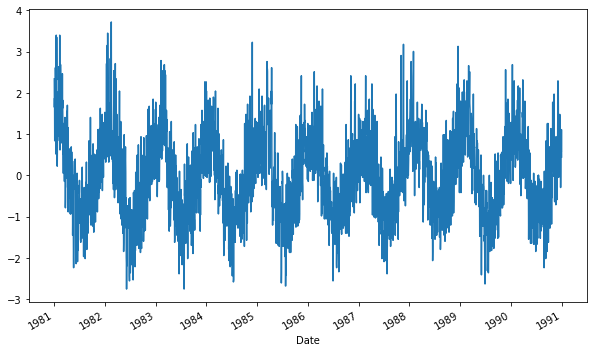

In [205]:
plt.figure(figsize=(10, 6))
series_row.plot()
plt.ylabel('Minimum Daily Temperatures[$^\circ C$]')
plt.xlabel('Year')
plt.show()

In [206]:
showOutcomes(outcomes)

In [207]:
showOutcomes(outcomes, extended=True)

### Model 2 - non-stationary time series (undisturbed)

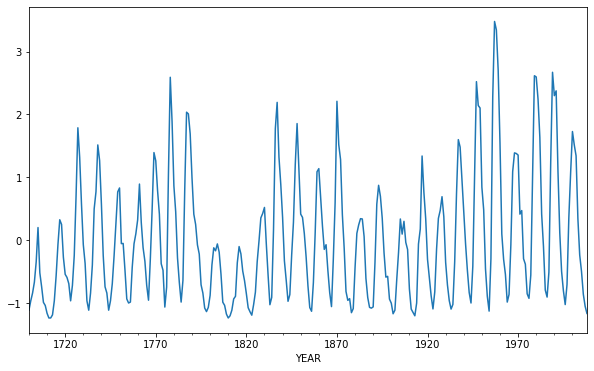

In [208]:
plt.figure(figsize=(10, 6))
plt.ylabel('Annual Average Number of Sunspots ')
plt.xlabel('Year')
series_raw_2.plot()
plt.show()

In [209]:
showOutcomes(outcomes_2)

In [210]:
showOutcomes(outcomes_2, extended=True)

### Model 3 - one stationary time series (model 1) disturbed by a modulated other series (model 2)

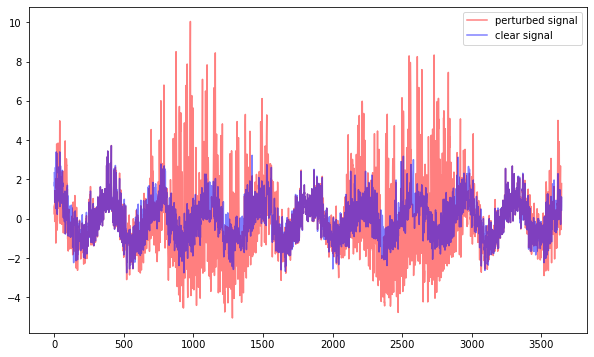

In [211]:
plt.figure(figsize=(10, 6))
series_3 = series+perturbation_3
plt.plot(series_3, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series, 'b', label='clear signal', alpha=0.5)
plt.legend()

In [212]:
showOutcomes(outcomes_3)

In [213]:
showOutcomes(outcomes_3, extended=True)

### Model 4 - stationary time series (model 1) disturbed by a periodically modulated random walk

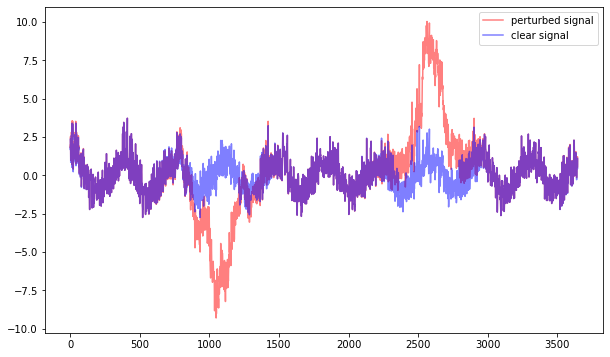

In [214]:
plt.figure(figsize=(10, 6))
series_4 = series+perturbation_4
plt.plot(series_4, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series, 'b', label='clear signal', alpha=0.5)
plt.legend()

In [215]:
showOutcomes(outcomes_4)

In [216]:
showOutcomes(outcomes_4, extended=True)

### Model 5 - stationary time series (model 1) disturbed by Gaussian-shape enhancement.

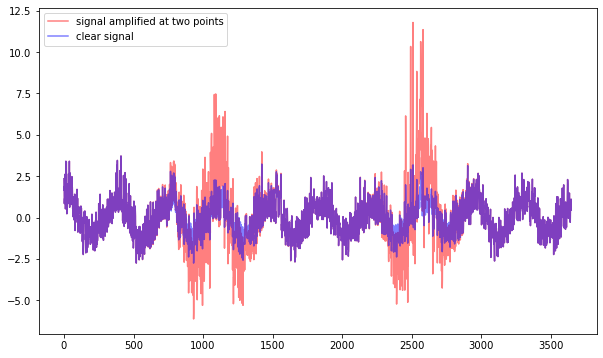

In [217]:
plt.figure(figsize=(10, 6))
series_5 = series+perturbation_5
plt.plot(series_5, 'r', label='signal amplified at two points', alpha=0.5)
plt.plot(series, 'b', label='clear signal', alpha=0.5)
plt.legend()

In [218]:
showOutcomes(outcomes_5)

In [219]:
showOutcomes(outcomes_5, extended=True)

### Model 6 - non-stationary time series (model 2) disturbed by a periodically modulated random walk 

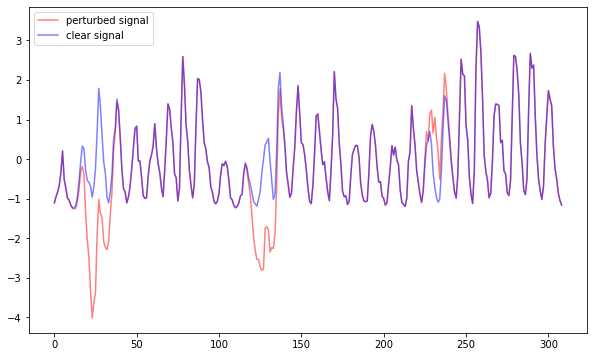

In [220]:
plt.figure(figsize=(10, 6))
series_6 = series_2 + perturbation_6
plt.plot(series_6, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series_2, 'b', label='clear signal', alpha=0.5)

plt.legend()

In [221]:
showOutcomes(outcomes_6)

In [222]:
showOutcomes(outcomes_6, extended=True)

### Model 7 - non-stationary time series (model 2) disturbed by a Gaussian-shape modulated random walk

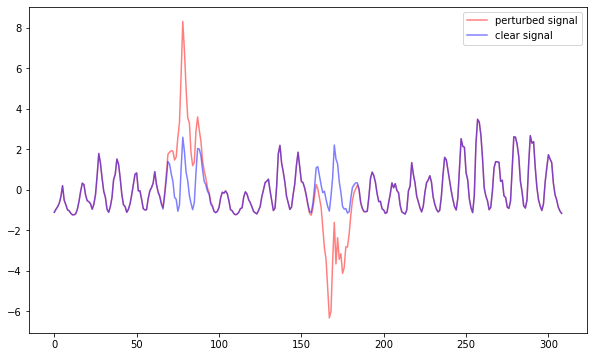

In [223]:
plt.figure(figsize=(10, 6))
series_7 = series_2 + perturbation_7
plt.plot(series_7, 'r', label='perturbed signal', alpha=0.5)
plt.plot(series_2, 'b', label='clear signal', alpha=0.5)

plt.legend()

In [224]:
showOutcomes(outcomes_7)

In [225]:
showOutcomes(outcomes_7, extended=True)

## Conclusions 

The comparison of the results displayed by functions `showOutcomes` for the time series under study shows that the proposed extensions of the standard cross-validation procedures and of finding the optimal set of hyperparameters on the basis of weighted means from the prediction error metrics improve the results obtained using shallow machine learning methods for forecasting time series. The improvement was more pronounced for the time series undergoing short-term disturbance. In the case of forecasting disturbed time series, cross-validation implemented in `RollingTimeSeriesSplit` class worked best. The results obtained for the simple validation, implemented in `PrimitiveFold` class were a surprise, because it turned out that for undisturbed time series (model 1 i 2) simple validation worked best. Almost always, using the weighted means to find the best set of hyperparameter gave better results. When comparing the obtained results, it should be noted that although the proposed extensions of the sklearn library gave better results, the improvement was slight.